# Explainability Task

## Approach

1. A Llava Llama 8B model was trained and used for the detection of concepts and the captions of each image. Then, for this explainability task, Llama 3.1 was used to merge the concepts and the captions to generate a more complete explanation to relate with the image.

2. The list of concepts was translated into natural language. From those files, the rows corresponding to the test set of images for the task were extracted and renamed as caption-csv and ref_mini_concepts_natural_.csv.

3. The list of concepts in natural language and the subtitles of the test set were provided as part of a prompt to Open AI APIs to obtain approximate location coordinates, which were saved in the file sam_coord.csv.

4. Natural Language Processing integration with NER extraction and others techniques were used to have good candidate labels for SAM.

5. The file with the coordinates was sent to Segment Anything Model (SAM) to create the bounding boxes. Precision was added using heat maps. Specifically, the following was done:

    - Generates multiple segmentation candidates and automatically selects the best one per anatomical structure
    - Provides quantified quality metrics (0-1 scale) for each segmentation based on anatomical likelihood
    - Uses probability maps to identify most likely anatomical locations from approximate coordinates
    - Fine-tuned parameters specifically for medical imaging precision

6. Enhancement was done with YOLO (You Only Look Once) for automatic detection of missed anatomical structures.

7. Arrow detection and following, and keypoint detection algorithms (SIFT, FAST, LoG) were used.

8. Computer vision preprocessing (Canny edge detection and adaptive thresholding) and geometric & spatial analysis were also used.

9. Concepts, captions and explanations are printed below the bounding box images for clarity. Also some statistical analysis & confidence scoring.


### 1. Getting aproximate location coordinates

The objective is to get approximate coordinates to SAM. This script:

- Correctly extract and group compound medical terms (e.g., “small intestine” not “Intestines;Small”).

- Omit generic modality terms (X-ray, MRI, PET, etc.).

- Identify bounding boxes for medical structures/findings based on visual and textual cues.

- Detect arrow tips and link them to the relevant terms/regions.

- Leverage GPT-4V for visual reasoning and GPT-4.1 for text refinement, merging, and error correction.

- Produce CSV/JSON output with ImageID, Label, x, y, width, height.

- Collaborate between models for better accuracy and compound term preservation.

In [ ]:
# ========== LIBRARIES ==========

import openai
import pandas as pd
import json
import os
import time
import base64
import re
from dotenv import load_dotenv
import csv

In [22]:
# ========== CONFIGURATION ==========

load_dotenv() # Load environment variables from the .env file into the environment
openai.api_key = os.getenv("OPENAI_API_KEY")

IMAGE_FOLDER = "./data/test_set_explain/"
CONCEPTS_FILE = "./data/ref_mini_concepts_natural_.csv"
CAPTIONS_FILE = "./data/3_submission_explainability.csv"
CSV_OUTPUT = "./results_explain-3/sam_coord.csv"
JSON_OUTPUT = "./results_explain-3/sam_coord.json"
VISION_MODEL = "gpt-4o"
LANG_MODEL = "gpt-4.1"
MAX_VISION_TOKENS = 800
MAX_LANG_TOKENS = 900

In [ ]:
# ========== UTILITIES ==========

def get_image_path(image_id):
    for ext in ['.jpeg', '.jpg', '.png']:
        img_path = os.path.join(IMAGE_FOLDER, f"{image_id}{ext}")
        if os.path.exists(img_path):
            return img_path
    return None

def is_modality(term):
    modalities = [
        "plain x-ray", "x-ray", "ct", "mri", "ultrasound", "pet", "ct-scan", "computed tomography",
        "magnetic resonance imaging", "positron-emission tomography", "ultrasonography", "angiogram"
    ]
    return term.strip().lower() in [m.lower() for m in modalities]

def clean_term(term):
    return re.sub(r"^(Structure of |structure of )", "", term).strip()

def group_compound_terms(term_list):
    known_compounds = [
        "small intestine", "large intestine", "left axillary region", "right lower lobe",
        "lower lobe", "upper lobe", "anterior chamber", "posterior chamber", "right kidney",
        "left kidney", "left atrium", "right atrium", "left ventricle", "right ventricle",
        "biliary tree", "pulmonary artery", "coronary artery", "saphenous vein"
    ]
    clean_terms = [clean_term(t).lower() for t in term_list if t and not is_modality(t)]
    final_terms = set()
    used = set()
    for comp in known_compounds:
        parts = comp.split()
        if all(any(part == t or part in t for t in clean_terms) for part in parts):
            final_terms.add(comp)
            used.update(parts)
    for t in clean_terms:
        if not any(t == u or t in u for u in used):
            final_terms.add(t)
    return [t if " " not in t else " ".join([w.capitalize() for w in t.split()]) for t in final_terms]

In [36]:
# ========== PROMPTS ==========

def gpt4v_prompt(terms, caption):
    return f"""
You are an expert radiologist. Analyze the provided medical image together with these terms: {terms}, and caption: "{caption}".

Important: In radiology, "left" and "right" always refer to the patient's left and right (the patient's perspective), which is the opposite of the observer's (radiologist's) view. Always reason and answer using the patient's perspective.

Your tasks:
1. Compound terms like "small intestine", "left axillary region", etc., must be treated as unique, unsplit entities. Never split such terms.
2. Omit general modality terms such as X-ray, MRI, PET, CT, etc.; focus on anatomical structures, findings, or pathologies.
3. For each medical term, estimate the most probable bounding box (x, y, width, height) in the image. Use both the image and the caption to reason location.
4. If there are any arrows, lines, or visual pointers, detect their tip coordinates (x, y) and, if possible, assign the pointed term or region.
5. For ambiguous terms, return your best-guess bounding box or arrow tip, and flag as "uncertain" in the label.
6. Return your results ONLY as a JSON list:
    [
        {{"label": "<compound_term>", "box": {{"x": ..., "y": ..., "width": ..., "height": ...}}}},
        {{"label": "<compound_term>", "arrow_tip": {{"x": ..., "y": ...}}}},
        ...
    ]
Do not include modality labels. Never split compound terms. Do not return any explanation, only the JSON array.
"""

def gpt41_prompt(detections_json, terms, caption, image_id):
    return f"""
You are an expert radiologist data curator. Here are the vision detections from a medical image: {json.dumps(detections_json)}.
- Original caption: "{caption}"
- Medical terms to consider: {terms}
- Image ID: {image_id}

Important: In radiology, "left" and "right" always refer to the patient's left and right, not the observer's. Always use the patient's perspective.

Your tasks:
1. For each term in the medical terms list, make sure compound terms are preserved as single entities (e.g., "small intestine" not split).
2. Omit general imaging modality terms (X-ray, MRI, PET, CT, ultrasound, etc.) and only keep anatomical structures, pathologies, or findings.
3. Validate the bounding boxes and arrow tips. If a term is missing a bounding box but has an arrow tip, estimate a default box (40x40 pixels) centered at the arrow tip.
4. Output the full data in:
    - CSV with columns: ImageID, Label, x, y, width, height
    - JSON list: [{{"ImageID":..., "Label":..., "x":..., "y":..., "width":..., "height":...}}, ...]
Only include rows for valid medical terms (no modalities, no split terms).
If any info must be inferred, do so based on your expertise. Output both the CSV and JSON (CSV first, then JSON).
"""

def extract_json_anywhere(text):
    # Busca el primer bloque válido de JSON array (list)
    matches = re.findall(r"(\[.*?\])", text, re.DOTALL)
    for m in matches:
        try:
            parsed = json.loads(m)
            return m
        except Exception:
            continue
    # Busca dentro de bloques markdown
    match = re.search(r"```json(.*?)```", text, re.DOTALL)
    if match:
        inner = match.group(1).strip()
        try:
            parsed = json.loads(inner)
            return inner
        except Exception:
            pass
    return ""

def call_gpt4v_vision(image_path, terms, caption, retries=2):
    prompt = gpt4v_prompt(terms, caption)
    with open(image_path, "rb") as imgf:
        img_b64 = base64.b64encode(imgf.read()).decode()
    for attempt in range(retries + 1):
        try:
            print("Prompt:\n", prompt[:400], "...")
            print("Image exists?", os.path.exists(image_path))
            response = openai.chat.completions.create(
                model=VISION_MODEL,
                messages=[
                    {
                        "role": "user",
                        "content": [
                            {"type": "text", "text": prompt},
                            {
                                "type": "image_url",
                                "image_url": {
                                    "url": f"data:image/jpeg;base64,{img_b64}"
                                }
                            }
                        ]
                    }
                ],
                max_tokens=MAX_VISION_TOKENS
            )
            result = response.choices[0].message.content.strip()
            if not result:
                print("[Vision model] Empty response from OpenAI. Check quota, input size, or prompt.")
                return []
            clean_json = extract_json_anywhere(result)
            try:
                return json.loads(clean_json)
            except Exception as je:
                print("Raw result (not JSON):", result)
                raise je
        except Exception as e:
            print(f"[Vision model] Error (attempt {attempt+1}): {e}")
            time.sleep(3 + attempt*3)
    print("[Vision model] Failed after retries.")
    return []

def call_gpt4_1_refiner(detections_json, terms, caption, image_id, retries=2):
    prompt = gpt41_prompt(detections_json, terms, caption, image_id)
    for attempt in range(retries + 1):
        try:
            completion = openai.chat.completions.create(
                model=LANG_MODEL,
                messages=[{"role": "user", "content": prompt}],
                max_tokens=MAX_LANG_TOKENS
            )
            reply = completion.choices[0].message.content.strip()
            print("\n=== GPT-4.1 RAW REPLY ===\n", reply, "\n=== END REPLY ===\n")
            # Busca CSV (puedes dejar igual)
            csv_part, json_part = "", ""
            csv_match = re.search(r"ImageID,.*?(\n(?:[^\[]|\[)*?)\n?\[", reply, re.DOTALL)
            if csv_match:
                csv_part = csv_match.group(0).split("\n[")[0].strip()
            else:
                parts = re.split(r"\n\s*\n", reply)
                if len(parts) >= 2 and parts[0].startswith("ImageID"):
                    csv_part = parts[0].strip()
                else:
                    idx = reply.find('[')
                    if idx != -1:
                        csv_part = reply[:idx].strip()
            # Busca el JSON con extractor avanzado
            json_part = extract_json_anywhere(reply)
            if not json_part:
                print("[Language model] Could not parse JSON part.")
                json_part = "[]"
            return csv_part, json_part
        except Exception as e:
            print(f"[Language model] Error (attempt {attempt+1}): {e}")
            time.sleep(3 + attempt*3)
    print("[Language model] Failed after retries.")
    return "", "[]"

In [37]:
# ========== MAIN PIPELINE ==========

def run_pipeline():
    if not os.path.exists(CONCEPTS_FILE) or not os.path.exists(CAPTIONS_FILE):
        print(f"ERROR: Concepts file or captions file not found.")
        return
    concepts_df = pd.read_csv(CONCEPTS_FILE)
    captions_df = pd.read_csv(CAPTIONS_FILE)
    cap_map = {str(row["ID"]): str(row["Caption"]) for _, row in captions_df.iterrows()}

    all_csv_rows = []
    all_json_objs = []

    for idx, row in concepts_df.iterrows():
        image_id = str(row["ID"])
        cuis = [c.strip() for c in str(row["CUIs"]).split(';') if c.strip()]
        caption = cap_map.get(image_id, "")
        image_path = get_image_path(image_id)
        if image_path is None:
            print(f"[{image_id}] Image not found, skipping.")
            continue
        terms = group_compound_terms(cuis)
        print(f"\n=== Processing {image_id} ===")
        print(f"Terms: {terms}")
        vision_results = call_gpt4v_vision(image_path, terms, caption)
        if not vision_results:
            print(f"[{image_id}] No vision results, skipping.")
            continue
        csv_out, json_out = call_gpt4_1_refiner(vision_results, terms, caption, image_id)
        if csv_out:
            if not all_csv_rows and "ImageID" in csv_out:
                header, *rest = csv_out.splitlines()
                all_csv_rows.append(header)
                all_csv_rows.extend(rest)
            else:
                lines = [line for line in csv_out.splitlines() if not line.lower().startswith("imageid")]
                all_csv_rows.extend(lines)
        if json_out and json_out != "[]":
            try:
                data = json.loads(json_out)
                if isinstance(data, list):
                    all_json_objs.extend(data)
            except Exception as e:
                print(f"[{image_id}] Error parsing JSON output: {e}")
        time.sleep(2.5)

    print(f"\nWriting outputs to {CSV_OUTPUT} and {JSON_OUTPUT} ...")
    with open(CSV_OUTPUT, "w") as f:
        for row in all_csv_rows:
            f.write(row + "\n")
    with open(JSON_OUTPUT, "w") as f:
        json.dump(all_json_objs, f, indent=2)
    print("Done.")


In [60]:
# Run the pipeline
run_pipeline()


=== Processing ImageCLEFmedical_Caption_2025_test_118 ===
Terms: ['anterior-posterior', 'Bone Structure Of Ilium', 'pelvis', 'abdomen', 'Bone Structure Of Pubis']
Prompt:
 
You are an expert radiologist. Analyze the provided medical image together with these terms: ['anterior-posterior', 'Bone Structure Of Ilium', 'pelvis', 'abdomen', 'Bone Structure Of Pubis'], and caption: "Plain radiograph of the abdomen, taken in the anterior-posterior projection, shows multiple air-fluid levels within the bowel loops, extending into the pelvis. The bone structure of the ilium a ...
Image exists? True

=== GPT-4.1 RAW REPLY ===
 **CSV Output:**
```
ImageID,Label,x,y,width,height
ImageCLEFmedical_Caption_2025_test_118,Bone Structure Of Ilium,200,450,150,100
ImageCLEFmedical_Caption_2025_test_118,pelvis,220,500,160,120
ImageCLEFmedical_Caption_2025_test_118,abdomen,150,100,300,350
ImageCLEFmedical_Caption_2025_test_118,Bone Structure Of Pubis,230,580,140,60
ImageCLEFmedical_Caption_2025_test_118,air

In [61]:
# ========== RESULTS ==========

# Visualize the results
display(pd.read_csv(CSV_OUTPUT).head(5))

,ImageID,Label,x,y,width,height
0,ImageCLEFmedical_Caption_2025_test_118,Bone Structure Of Ilium,200.0,450.0,150.0,100.0
1,ImageCLEFmedical_Caption_2025_test_118,pelvis,220.0,500.0,160.0,120.0
2,ImageCLEFmedical_Caption_2025_test_118,abdomen,150.0,100.0,300.0,350.0
3,ImageCLEFmedical_Caption_2025_test_118,Bone Structure Of Pubis,230.0,580.0,140.0,60.0
4,ImageCLEFmedical_Caption_2025_test_118,air-fluid levels,230.0,180.0,40.0,40.0


## SAM Medical Image Analysis with Heatmap-based Confidence

This script adds heatmap generation and confidence scoring to select the best mask per label.


### 3. Using SAM for bounding boxes

In [76]:
# ========== LIBRARIES ==========

import pandas as pd
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.patches import Rectangle
from mpl_toolkits.mplot3d import Axes3D
import textwrap
import re
import urllib.request
import torch
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator, SamPredictor
from transformers import AutoTokenizer, AutoModelForTokenClassification, pipeline
from IPython.display import display, Image as IPImage
import warnings
from scipy import ndimage
from sklearn.cluster import DBSCAN
from skimage.measure import label as skimage_label, regionprops
from scipy.spatial.distance import euclidean
import json
warnings.filterwarnings('ignore')
import csv
from collections import defaultdict
import logging

In [77]:
# ========== CONFIGURATION ==========

SAM_COORD_PATH = './sam_coord.csv'
CAPTIONS_PATH = './3_submission_explainability.csv'
CONCEPTS_PATH = './ref_mini_concepts_natural_.csv'
CAPTION_FILE_PATH = './caption.csv'
IMAGES_DIR = './data/test_set_explain'
OUTPUT_DIR = './result_explain-3/sam'

# Create output directory
os.makedirs(OUTPUT_DIR, exist_ok=True)

# Color palette for consistency
COLORS = [
    '#FF0000',  # Red
    '#00FF00',  # Green  
    '#0000FF',  # Blue
    '#FFA500',  # Orange
    '#FF00FF',  # Magenta
    '#00FFFF',  # Cyan
    '#800080',  # Purple
    '#FFC0CB',  # Pink
    '#A52A2A',  # Brown
    '#FFFF00',  # Yellow
    '#808080',  # Gray
    '#000080'   # Navy Blue
]

print("Setting up Advanced Medical SAM with NER and Arrow Detection...")

Setting up Advanced Medical SAM with NER and Arrow Detection...


In [9]:
# ========== SAM SETUP ==========

# Setup SAM model
def setup_sam():
    """Setup SAM model with automatic download if needed."""
    # Download SAM model if not exists
    os.makedirs('sam_models', exist_ok=True)
    sam_checkpoint = "sam_models/sam_vit_h_4b8939.pth"
    
    if not os.path.exists(sam_checkpoint):
        print("Downloading SAM model (this may take a few minutes)...")
        urllib.request.urlretrieve(
            "https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth",
            sam_checkpoint
        )
        print("SAM model downloaded successfully!")
    
    # Load SAM model
    model_type = "vit_h"
    device = "cuda" if torch.cuda.is_available() else "cpu"
    print(f"Using device: {device}")
    
    sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
    sam.to(device=device)
    
    # Configure mask generator optimized for medical images
    mask_generator = SamAutomaticMaskGenerator(
        model=sam,
        points_per_side=32,
        pred_iou_thresh=0.85,
        stability_score_thresh=0.92,
        crop_n_layers=1,
        crop_n_points_downscale_factor=2,
        min_mask_region_area=200
    )
    
    predictor = SamPredictor(sam)
    print("SAM configured for medical images!")
    return mask_generator, predictor, device

# Initialize SAM
mask_generator, predictor, device = setup_sam()

Using device: cuda
SAM configured for medical images!


In [11]:
# Setup Medical NER Model
def setup_medical_ner():
    """Setup biomedical NER model for extracting medical terms."""
    try:
        print("Loading biomedical NER model...")
        tokenizer = AutoTokenizer.from_pretrained("d4data/biomedical-ner-all")
        model = AutoModelForTokenClassification.from_pretrained("d4data/biomedical-ner-all")
        ner_pipeline = pipeline("ner", 
                               model=model, 
                               tokenizer=tokenizer, 
                               aggregation_strategy="simple")
        print("Medical NER model loaded successfully!")
        return ner_pipeline
    except Exception as e:
        print(f"Could not load biomedical NER model: {e}")
        print("Installing transformers: pip install transformers")
        return None

# Initialize Medical NER
medical_ner = setup_medical_ner()

Loading biomedical NER model...
Medical NER model loaded successfully!


## NER Extraction

Medical NER Extraction and Comparison Script
Extracts medical terms from explanations, cleans them, and compares with existing annotations.

In [12]:
import pandas as pd
import re
import os
from collections import Counter
import warnings
warnings.filterwarnings('ignore')

In [ ]:
# File paths
EXPLANATIONS_PATH = './3_submission_explainability.csv'
SAM_COORD_PATH = './sam_coord.csv'
OUTPUT_PATH = './data/ner.csv'

def extract_location_hint(caption, term):
    """Extract location hints from caption context."""
    caption_lower = caption.lower()
    term_lower = term.lower()
    
    # Find the term position in caption
    term_pos = caption_lower.find(term_lower)
    if term_pos == -1:
        return None
    
    # Look for directional indicators around the term
    context_window = 50  # Characters before and after
    start = max(0, term_pos - context_window)
    end = min(len(caption), term_pos + len(term) + context_window)
    context = caption_lower[start:end]
    
    location_hints = {
        'left': ['left', 'sinister', 'l.'],
        'right': ['right', 'dexter', 'r.'],
        'upper': ['upper', 'superior', 'top', 'cranial'],
        'lower': ['lower', 'inferior', 'bottom', 'caudal'],
        'anterior': ['anterior', 'front', 'ventral'],
        'posterior': ['posterior', 'back', 'dorsal'],
        'medial': ['medial', 'central', 'middle'],
        'lateral': ['lateral', 'side', 'peripheral'],
        'arrow': ['arrow', 'pointer', 'indicated', 'shown', 'marked']
    }
    
    found_hints = {}
    for direction, keywords in location_hints.items():
        for keyword in keywords:
            if keyword in context:
                found_hints[direction] = True
                break
    
    return found_hints if found_hints else None

def extract_medical_terms_rule_based(caption):
    """Enhanced rule-based extraction of medical terms from captions."""
    medical_patterns = [
        # Pathological conditions with boundaries
        r'\b(?:mass|tumor|tumour|lesion|nodule|growth|neoplasm)\b',
        r'\b(?:hematoma|hemorrhage|bleeding|blood|clot)\b',
        r'\b(?:air-fluid|fluid|effusion|pneumothorax|pleural\s+effusion)\b',
        r'\b(?:hypermetabolic|metabolic|uptake|enhancement)\b',
        r'\b(?:fracture|break|dislocation|injury)\b',
        r'\b(?:stenosis|occlusion|blockage|obstruction)\b',
        r'\b(?:inflammation|infection|abscess|sepsis)\b',
        r'\b(?:calcification|calcified|calcium|mineralization)\b',
        
        # Anatomical references with descriptors
        r'\b(?:left|right)\s+(?:upper|lower|middle)?\s*(?:lobe|lung|breast|kidney|liver|ventricle)\b',
        r'\b(?:left|right)\s+(?:ventricle|atrium|carotid|cerebral|temporal|frontal|parietal|occipital)\b',
        r'\b(?:internal|external|common)\s+(?:carotid|iliac|mammary)\s+artery\b',
        r'\blymph\s+nodes?\b|\badenopathy\b',
        
        # Size and severity descriptors with following nouns
        r'\b(?:large|small|massive|extensive|diffuse|focal)\s+(?:mass|lesion|area|collection|density)\b',
        r'\b(?:severe|moderate|mild|acute|chronic)\s+(?:inflammation|infection|stenosis|obstruction)\b',
        r'\b(?:free|trapped|loculated)\s+fluid\b',
        
        # Specific medical conditions
        r'\b(?:pneumonia|atelectasis|consolidation|opacity|infiltrate)\b',
        r'\b(?:cardiomegaly|hepatomegaly|splenomegaly)\b',
        r'\b(?:thrombosis|embolism|infarct|ischemia)\b',
        r'\b(?:aneurysm|dissection|stenosis)\b',
        r'\b(?:cyst|polyp|diverticulum|hernia)\b',
        
        # Contrast and imaging terms
        r'\b(?:contrast|enhancement|hypodense|hyperdense|isodense)\b',
        r'\b(?:hypointense|hyperintense|signal|intensity)\b',
        
        # Anatomical structures
        r'\b(?:vertebra|vertebrae|disc|facet|joint|bone|rib|sternum)\b',
        r'\b(?:aorta|vena\s+cava|pulmonary|coronary)\b',
        r'\b(?:bladder|prostate|uterus|ovary|kidney|adrenal)\b'
    ]
    
    medical_terms = []
    caption_lower = caption.lower()
    
    for pattern in medical_patterns:
        matches = re.finditer(pattern, caption_lower, re.IGNORECASE)
        for match in matches:
            term = match.group().strip()
            if len(term) > 2:  # Filter out very short terms
                # Clean the term
                cleaned_term = clean_medical_term(term)
                if cleaned_term and is_valid_medical_term(cleaned_term):
                    medical_terms.append({
                        'term': cleaned_term,
                        'type': 'MEDICAL_RULE',
                        'confidence': 0.8,
                        'location_hint': extract_location_hint(caption, term),
                        'original_match': term,
                        'pattern_matched': pattern
                    })
    
    return medical_terms

def clean_medical_term(term):
    """Clean and standardize medical terms."""
    # Convert to title case
    cleaned = term.strip().title()
    
    # Handle specific medical abbreviations
    abbreviations = {
        'Ca': 'Calcium',
        'Hb': 'Hemoglobin',
        'O2': 'Oxygen',
        'Co2': 'Carbon Dioxide',
        'Iv': 'Intravenous',
        'Im': 'Intramuscular'
    }
    
    for abbr, full in abbreviations.items():
        if cleaned == abbr:
            return full
    
    # Remove redundant words
    remove_words = ['Structure Of', 'Bone Structure Of', 'Entire', 'Complete']
    for remove_word in remove_words:
        cleaned = cleaned.replace(remove_word + ' ', '').replace(remove_word, '')
    
    # Standardize compound terms
    standardizations = {
        'Air-Fluid': 'Air-Fluid Level',
        'Free Fluid': 'Free Fluid',
        'Lymph Node': 'Lymph Nodes',
        'Blood Clot': 'Thrombosis'
    }
    
    for old, new in standardizations.items():
        if old in cleaned:
            cleaned = cleaned.replace(old, new)
    
    return cleaned.strip()

def is_valid_medical_term(term):
    """Validate if a term is a proper medical term."""
    term_lower = term.lower()
    
    # Exclude common non-medical words
    exclude_words = {
        'the', 'and', 'or', 'of', 'in', 'on', 'at', 'to', 'for', 'with', 'by',
        'from', 'as', 'is', 'are', 'was', 'were', 'be', 'been', 'have', 'has',
        'had', 'do', 'does', 'did', 'will', 'would', 'could', 'should', 'may',
        'might', 'can', 'must', 'shall', 'this', 'that', 'these', 'those',
        'there', 'here', 'where', 'when', 'how', 'what', 'which', 'who', 'why',
        'very', 'more', 'most', 'some', 'all', 'any', 'each', 'every', 'both',
        'either', 'neither', 'one', 'two', 'three', 'first', 'second', 'third',
        'new', 'old', 'good', 'bad', 'big', 'small', 'long', 'short', 'high', 'low'
    }
    
    if term_lower in exclude_words:
        return False
    
    # Must be at least 3 characters
    if len(term) < 3:
        return False
    
    # Must contain at least one letter
    if not re.search(r'[a-zA-Z]', term):
        return False
    
    # Should not be purely numeric
    if term.replace('-', '').replace(' ', '').isdigit():
        return False
    
    # Should not contain too many special characters
    special_char_ratio = len(re.findall(r'[^a-zA-Z0-9\s\-]', term)) / len(term)
    if special_char_ratio > 0.3:
        return False
    
    return True

def normalize_term_for_comparison(term):
    """Normalize term for comparison purposes."""
    # Convert to lowercase
    normalized = term.lower()
    
    # Remove common prefixes/suffixes for comparison
    prefixes_to_remove = ['left ', 'right ', 'bilateral ', 'upper ', 'lower ', 'middle ']
    suffixes_to_remove = [' left', ' right', ' bilateral', ' upper', ' lower', ' middle']
    
    for prefix in prefixes_to_remove:
        if normalized.startswith(prefix):
            normalized = normalized[len(prefix):]
    
    for suffix in suffixes_to_remove:
        if normalized.endswith(suffix):
            normalized = normalized[:-len(suffix)]
    
    # Remove articles and common words
    words_to_remove = ['the ', ' the', 'of ', ' of', 'structure ', ' structure']
    for word in words_to_remove:
        normalized = normalized.replace(word, ' ')
    
    # Clean up extra spaces
    normalized = ' '.join(normalized.split())
    
    return normalized.strip()

def compare_with_existing_annotations(ner_terms, sam_labels):
    """Compare NER terms with existing SAM annotations."""
    # Normalize existing SAM labels for comparison
    sam_normalized = set()
    for label in sam_labels:
        normalized = normalize_term_for_comparison(label)
        if normalized:
            sam_normalized.add(normalized)
    
    # Find new terms not covered by existing annotations
    new_terms = []
    covered_terms = []
    
    for term_data in ner_terms:
        term = term_data['term']
        normalized_term = normalize_term_for_comparison(term)
        
        is_covered = False
        
        # Check exact match
        if normalized_term in sam_normalized:
            is_covered = True
            covered_terms.append({**term_data, 'coverage_type': 'exact_match'})
        else:
            # Check partial matches
            for sam_term in sam_normalized:
                # Check if terms share significant words
                ner_words = set(normalized_term.split())
                sam_words = set(sam_term.split())
                
                # If more than 50% of words overlap, consider it covered
                if len(ner_words.intersection(sam_words)) / max(len(ner_words), 1) > 0.5:
                    is_covered = True
                    covered_terms.append({**term_data, 'coverage_type': 'partial_match', 'matched_with': sam_term})
                    break
        
        if not is_covered:
            new_terms.append({**term_data, 'status': 'new_term'})
    
    return new_terms, covered_terms

def process_ner_extraction():
    """Main function to process NER extraction and comparison."""
    print("Starting Medical NER Extraction and Comparison")
    print("=" * 60)
    
    # Load data files
    print("Loading data files...")
    
    if not os.path.exists(EXPLANATIONS_PATH):
        print(f"Explanations file not found: {EXPLANATIONS_PATH}")
        return
    
    if not os.path.exists(SAM_COORD_PATH):
        print(f"SAM coordinates file not found: {SAM_COORD_PATH}")
        return
    
    explanations_df = pd.read_csv(EXPLANATIONS_PATH)
    sam_df = pd.read_csv(SAM_COORD_PATH)
    
    print(f"Loaded {len(explanations_df)} explanations and {len(sam_df)} SAM annotations")
    
    # Extract medical terms from all captions
    print("\nExtracting medical terms from captions...")
    all_ner_terms = []
    
    for idx, row in explanations_df.iterrows():
        image_id = row.get('ID', row.get('id', idx))
        caption = row.get('Caption', row.get('caption', ''))
        
        if pd.notna(caption) and caption.strip():
            ner_terms = extract_medical_terms_rule_based(str(caption))
            
            for term_data in ner_terms:
                term_data['image_id'] = image_id
                term_data['source_caption'] = caption[:100] + '...' if len(caption) > 100 else caption
                all_ner_terms.append(term_data)
    
    print(f"Extracted {len(all_ner_terms)} raw medical terms")
    
    # Remove duplicates and count frequencies
    print("\nCleaning and deduplicating terms...")
    term_counter = Counter()
    unique_terms = {}
    
    for term_data in all_ner_terms:
        term = term_data['term']
        normalized = normalize_term_for_comparison(term)
        
        if normalized not in unique_terms:
            unique_terms[normalized] = term_data
        
        term_counter[normalized] += 1
    
    # Add frequency information
    for normalized_term, term_data in unique_terms.items():
        term_data['frequency'] = term_counter[normalized_term]
    
    print(f"Found {len(unique_terms)} unique medical terms")
    
    # Get existing SAM labels
    sam_labels = sam_df['Label'].dropna().unique().tolist()
    print(f"Comparing with {len(sam_labels)} existing SAM labels")
    
    # Compare with existing annotations
    new_terms, covered_terms = compare_with_existing_annotations(
        list(unique_terms.values()), sam_labels
    )
    
    print(f"\nComparison Results:")
    print(f"New terms not in SAM: {len(new_terms)}")
    print(f"Terms covered by SAM: {len(covered_terms)}")
    
    # Sort new terms by frequency and confidence
    new_terms.sort(key=lambda x: (x['frequency'], x['confidence']), reverse=True)
    
    # Prepare output DataFrame
    output_records = []
    for i, term_data in enumerate(new_terms):
        output_records.append({
            'rank': i + 1,
            'term': term_data['term'],
            'frequency': term_data['frequency'],
            'confidence': term_data['confidence'],
            'type': term_data['type'],
            'location_hints': str(term_data.get('location_hint', {})),
            'sample_image_id': term_data['image_id'],
            'sample_caption': term_data['source_caption'],
            'status': term_data['status']
        })
    
    # Create output directory if needed
    os.makedirs(os.path.dirname(OUTPUT_PATH), exist_ok=True)
    
    # Save to CSV
    output_df = pd.DataFrame(output_records)
    output_df.to_csv(OUTPUT_PATH, index=False)
    
    print(f"\nResults saved to: {OUTPUT_PATH}")
    
    # Display top 15 new terms
    print(f"\nTOP 15 NEW MEDICAL TERMS:")
    print("=" * 80)
    print(f"{'Rank':<4} {'Term':<25} {'Freq':<6} {'Conf':<6} {'Location Hints':<20} {'Sample ID':<10}")
    print("-" * 80)
    
    for i, record in enumerate(output_records[:15]):
        location_display = record['location_hints'][:18] + '..' if len(record['location_hints']) > 20 else record['location_hints']
        print(f"{record['rank']:<4} {record['term']:<25} {record['frequency']:<6} {record['confidence']:<6.2f} {location_display:<20} {record['sample_image_id']:<10}")
    
    print("-" * 80)
    print(f"Total new terms found: {len(new_terms)}")
    print(f"Coverage rate: {len(covered_terms)/(len(covered_terms)+len(new_terms))*100:.1f}%")
    
    return output_df

if __name__ == "__main__":
    result_df = process_ner_extraction()
    print("\nNER extraction and comparison completed!")

Starting Medical NER Extraction and Comparison
Loading data files...
Loaded 16 explanations and 110 SAM annotations

Extracting medical terms from captions...
Extracted 36 raw medical terms

Cleaning and deduplicating terms...
Found 18 unique medical terms
Comparing with 40 existing SAM labels

Comparison Results:
New terms not in SAM: 12
Terms covered by SAM: 6

Results saved to: ./data/ner.csv

TOP 15 NEW MEDICAL TERMS:
Rank Term                      Freq   Conf   Location Hints       Sample ID 
--------------------------------------------------------------------------------
1    Lymph Nodess              4      0.80   {'left': True, 'ar.. ImageCLEFmedical_Caption_2025_test_15167
2    Right Breast              3      0.80   {'right': True, 'a.. ImageCLEFmedical_Caption_2025_test_4346
3    Air-Fluid Level           2      0.80   {'anterior': True,.. ImageCLEFmedical_Caption_2025_test_118
4    Stenosis                  2      0.80   {'left': True, 'ar.. ImageCLEFmedical_Caption_2025_te

In [26]:
"""
NER Pipeline Adapter
Uses existing pipeline output format and preserves duplicates (multiple findings per image)
"""

import pandas as pd
import json
import os
import time
from datetime import datetime

# Configuration
IMAGE_FOLDER = "./data/test_set_explain/"
NER_FILE = './data/ner.csv'
CAPTIONS_FILE = './3_submission_explainability.csv'
ORIGINAL_SAM_COORD = './sam_coord.csv'
NER_COORD_OUTPUT = './ner_coord.csv'
MERGED_SAM_COORD = './sam_coord.csv'  # Overwrites original with merged data
BACKUP_SAM_COORD = './sam_coord_backup.csv'  # Backup of original

def backup_original_sam_coord():
    """Create backup of original sam_coord.csv before merging."""
    if os.path.exists(ORIGINAL_SAM_COORD):
        print(f"Creating backup: {BACKUP_SAM_COORD}")
        import shutil
        shutil.copy2(ORIGINAL_SAM_COORD, BACKUP_SAM_COORD)
        return True
    else:
        print(f"Original sam_coord.csv not found at: {ORIGINAL_SAM_COORD}")
        return False

def prepare_ner_data_for_pipeline():
    """Prepare NER data in the same format as the original concepts pipeline expects."""
    print("Loading NER terms and captions...")
    
    # Load files
    ner_df = pd.read_csv(NER_FILE)
    captions_df = pd.read_csv(CAPTIONS_FILE)
    
    # Create caption mapping
    cap_map = {str(row["ID"]): str(row["Caption"]) for _, row in captions_df.iterrows()}
    
    # Group NER terms by image_id
    image_groups = ner_df.groupby('sample_image_id')
    
    # Create a concepts-like DataFrame
    concepts_like_data = []
    
    for image_id, group in image_groups:
        # Get all terms for this image (no filtering - all terms)
        terms_list = group['term'].tolist()
        
        # Join terms with semicolon (like CUIs in original format)
        terms_string = '; '.join(terms_list)
        
        concepts_like_data.append({
            'ID': image_id,
            'CUIs': terms_string
        })
    
    concepts_like_df = pd.DataFrame(concepts_like_data)
    
    print(f"Loaded {len(ner_df)} NER terms")
    print(f"Processing {len(concepts_like_df)} images with NER terms")
    print(f"Available captions: {len(captions_df)}")
    
    return concepts_like_df, cap_map

def merge_with_original_sam_coord(ner_csv_rows):
    """
    Merge new NER coordinates with existing sam_coord.csv.
    Preserves duplicates since multiple findings per image are valid.
    """
    print("\nMerging with existing sam_coord.csv...")
    
    # Prepare NER data for merging
    ner_data_lines = []
    if ner_csv_rows:
        # Skip header if present, keep all data rows
        for row in ner_csv_rows:
            if row and not row.lower().startswith('imageid'):
                ner_data_lines.append(row)
    
    if not os.path.exists(ORIGINAL_SAM_COORD):
        print(f"Original sam_coord.csv not found. Creating new file with NER data only.")
        # Create new file with header + NER data
        with open(MERGED_SAM_COORD, 'w') as f:
            f.write("ImageID,Label,x,y,width,height\n")
            for line in ner_data_lines:
                f.write(line + "\n")
        merged_count = len(ner_data_lines)
    else:
        # Read original file
        with open(ORIGINAL_SAM_COORD, 'r') as f:
            original_lines = f.readlines()
        
        original_count = len(original_lines) - 1  # Subtract header
        print(f"Original sam_coord.csv: {original_count} records")
        
        # Write merged file
        with open(MERGED_SAM_COORD, 'w') as f:
            # Write original content
            for line in original_lines:
                f.write(line)
            
            # Append NER data (no duplicates check - preserving all findings)
            for line in ner_data_lines:
                f.write(line + "\n")
        
        merged_count = original_count + len(ner_data_lines)
    
    print(f"Merged file: {merged_count} total records")
    print(f"Added {len(ner_data_lines)} new NER records")
    
    return merged_count

def run_ner_pipeline():
    """
    Run NER pipeline using existing functions and preserve original output format.
    """
    print("Starting NER Terms Pipeline (Preserving Original Format)")
    print("=" * 60)
    
    # Check files exist
    if not os.path.exists(NER_FILE):
        print(f"ERROR: NER file not found: {NER_FILE}")
        return None, None
    
    if not os.path.exists(CAPTIONS_FILE):
        print(f"ERROR: Captions file not found: {CAPTIONS_FILE}")
        return None, None
    
    # Create backup of original sam_coord.csv
    backup_created = backup_original_sam_coord()
    
    # Prepare data in the format expected by existing pipeline
    concepts_df, cap_map = prepare_ner_data_for_pipeline()
    
    # Use the existing pipeline logic - EXACTLY as original
    all_csv_rows = []
    all_json_objs = []
    
    for idx, row in concepts_df.iterrows():
        image_id = str(row["ID"])
        terms_raw = [c.strip() for c in str(row["CUIs"]).split(';') if c.strip()]
        caption = cap_map.get(image_id, "")
        
        # Use existing function to get image path
        image_path = get_image_path(image_id)
        if image_path is None:
            print(f"[{image_id}] Image not found, skipping.")
            continue
        
        # Use existing function to group compound terms
        terms = group_compound_terms(terms_raw)
        
        print(f"\n=== Processing {image_id} ===")
        print(f"Original NER terms: {terms_raw}")
        print(f"Grouped terms: {terms}")
        
        if not terms:
            print(f"[{image_id}] No valid terms after grouping, skipping.")
            continue
        
        # Use existing vision function
        vision_results = call_gpt4v_vision(image_path, terms, caption)
        if not vision_results:
            print(f"[{image_id}] No vision results, skipping.")
            continue
        
        print(f"Vision model returned {len(vision_results)} detections")
        
        # Use existing refiner function
        csv_out, json_out = call_gpt4_1_refiner(vision_results, terms, caption, image_id)
        
        # Process CSV output - EXACTLY as original pipeline
        if csv_out:
            if not all_csv_rows and "ImageID" in csv_out:
                header, *rest = csv_out.splitlines()
                all_csv_rows.append(header)
                all_csv_rows.extend(rest)
            else:
                lines = [line for line in csv_out.splitlines() if not line.lower().startswith("imageid")]
                all_csv_rows.extend(lines)
        
        # Process JSON output - EXACTLY as original pipeline
        if json_out and json_out != "[]":
            try:
                data = json.loads(json_out)
                if isinstance(data, list):
                    all_json_objs.extend(data)
                    print(f"Added {len(data)} JSON objects")
            except Exception as e:
                print(f"[{image_id}] Error parsing JSON output: {e}")
        
        # Rate limiting
        time.sleep(2.5)
    
    # Save ner_coord.csv - EXACTLY as original pipeline saves
    print(f"\nSaving NER coordinates to: {NER_COORD_OUTPUT}")
    with open(NER_COORD_OUTPUT, "w") as f:
        for row in all_csv_rows:
            f.write(row + "\n")
    
    # Merge with original sam_coord.csv (preserving duplicates)
    merged_count = merge_with_original_sam_coord(all_csv_rows)
    
    print(f"\nNER Pipeline completed!")
    print(f"Final Summary:")
    print(f"NER coordinates: {len(all_csv_rows)} rows → {NER_COORD_OUTPUT}")
    print(f"Merged coordinates: {merged_count} total rows → {MERGED_SAM_COORD}")
    if backup_created:
        print(f"Original backup: {BACKUP_SAM_COORD}")
    print(f"JSON objects: {len(all_json_objs)}")
    print(f"Duplicates preserved (multiple findings per image allowed)")
    
    return all_csv_rows, merged_count

# ========== EXECUTION ==========

if __name__ == "__main__":
    """
    To use this with existing functions in your notebook:
    
    1. Make sure you have the existing functions available:
       - get_image_path()
       - group_compound_terms() 
       - call_gpt4v_vision()
       - call_gpt4_1_refiner()
    
    2. Then call:
       csv_rows, merged_count = run_ner_pipeline()
    """
    
    print("Required functions from your notebook:")
    print("   - get_image_path()")
    print("   - group_compound_terms()")
    print("   - call_gpt4v_vision()")
    print("   - call_gpt4_1_refiner()")
    print()
    print("Files that will be created/modified:")
    print(f"   {NER_COORD_OUTPUT} (new NER coordinates)")
    print(f"   {MERGED_SAM_COORD} (merged coordinates)")
    print(f"   {BACKUP_SAM_COORD} (backup of original)")
    print()
    print("Medical context: Duplicates preserved (multiple findings per image)")
    print()
    print("To run: csv_rows, merged_count = run_ner_pipeline()")

Required functions from your notebook:
   - get_image_path()
   - group_compound_terms()
   - call_gpt4v_vision()
   - call_gpt4_1_refiner()

Files that will be created/modified:
   ./ner_coord.csv (new NER coordinates)
   ./sam_coord.csv (merged coordinates)
   ./sam_coord_backup.csv (backup of original)

Medical context: Duplicates preserved (multiple findings per image)

To run: csv_rows, merged_count = run_ner_pipeline()


In [27]:
# Ejecutar el pipeline
csv_rows, merged_count = run_ner_pipeline()

Starting NER Terms Pipeline (Preserving Original Format)
Creating backup: ./sam_coord_backup.csv
Loading NER terms and captions...
Loaded 12 NER terms
Processing 9 images with NER terms
Available captions: 16

=== Processing ImageCLEFmedical_Caption_2025_test_118 ===
Original NER terms: ['Air-Fluid Level']
Grouped terms: ['Air-fluid Level']
Prompt:
 
You are an expert radiologist. Analyze the provided medical image together with these terms: ['Air-fluid Level'], and caption: "Plain radiograph of the abdomen, taken in the anterior-posterior projection, shows multiple air-fluid levels within the bowel loops, extending into the pelvis. The bone structure of the ilium and pubis is unremarkable.".

Important: In radiology, "left" and "right" alway ...
Image exists? True
Vision model returned 5 detections

=== GPT-4.1 RAW REPLY ===
 **CSV Output**

```
ImageID,Label,x,y,width,height
ImageCLEFmedical_Caption_2025_test_118,Air-fluid Level,160,280,40,40
ImageCLEFmedical_Caption_2025_test_118,Ai

### NLP Techniques to detect missing terms

In [ ]:
import pandas as pd
import re
import csv
from collections import defaultdict
import logging

In [ ]:
# Configure logging
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

def extract_medical_terms_enhanced(text):
    """
    Enhanced rule-based extraction of medical terms from captions.
    Ensures measurements are always extracted with their associated nouns.
    """
    if not text or pd.isna(text):
        return []
    
    text = text.lower()
    medical_terms = []
    
    # PRIORITY: Complete measurement phrases with descriptors and nouns
    measurement_phrase_patterns = [
        # Complete phrases: measurement + descriptor + noun
        r'\b\d+(?:\.\d+)?\s*(?:cm|mm)\s+(?:hypoechoic|hyperechoic|isoechoic|anechoic|mixed|echogenic|echolucent|solid|cystic|complex|heterogeneous|homogeneous|well-defined|ill-defined|poorly-defined)\s+(?:mass|lesion|nodule|cyst|tumor|tumour|growth|collection|area|region|structure)\b',
        
        # Reverse order: descriptor + noun + measurement
        r'\b(?:hypoechoic|hyperechoic|isoechoic|anechoic|mixed|echogenic|echolucent|solid|cystic|complex|heterogeneous|homogeneous|well-defined|ill-defined|poorly-defined)\s+(?:mass|lesion|nodule|cyst|tumor|tumour|growth|collection|area|region|structure)\s+(?:measuring|of|approximately)\s+\d+(?:\.\d+)?\s*(?:cm|mm)\b',
        
        # Noun + measuring + dimension
        r'\b(?:mass|lesion|nodule|cyst|tumor|tumour|growth|collection|area|region|structure)\s+measuring\s+\d+(?:\.\d+)?\s*(?:x\s*\d+(?:\.\d+)?)?\s*(?:x\s*\d+(?:\.\d+)?)?\s*(?:cm|mm)\b',
        
        # Multi-dimensional measurements with nouns
        r'\b\d+(?:\.\d+)?\s*(?:x\s*\d+(?:\.\d+)?)?\s*(?:x\s*\d+(?:\.\d+)?)?\s*(?:cm|mm)\s+(?:mass|lesion|nodule|tumor|tumour|cyst|growth|collection|area|region)\b',
        
        # Approximate measurements with nouns
        r'\b(?:approximately|about|roughly)\s+\d+(?:\.\d+)?\s*(?:cm|mm)\s+(?:mass|lesion|nodule|tumor|tumour|cyst|growth|collection|area|region)\b',
        r'\b(?:mass|lesion|nodule|tumor|tumour|cyst|growth|collection|area|region)\s+(?:approximately|about|roughly)\s+\d+(?:\.\d+)?\s*(?:cm|mm)\b',
        
        # Multi-word descriptive phrases with measurements
        r'\b\d+(?:\.\d+)?\s*(?:cm|mm)\s+(?:well|ill|poorly)\s*-?\s*(?:defined|circumscribed|demarcated)\s+(?:hypoechoic|hyperechoic|isoechoic|anechoic|mixed|echogenic)\s+(?:mass|lesion|nodule|cyst|structure)\b',
        
        # Complex anatomical measurements
        r'\b(?:approximately|about|roughly)\s+\d+(?:\.\d+)?\s*(?:cm|mm)\s+(?:hypoechoic|hyperechoic|isoechoic|anechoic|mixed|echogenic|solid|cystic|complex)\s+(?:mass|lesion|nodule|cyst|structure)\s+(?:in|within|at)\s+(?:the\s+)?(?:liver|kidney|thyroid|pancreas|gallbladder|uterus|ovary|breast|heart)\b'
    ]
    
    # Extract complete measurement phrases first (highest priority)
    for pattern in measurement_phrase_patterns:
        matches = re.findall(pattern, text, re.IGNORECASE)
        for match in matches:
            if isinstance(match, tuple):
                term = ' '.join(match).strip()
            else:
                term = match.strip()
            
            if len(term) > 5:  # Ensure meaningful phrases
                medical_terms.append(term.lower())
                logger.debug(f"Captured measurement phrase: {term}")
    
    # Enhanced medical patterns - MEASUREMENTS MUST BE LINKED TO NOUNS
    medical_patterns = [
        # Specific ultrasound characteristics WITH CONTEXT (no standalone characteristics)
        r'\b(?:well|ill|poorly)\s*-?\s*(?:defined|circumscribed|demarcated)\s+(?:mass|lesion|nodule|area|region|cyst|tumor|tumour|growth)\b',
        r'\b(?:mass|lesion|nodule|area|region|cyst|tumor|tumour|growth)\s+(?:with\s+)?(?:well|ill|poorly)\s*-?\s*(?:defined|circumscribed|demarcated)\s+(?:margins|borders|contours)\b',
        r'\b(?:heterogeneous|homogeneous)\s+(?:mass|lesion|nodule|area|region|cyst|tumor|tumour|growth|echogenicity|echotexture|appearance)\b',
        r'\b(?:mass|lesion|nodule|area|region|cyst|tumor|tumour|growth)\s+(?:with\s+)?(?:heterogeneous|homogeneous)\s+(?:echogenicity|echotexture|appearance)\b',
        r'\b(?:acoustic|posterior)\s+(?:shadowing|enhancement)\s+(?:from|behind|of)\s+(?:mass|lesion|nodule|cyst|structure)\b',
        
        # Echo characteristics ONLY with anatomical context
        r'\b(?:hypoechoic|hyperechoic|isoechoic|anechoic|mixed\s+echogenicity|echogenic|echolucent|echopoor|echorich)\s+(?:mass|lesion|nodule|area|region|cyst|tumor|tumour|growth|structure|parenchyma|wall|cortex|medulla)\b',
        r'\b(?:mass|lesion|nodule|area|region|cyst|tumor|tumour|growth|structure|parenchyma|wall|cortex|medulla)\s+(?:with\s+|showing\s+)?(?:hypoechoic|hyperechoic|isoechoic|anechoic|mixed|echogenic|echolucent|echopoor|echorich)\s+(?:echogenicity|appearance|characteristics)\b',
        
        # Pathologies and conditions (standalone medical terms - these are OK without measurements)
        r'\b(?:mass|tumor|tumour|lesion|nodule|growth|neoplasm|cyst|polyp|hematoma|hemorrhage|bleeding|abscess|collection|calcification|thrombus|thrombosis|embolism|stenosis|occlusion|obstruction|dilatation|dilation|distension|inflammation|infection|fibrosis|scarring)\b',
        
        # Anatomical structures with modifiers (these provide medical context)
        r'\b(?:gallbladder|cholecyst)\s+(?:wall|mucosa|fundus|neck|distension|thickening)\b',
        r'\b(?:liver|hepatic)\s+(?:parenchyma|segment|lobe|capsule|surface|contour)\b',
        r'\b(?:pancreatic|pancreas)\s+(?:head|body|tail|duct|parenchyma|contour)\b',
        r'\b(?:renal|kidney)\s+(?:cortex|medulla|pelvis|calix|capsule|parenchyma|collecting\s+system)\b',
        r'\b(?:thyroid|thyroidal)\s+(?:gland|nodule|lobe|isthmus|parenchyma|capsule)\b',
        r'\b(?:uterine|uterus)\s+(?:fundus|body|cervix|wall|cavity|endometrium|myometrium)\b',
        r'\b(?:ovarian|ovary|ovaries)\s+(?:follicle|cyst|mass|parenchyma|capsule|stroma)\b',
        r'\b(?:cardiac|heart)\s+(?:chamber|valve|wall|septum|muscle|pericardium)\b',
        r'\b(?:vascular|vessel|artery|vein)\s+(?:wall|lumen|flow|diameter|caliber)\b',
        
        # Organs and anatomical structures (contextual - these are meaningful standalone)
        r'\b(?:liver|hepatic|gallbladder|pancreas|pancreatic|spleen|splenic|kidney|renal|bladder|prostate|prostatic|thyroid|thyroidal|parathyroid|carotid|uterus|uterine|ovary|ovarian|cervix|cervical|heart|cardiac|aorta|aortic|mitral|tricuspid|breast|mammary|axillary|lymph\s+node|pleura|pleural|lung|pulmonary|bronchial)\b',
        
        # Texture/characteristics ONLY with anatomical context
        r'\b(?:solid|cystic|complex|simple)\s+(?:mass|lesion|nodule|cyst|structure|component|area|region)\b',
        r'\b(?:mass|lesion|nodule|cyst|structure|component|area|region)\s+(?:with\s+)?(?:solid|cystic|complex|simple)\s+(?:components|characteristics|appearance|features)\b',
        r'\b(?:regular|irregular)\s+(?:contour|margin|border|outline)\s+(?:of\s+)?(?:mass|lesion|nodule|cyst|organ|structure)\b',
        r'\b(?:mass|lesion|nodule|cyst|organ|structure)\s+(?:with\s+)?(?:regular|irregular)\s+(?:contour|margin|border|outline)\b',
        r'\b(?:increased|decreased|normal)\s+(?:echogenicity|vascularity|enhancement)\s+(?:of\s+)?(?:mass|lesion|organ|parenchyma|structure)\b',
        r'\b(?:doppler|color\s+flow|power\s+doppler)\s+(?:signal|assessment|evaluation)\s+(?:of\s+)?(?:mass|lesion|vessel|organ)\b',
        
        # Specific anatomical locations with direction/position
        r'\b(?:right|left|bilateral|unilateral)\s+(?:upper|lower|middle)\s+(?:pole|third|quadrant|lobe|segment)\b',
        r'\b(?:anterior|posterior|superior|inferior|medial|lateral)\s+(?:wall|aspect|portion|surface)\s+(?:of\s+)?(?:organ|structure|mass|lesion)\b',
        r'\b(?:subcapsular|intraparenchymal|extraperitoneal|retroperitoneal)\s+(?:mass|lesion|collection|hematoma|structure)\b'
    ]
    
    # Extract other medical patterns (contextual terms only)
    for pattern in medical_patterns:
        matches = re.findall(pattern, text, re.IGNORECASE)
        for match in matches:
            if isinstance(match, tuple):
                term = ' '.join(match).strip()
            else:
                term = match.strip()
            
            if len(term) > 2:  # Filter very short terms
                medical_terms.append(term.lower())
    
    # Remove duplicates and filter out standalone measurements without context
    unique_terms = []
    seen_terms = set()
    
    for term in medical_terms:
        term = term.strip()
        if len(term) < 3:
            continue
        
        # Skip standalone measurements without medical context
        if re.match(r'^\d+(?:\.\d+)?\s*(?:cm|mm)$', term):
            logger.debug(f"Skipped standalone measurement: {term}")
            continue
        
        # Skip standalone dimensions without context  
        if re.match(r'^\d+(?:\.\d+)?\s*x\s*\d+(?:\.\d+)?\s*(?:cm|mm)$', term):
            logger.debug(f"Skipped standalone dimensions: {term}")
            continue
            
        # Skip very generic terms without context
        generic_terms = {'measuring', 'approximately', 'about', 'cm', 'mm'}
        if term.lower() in generic_terms:
            logger.debug(f"Skipped generic term: {term}")
            continue
        
        if term not in seen_terms:
            unique_terms.append(term)
            seen_terms.add(term)
    
    # Sort by length (more specific terms first) and then by presence of measurements
    def sort_key(term):
        has_measurement = bool(re.search(r'\d+(?:\.\d+)?\s*(?:cm|mm)', term))
        return (has_measurement, len(term))
    
    unique_terms.sort(key=sort_key, reverse=True)
    
    return unique_terms

def load_existing_terms(sam_coord_file):
    """
    Load existing medical terms from sam_coord.csv
    """
    try:
        sam_df = pd.read_csv(sam_coord_file)
        existing_terms = set()
        
        # Assume there's a column with medical terms (adjust according to actual structure)
        # Commonly could be 'term', 'medical_term', 'object', etc.
        possible_columns = ['term', 'medical_term', 'object', 'label', 'annotation']
        
        term_column = None
        for col in possible_columns:
            if col in sam_df.columns:
                term_column = col
                break
        
        if term_column:
            existing_terms = set(sam_df[term_column].dropna().str.lower())
            logger.info(f"Loaded {len(existing_terms)} existing terms from column '{term_column}'")
        else:
            logger.warning(f"No term column found in {sam_coord_file}. Available columns: {list(sam_df.columns)}")
            # If we don't find the column, check all text columns
            for col in sam_df.columns:
                if sam_df[col].dtype == 'object':
                    existing_terms.update(sam_df[col].dropna().str.lower())
        
        return existing_terms
        
    except Exception as e:
        logger.error(f"Error loading {sam_coord_file}: {e}")
        return set()

def find_missing_medical_terms(explainability_file, sam_coord_file, output_file='missing_terms.csv'):
    """
    Main function to find missing medical terms
    """
    logger.info("Starting search for missing medical terms...")
    
    # Load existing terms
    existing_terms = load_existing_terms(sam_coord_file)
    logger.info(f"Existing terms loaded: {len(existing_terms)}")
    
    # Load explainability file
    try:
        explain_df = pd.read_csv(explainability_file)
        logger.info(f"Explainability file loaded: {len(explain_df)} rows")
    except Exception as e:
        logger.error(f"Error loading {explainability_file}: {e}")
        return
    
    # Identify relevant columns
    id_column = None
    text_column = None
    
    # Search for ID column
    for col in explain_df.columns:
        if 'id' in col.lower() or 'image' in col.lower():
            id_column = col
            break
    
    # Search for text/explanation column
    for col in explain_df.columns:
        if any(keyword in col.lower() for keyword in ['caption', 'explanation', 'text', 'description']):
            text_column = col
            break
    
    if not id_column or not text_column:
        logger.error(f"ID or text columns not found. Available columns: {list(explain_df.columns)}")
        return
    
    logger.info(f"Using ID column: '{id_column}', text column: '{text_column}'")
    
    # Process each row
    missing_terms_data = []
    processed_count = 0
    
    for idx, row in explain_df.iterrows():
        image_id = row[id_column]
        caption = row[text_column]
        
        if pd.isna(caption) or pd.isna(image_id):
            continue
        
        # Extract medical terms from explanation
        extracted_terms = extract_medical_terms_enhanced(caption)
        
        # Find missing terms
        missing_terms = []
        for term in extracted_terms:
            # Check if the term or any variation is in existing terms
            term_found = False
            for existing_term in existing_terms:
                if term in existing_term or existing_term in term:
                    term_found = True
                    break
            
            if not term_found:
                missing_terms.append(term)
        
        # If there are missing terms, add to results
        if missing_terms:
            for term in missing_terms:
                missing_terms_data.append({
                    'image_id': image_id,
                    'missing_term': term,
                    'original_caption': caption[:200] + '...' if len(caption) > 200 else caption
                })
        
        processed_count += 1
        if processed_count % 100 == 0:
            logger.info(f"Processed {processed_count} images...")
    
    # Save results
    if missing_terms_data:
        missing_df = pd.DataFrame(missing_terms_data)
        
        # Remove duplicates
        missing_df = missing_df.drop_duplicates(subset=['image_id', 'missing_term'])
        
        # Save CSV
        missing_df.to_csv(output_file, index=False)
        logger.info(f"File {output_file} created with {len(missing_df)} missing terms")
        
        # Show statistics
        unique_images = missing_df['image_id'].nunique()
        unique_terms = missing_df['missing_term'].nunique()
        
        logger.info(f"Summary:")
        logger.info(f"- Images with missing terms: {unique_images}")
        logger.info(f"- Unique missing terms: {unique_terms}")
        logger.info(f"- Total records: {len(missing_df)}")
        
        # Show most common missing terms
        term_counts = missing_df['missing_term'].value_counts().head(10)
        logger.info(f"\nMost frequent missing terms:")
        for term, count in term_counts.items():
            logger.info(f"  - '{term}': {count} times")
        
        return missing_df
    else:
        logger.info("No missing medical terms found")
        return None

# Example usage function
def main():
    """
    Main example function
    """
    explainability_file = '3_submission_explainability.csv'
    sam_coord_file = 'sam_coord.csv'
    output_file = 'missing_terms.csv'
    
    result = find_missing_medical_terms(explainability_file, sam_coord_file, output_file)
    
    if result is not None:
        print(f"\nProcess completed. Check the file {output_file}")
        print(f"Example of missing terms for ImageCLEFmedical_Caption_2025_test_4346:")
        
        # Search for the specific image mentioned
        example_image = result[result['image_id'].str.contains('4346', na=False)]
        if not example_image.empty:
            print(example_image[['image_id', 'missing_term']].to_string(index=False))
        else:
            print("No missing terms found for that specific image")

if __name__ == "__main__":
    main()

INFO:__main__:Starting search for missing medical terms...
INFO:__main__:Existing terms loaded: 83
INFO:__main__:Explainability file loaded: 16 rows
INFO:__main__:Using ID column: 'ID', text column: 'Caption'
INFO:__main__:File missing_terms.csv created with 4 missing terms
INFO:__main__:Summary:
INFO:__main__:- Images with missing terms: 3
INFO:__main__:- Unique missing terms: 4
INFO:__main__:- Total records: 4
INFO:__main__:
Most frequent missing terms:
INFO:__main__:  - 'mitral': 1 times
INFO:__main__:  - 'spleen': 1 times
INFO:__main__:  - '1.5 cm hypoechoic mass': 1 times
INFO:__main__:  - 'hypoechoic mass': 1 times



Process completed. Check the file missing_terms.csv
Example of missing terms for ImageCLEFmedical_Caption_2025_test_4346:
                               image_id           missing_term
ImageCLEFmedical_Caption_2025_test_4346 1.5 cm hypoechoic mass
ImageCLEFmedical_Caption_2025_test_4346        hypoechoic mass


In [51]:
import time
import shutil

In [41]:
"""
Missing Medical Terms Pipeline Adapter
Reuses existing notebook functions to process missing terms
"""

# Configuration
MISSING_TERMS_FILE = './missing_terms.csv'
CAPTIONS_FILE = './3_submission_explainability.csv'
SAM_COORD_FILE = './sam_coord.csv'
MISSING_COORD_OUTPUT = './missing_terms_coord.csv'
BACKUP_SAM_COORD = './sam_coord_backup.csv'

def prepare_missing_terms_data():
    """Convert missing_terms.csv to the format expected by existing functions."""
    missing_df = pd.read_csv(MISSING_TERMS_FILE)
    captions_df = pd.read_csv(CAPTIONS_FILE)
    
    # Create caption mapping (auto-detect columns)
    id_col = next((col for col in captions_df.columns if 'id' in col.lower()), None)
    cap_col = next((col for col in captions_df.columns if any(k in col.lower() for k in ['caption', 'explanation', 'text'])), None)
    
    cap_map = {str(row[id_col]): str(row[cap_col]) for _, row in captions_df.iterrows()}
    
    # Group terms by image (concepts format)
    concepts_data = []
    for image_id, group in missing_df.groupby('image_id'):
        terms = '; '.join(group['missing_term'].unique())
        concepts_data.append({'ID': image_id, 'CUIs': terms})
    
    return pd.DataFrame(concepts_data), cap_map

def run_missing_terms_pipeline():
    """Pipeline to process missing medical terms using existing functions."""
    
    print("Processing Missing Medical Terms...")
    print("=" * 50)
    
    # Backup sam_coord.csv
    if os.path.exists(SAM_COORD_FILE):
        shutil.copy2(SAM_COORD_FILE, BACKUP_SAM_COORD)
        print(f"Backup created: {BACKUP_SAM_COORD}")
    
    # Prepare data
    concepts_df, cap_map = prepare_missing_terms_data()
    print(f"Processing {len(concepts_df)} images with missing terms")
    
    # Use existing pipeline
    all_csv_rows = []
    all_json_objs = []
    
    for idx, row in concepts_df.iterrows():
        image_id = str(row["ID"])
        terms_raw = [c.strip() for c in str(row["CUIs"]).split(';') if c.strip()]
        caption = cap_map.get(image_id, "")
        
        # Reuse existing functions
        image_path = get_image_path(image_id)
        if image_path is None:
            continue
        
        terms = group_compound_terms(terms_raw)
        if not terms:
            continue
        
        print(f"\n[{image_id}] Processing {len(terms)} missing terms: {terms}")
        
        # GPT-4 Vision
        vision_results = call_gpt4v_vision(image_path, terms, caption)
        if not vision_results:
            continue
        
        # Refiner
        csv_out, json_out = call_gpt4_1_refiner(vision_results, terms, caption, image_id)
        
        # Process outputs (same format as previous adapter)
        if csv_out:
            if not all_csv_rows and "ImageID" in csv_out:
                header, *rest = csv_out.splitlines()
                all_csv_rows.append(header)
                all_csv_rows.extend(rest)
            else:
                lines = [line for line in csv_out.splitlines() if not line.lower().startswith("imageid")]
                all_csv_rows.extend(lines)
        
        if json_out and json_out != "[]":
            try:
                data = json.loads(json_out)
                if isinstance(data, list):
                    all_json_objs.extend(data)
            except:
                pass
        
        time.sleep(2.5)  # Rate limiting
    
    # Save missing_terms_coord.csv
    with open(MISSING_COORD_OUTPUT, "w") as f:
        for row in all_csv_rows:
            f.write(row + "\n")
    
    # Update sam_coord.csv (merge)
    if os.path.exists(SAM_COORD_FILE):
        with open(SAM_COORD_FILE, 'r') as f:
            original_lines = f.readlines()
        original_count = len(original_lines) - 1
    else:
        original_lines = ["ImageID,Label,x,y,width,height\n"]
        original_count = 0
    
    # Write final merged file
    with open(SAM_COORD_FILE, 'w') as f:
        for line in original_lines:
            f.write(line)
        for row in all_csv_rows:
            if row and not row.lower().startswith("imageid"):
                f.write(row + "\n")
    
    new_count = len([r for r in all_csv_rows if r and not r.lower().startswith("imageid")])
    total_count = original_count + new_count
    
    print(f"\nCompleted!")
    print(f"Missing terms coordinates: {new_count} → {MISSING_COORD_OUTPUT}")
    print(f"Updated sam_coord.csv: {total_count} total records")
    print(f"Original backup: {BACKUP_SAM_COORD}")
    
    return all_csv_rows, total_count

# Complete function that includes find_missing_medical_terms
def run_complete_workflow():
    """Execute everything: find missing terms + process with GPT-4."""
    
    # Step 1: Find missing terms
    print("Step 1: Finding missing medical terms...")
    missing_df = find_missing_medical_terms('3_submission_explainability.csv', 'sam_coord.csv', 'missing_terms.csv')
    
    if missing_df is None or missing_df.empty:
        print("No missing terms found.")
        return None, None
    
    print(f"Found {len(missing_df)} missing terms")
    
    # Step 2: Process with GPT-4
    print("\nStep 2: Processing with GPT-4 Vision...")
    return run_missing_terms_pipeline()

if __name__ == "__main__":
    print("Missing Medical Terms Pipeline")
    print("Required functions: get_image_path, group_compound_terms, call_gpt4v_vision, call_gpt4_1_refiner")
    print("Usage:")
    print("  csv_rows, total = run_complete_workflow()  # Complete pipeline") 
    print("  csv_rows, total = run_missing_terms_pipeline()  # Process existing missing_terms.csv")

Missing Medical Terms Pipeline
Required functions: get_image_path, group_compound_terms, call_gpt4v_vision, call_gpt4_1_refiner
Usage:
  csv_rows, total = run_complete_workflow()  # Complete pipeline
  csv_rows, total = run_missing_terms_pipeline()  # Process existing missing_terms.csv


In [42]:
# Run the pipeline
csv_rows, total_count = run_missing_terms_pipeline()

Processing Missing Medical Terms...
Backup created: ./sam_coord_backup.csv
Processing 3 images with missing terms

[ImageCLEFmedical_Caption_2025_test_1251] Processing 1 missing terms: ['mitral']
Prompt:
 
You are an expert radiologist. Analyze the provided medical image together with these terms: ['mitral'], and caption: "Transthoracic ultrasonography echocardiogram showing a large vegetation on the mitral valve involving the heart ventricle, with possible thrombus formation affecting the right ventricular structure.".

Important: In radiology, "left" and "right" always refer to the patient's left ...
Image exists? True


INFO:httpx:HTTP Request: POST https://api.openai.com/v1/chat/completions "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://api.openai.com/v1/chat/completions "HTTP/1.1 200 OK"



=== GPT-4.1 RAW REPLY ===
 **Step-by-step Rationalization:**

1. **Compound Terms**: Medical terms list: ['mitral']  
   - "mitral" is not a complete anatomic structure; most likely referring to "mitral valve" (compound word). Use "mitral valve" as the preserved term.

2. **Exclude Imaging Modality Terms**:  
   - Exclude terms like "ultrasound", "ultrasonography", "echocardiogram."
   - Do not split terms (e.g. "heart ventricle" remains as is).

3. **Analyze Detections**:  
   - "mitral valve" (x=240, y=120, width=50, height=50)
   - "heart ventricle" (x=200, y=160, width=70, height=70)
   - "right ventricular structure" (uncertain, x=100, y=200, width=70, height=70)
   - "large vegetation" (x=240, y=140, width=50, height=50)
   - "possible thrombus formation" (uncertain, x=120, y=180, width=60, height=60)
   - "arrow" (arrow_tip at x=230, y=135)

4. **Candidate Terms to Output:**  
   - "mitral valve" – present as a detection
   - "large vegetation" – is a finding aligned with "vege

INFO:httpx:HTTP Request: POST https://api.openai.com/v1/chat/completions "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://api.openai.com/v1/chat/completions "HTTP/1.1 200 OK"



=== GPT-4.1 RAW REPLY ===
 **Step-by-step solution:**

1. **Medical Terms to Retain (from list):** `['spleen']`  
   - It's not split; keep as is.
2. **Omit Modalities:** Already omitted (PET/CT, etc.) per instructions.
3. **Bounding Box Validation:**  
   - "spleen": **No bounding box given**, only arrow tip at (160, 210). Per instruction, create a default 40x40 px box centered at that point. So:
     - x = 160 - 20 = 140
     - y = 210 - 20 = 190
     - width = 40
     - height = 40

---

**CSV:**
```
ImageID,Label,x,y,width,height
ImageCLEFmedical_Caption_2025_test_15167,spleen,140,190,40,40
```

---

**JSON:**
```json
[
  {
    "ImageID": "ImageCLEFmedical_Caption_2025_test_15167",
    "Label": "spleen",
    "x": 140,
    "y": 190,
    "width": 40,
    "height": 40
  }
]
``` 
=== END REPLY ===


[ImageCLEFmedical_Caption_2025_test_4346] Processing 2 missing terms: ['1.5 Cm Hypoechoic Mass', 'Hypoechoic Mass']
Prompt:
 
You are an expert radiologist. Analyze the provided medical im

INFO:httpx:HTTP Request: POST https://api.openai.com/v1/chat/completions "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://api.openai.com/v1/chat/completions "HTTP/1.1 200 OK"



=== GPT-4.1 RAW REPLY ===
 CSV:
```
ImageID,Label,x,y,width,height
ImageCLEFmedical_Caption_2025_test_4346,Hypoechoic Mass,180,60,40,40
ImageCLEFmedical_Caption_2025_test_4346,Hypoechoic Mass,180,50,40,40
```

JSON:
```json
[
  {
    "ImageID": "ImageCLEFmedical_Caption_2025_test_4346",
    "Label": "Hypoechoic Mass",
    "x": 180,
    "y": 60,
    "width": 40,
    "height": 40
  },
  {
    "ImageID": "ImageCLEFmedical_Caption_2025_test_4346",
    "Label": "Hypoechoic Mass",
    "x": 180,
    "y": 50,
    "width": 40,
    "height": 40
  }
]
```

**Notes:**
- Compound term "Hypoechoic Mass" is preserved as one entity (matches both terms in medical terms list: '1.5 Cm Hypoechoic Mass', 'Hypoechoic Mass').
- General modality terms (e.g., "ultrasound") are not included.
- The first detection had a valid bounding box.
- The second had only an arrow_tip at (200,70). Default box (40x40) is centered at the arrow tip, so x = 200-20=180, y = 70-20=50.
- Both are labeled "Hypoechoic Mass" becaus

### SAM: Defining boxes

After applying generative AI, NER, and other NLP techniques, we finally have a file to feed SAM with the key medical terms and their approximate positions for refinement through computing vision techniques.

In [96]:
# ===== PART 1: IMPORTS Y CONFIGURATION =====

import pandas as pd
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.patches import Rectangle
from mpl_toolkits.mplot3d import Axes3D
import textwrap
import re
import urllib.request
import torch
import time
from datetime import datetime
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator, SamPredictor
from IPython.display import display, Image as IPImage
import warnings
from scipy import ndimage
from sklearn.cluster import DBSCAN
from skimage.measure import label as skimage_label, regionprops
from scipy.spatial.distance import euclidean
import json
warnings.filterwarnings('ignore')

try:
    from skimage import feature
    SKIMAGE_AVAILABLE = True
    print("Scikit-image available")
except ImportError:
    SKIMAGE_AVAILABLE = False
    print("Scikit-image not available")

try:
    import ultralytics
    YOLO_AVAILABLE = True
    print("Ultralytics YOLO available")
except ImportError:
    YOLO_AVAILABLE = False
    print("YOLO not available")

Scikit-image available
Ultralytics YOLO available


In [97]:
# Configuration
SAM_COORD_PATH = './sam_coord.csv'
CAPTIONS_PATH = './3_submission_explainability.csv'
CONCEPTS_PATH = './ref_mini_concepts_natural_.csv'
CAPTION_FILE_PATH = './caption.csv'
IMAGES_DIR = './data/test_set_explain'
OUTPUT_DIR = './result_explain-3/sam'

# Create output directory
os.makedirs(OUTPUT_DIR, exist_ok=True)

# Color palette for consistency
# Find this in your configuration section and update:
COLORS = [
    '#FF6B6B', '#4ECDC4', '#45B7D1', '#96CEB4', '#FF8C00',  
    '#DDA0DD', '#98D8C8', '#F7DC6F', '#BB8FCE', '#85C1E9',
    '#F8C471', '#82E0AA', '#F1948A', '#85C1E9', '#D5DBDB'
]

print("Setting up SAM for Medical Images...")

# Setup SAM model
def setup_sam():
    """Setup SAM model with automatic download if needed."""
    # Download SAM model if not exists
    os.makedirs('sam_models', exist_ok=True)
    sam_checkpoint = "sam_models/sam_vit_h_4b8939.pth"
    
    if not os.path.exists(sam_checkpoint):
        print("Downloading SAM model (this may take a few minutes)...")
        urllib.request.urlretrieve(
            "https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth",
            sam_checkpoint
        )
        print("SAM model downloaded successfully!")
    
    # Load SAM model
    model_type = "vit_h"
    device = "cuda" if torch.cuda.is_available() else "cpu"
    print(f"Using device: {device}")
    
    sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
    sam.to(device=device)
    
    # Configure mask generator optimized for medical images
    mask_generator = SamAutomaticMaskGenerator(
        model=sam,
        points_per_side=32,
        pred_iou_thresh=0.85,
        stability_score_thresh=0.92,
        crop_n_layers=1,
        crop_n_points_downscale_factor=2,
        min_mask_region_area=200
    )
    
    predictor = SamPredictor(sam)
    print("SAM configured for medical images!")
    return mask_generator, predictor, device

Setting up SAM for Medical Images...


In [98]:
# Initialize SAM
mask_generator, predictor, device = setup_sam()


Using device: cuda
SAM configured for medical images!


In [99]:
# ===== PART 2: UTILITIES =====

def hex_to_rgb(hex_color):
    """Convert hexadecimal color to RGB."""
    hex_color = hex_color.lstrip('#')
    return [int(hex_color[i:i+2], 16)/255.0 for i in (0, 2, 4)]

def load_data():
    """Load SAM coordinates, captions, concepts, and explanations."""
    try:
        sam_df = pd.read_csv(SAM_COORD_PATH)
        captions_df = pd.read_csv(CAPTIONS_PATH)
        
        # Load additional data files
        concepts_df = None
        caption_file_df = None
        
        if os.path.exists(CONCEPTS_PATH):
            concepts_df = pd.read_csv(CONCEPTS_PATH)
            print(f"Concepts loaded: {len(concepts_df)} records")
        else:
            print(f"Concepts file not found: {CONCEPTS_PATH}")
        
        if os.path.exists(CAPTION_FILE_PATH):
            caption_file_df = pd.read_csv(CAPTION_FILE_PATH)
            print(f"Caption file loaded: {len(caption_file_df)} records")
        else:
            print(f"Caption file not found: {CAPTION_FILE_PATH}")
        
        print(f"Data loaded: {len(sam_df)} coordinates, {len(captions_df)} explanations")
        return sam_df, captions_df, concepts_df, caption_file_df
        
    except Exception as e:
        print(f"Error loading data: {e}")
        return None, None, None, None

def find_image_file(image_id, images_dir):
    """Find image file corresponding to ID."""
    extensions = ['.jpg', '.jpeg', '.png', '.bmp', '.tiff', '.tif']
    
    for ext in extensions:
        full_path = os.path.join(images_dir, f"{image_id}{ext}")
        if os.path.exists(full_path):
            return full_path
    
    for root, _, files in os.walk(images_dir):
        for file in files:
            if any(file.lower().endswith(ext) for ext in extensions):
                if image_id in file:
                    return os.path.join(root, file)
    return None

def clean_label_text(label):
    """Clean and simplify label text."""
    remove_terms = [
        "Structure of", "structure of", "Bone structure of", "bone structure of",
        "Entire", "entire", "Complete", "complete"
    ]
    
    cleaned = label
    for term in remove_terms:
        cleaned = cleaned.replace(term + " ", "").replace(term, "")
    
    return cleaned.strip().title()

print("Basic function defined")

Basic function defined


In [ ]:
# ===== PART 3: BASIC FUNCTIONS =====

# ===== CUDA MEMORY MANAGEMENT AND SAM FIXES =====
import torch
import gc
import os

def clear_cuda_cache():
    """Clear CUDA cache to prevent memory issues"""
    if torch.cuda.is_available():
        torch.cuda.empty_cache()
        torch.cuda.synchronize()
        gc.collect()
        print("✓ CUDA cache cleared")

def setup_sam_fixed():
    """Setup SAM model with proper error handling and memory management."""
    try:
        # Clear any existing CUDA cache
        clear_cuda_cache()
        
        # Download SAM model if not exists
        os.makedirs('sam_models', exist_ok=True)
        sam_checkpoint = "sam_models/sam_vit_h_4b8939.pth"
        
        if not os.path.exists(sam_checkpoint):
            print("Downloading SAM model...")
            import urllib.request
            urllib.request.urlretrieve(
                "https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth",
                sam_checkpoint
            )
            print("SAM model downloaded successfully!")
        
        # Load SAM model with error handling
        model_type = "vit_h"
        device = "cuda" if torch.cuda.is_available() else "cpu"
        print(f"Using device: {device}")
        
        from segment_anything import sam_model_registry, SamAutomaticMaskGenerator, SamPredictor
        
        # Load model with try-catch
        try:
            sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
            sam.to(device=device)
            
            # Test the model with a simple operation
            predictor = SamPredictor(sam)
            print("✓ SAM model loaded and tested successfully!")
            
            return predictor, device
            
        except Exception as e:
            print(f"⚠ CUDA SAM failed, falling back to CPU: {e}")
            device = "cpu"
            sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
            sam.to(device=device)
            predictor = SamPredictor(sam)
            return predictor, device
            
    except Exception as e:
        print(f"❌ SAM setup failed completely: {e}")
        return None, "cpu"

def get_sam_mask_from_bbox(image, bbox, predictor):
    """Fixed SAM mask generation with proper error handling."""
    try:
        clear_cuda_cache()  # Clear cache before each operation
        
        x, y, w, h = bbox
        
        # Validate bbox
        if x < 0 or y < 0 or w <= 0 or h <= 0:
            print(f"Invalid bbox: {bbox}")
            return np.zeros((image.shape[0], image.shape[1]), dtype=bool), 0.0, "invalid_bbox"
        
        if x + w > image.shape[1] or y + h > image.shape[0]:
            print(f"Bbox outside image bounds: {bbox}, image shape: {image.shape}")
            return np.zeros((image.shape[0], image.shape[1]), dtype=bool), 0.0, "bbox_out_of_bounds"
        
        # Set image in predictor with error handling
        try:
            predictor.set_image(image)
        except Exception as e:
            print(f"Failed to set image in predictor: {e}")
            return np.zeros((image.shape[0], image.shape[1]), dtype=bool), 0.0, "set_image_failed"
        
        # Create bbox in SAM format [x1, y1, x2, y2]
        input_box = np.array([x, y, x + w, y + h])
        
        # Generate mask with error handling
        try:
            masks, scores, logits = predictor.predict(
                point_coords=None,
                point_labels=None,
                box=input_box[None, :],
                multimask_output=True,
            )
            
            if len(masks) > 0 and len(scores) > 0:
                # Return best mask
                best_idx = np.argmax(scores)
                confidence = float(scores[best_idx])
                return masks[best_idx], confidence, "bbox_success"
            else:
                print("No masks generated")
                return np.zeros((image.shape[0], image.shape[1]), dtype=bool), 0.0, "no_masks"
                
        except Exception as e:
            print(f"SAM prediction failed: {e}")
            return np.zeros((image.shape[0], image.shape[1]), dtype=bool), 0.0, "prediction_failed"
            
    except Exception as e:
        print(f"SAM bbox processing failed: {e}")
        return np.zeros((image.shape[0], image.shape[1]), dtype=bool), 0.0, "processing_failed"

def get_sam_mask_from_points(image, points, predictor, labels=None):
    """Fixed SAM mask generation from points."""
    try:
        clear_cuda_cache()
        
        if labels is None:
            labels = np.ones(len(points))
        
        try:
            predictor.set_image(image)
        except Exception as e:
            print(f"Failed to set image for points: {e}")
            return np.zeros((image.shape[0], image.shape[1]), dtype=bool), 0.0
        
        try:
            masks, scores, logits = predictor.predict(
                point_coords=np.array(points),
                point_labels=labels,
                box=None,
                multimask_output=True,
            )
            
            if len(masks) > 0 and len(scores) > 0:
                best_idx = np.argmax(scores)
                return masks[best_idx], float(scores[best_idx])
            else:
                return np.zeros((image.shape[0], image.shape[1]), dtype=bool), 0.0
                
        except Exception as e:
            print(f"Points prediction failed: {e}")
            return np.zeros((image.shape[0], image.shape[1]), dtype=bool), 0.0
            
    except Exception as e:
        print(f"Points processing failed: {e}")
        return np.zeros((image.shape[0], image.shape[1]), dtype=bool), 0.0


def select_best_mask_for_label(image, bbox, predictor, label, image_id=None, export_heatmaps=False):
    """Fixed mask selection with comprehensive error handling."""
    try:
        clear_cuda_cache()
        
        # Try basic SAM first
        mask, confidence, strategy = get_sam_mask_from_bbox(image, bbox, predictor)
        
        if confidence > 0.5:
            print(f"✓ {label}: {confidence:.3f} confidence with basic SAM")
            return mask, confidence, strategy
        
        # If basic SAM failed or low confidence, try keypoint strategies
        print(f"⚠ Low confidence ({confidence:.3f}) for {label}, trying enhanced strategies...")
        
        # Try keypoints only if basic SAM worked partially
        if confidence > 0.0:
            try:
                detected_regions = detect_keypoints_and_regions(image, bbox)
                best_conf = confidence
                best_mask = mask
                best_strategy = strategy
                
                for region_type, points in detected_regions:
                    if len(points) > 0:
                        try:
                            point_mask, point_conf = get_sam_mask_from_points(image, points, predictor)
                            if point_conf > best_conf:
                                best_conf = point_conf
                                best_mask = point_mask
                                best_strategy = f"keypoints_{region_type}"
                                print(f"✓ Improved {label} with {region_type}: {point_conf:.3f}")
                        except Exception as e:
                            print(f"Keypoint strategy {region_type} failed: {e}")
                            continue
                
                return best_mask, best_conf, best_strategy
                
            except Exception as e:
                print(f"Enhanced strategies failed for {label}: {e}")
        
        # Fallback: return basic result even if poor
        return mask, max(confidence, 0.1), f"fallback_{strategy}"  # Ensure minimum confidence
        
    except Exception as e:
        print(f"Complete mask selection failed for {label}: {e}")
        # Return basic mask with minimum confidence
        h, w = image.shape[:2]
        x, y, bw, bh = bbox
        basic_mask = np.zeros((h, w), dtype=bool)
        
        # Create a simple rectangular mask as absolute fallback
        try:
            x, y, bw, bh = max(0, int(x)), max(0, int(y)), max(1, int(bw)), max(1, int(bh))
            x2, y2 = min(w, x + bw), min(h, y + bh)
            if x < x2 and y < y2:
                basic_mask[y:y2, x:x2] = True
        except:
            pass
            
        return basic_mask, 0.1, "absolute_fallback"

Basic SAM functions defined


In [101]:
# ===== PART 4: ARROWS AND KEYPPOINTS =====

def detect_keypoints_and_regions(image, bbox):
    """Detectar puntos clave usando múltiples algoritmos."""
    
    x, y, w, h = bbox
    roi = image[y:y+h, x:x+w]
    gray_roi = cv2.cvtColor(roi, cv2.COLOR_RGB2GRAY)
    
    detected_regions = []
    
    # 1. SIFT para puntos distintivos
    if True:  # Siempre disponible en OpenCV moderno
        try:
            sift = cv2.SIFT_create()
            keypoints_sift, descriptors = sift.detectAndCompute(gray_roi, None)
            
            if len(keypoints_sift) > 0:
                sift_points = []
                for kp in keypoints_sift[:10]:  # Limitar a 10 puntos
                    global_x = x + int(kp.pt[0])
                    global_y = y + int(kp.pt[1])
                    sift_points.append([global_x, global_y])
                
                if sift_points:
                    detected_regions.append(('sift', np.array(sift_points)))
        except:
            pass
    
    # 2. LoG blobs (solo si scikit-image disponible)
    if SKIMAGE_AVAILABLE:
        try:
            blobs_log = feature.blob_log(gray_roi, max_sigma=30, num_sigma=10, threshold=.1)
            
            if len(blobs_log) > 0:
                blob_points = []
                for blob in blobs_log[:5]:  # Limitar a 5 blobs
                    global_x = x + int(blob[1])
                    global_y = y + int(blob[0])
                    blob_points.append([global_x, global_y])
                
                if blob_points:
                    detected_regions.append(('log_blobs', np.array(blob_points)))
        except:
            pass
    
    # 3. FAST para esquinas
    try:
        fast = cv2.FastFeatureDetector_create()
        keypoints_fast = fast.detect(gray_roi, None)
        
        if len(keypoints_fast) > 0:
            fast_points = []
            for kp in keypoints_fast[:8]:  # Limitar a 8 puntos
                global_x = x + int(kp.pt[0])
                global_y = y + int(kp.pt[1])
                fast_points.append([global_x, global_y])
            
            if fast_points:
                detected_regions.append(('fast', np.array(fast_points)))
    except:
        pass
    
    # 4. Detectar líneas horizontales (niveles hidroaéreos)
    try:
        edges = cv2.Canny(gray_roi, 50, 150)
        lines = cv2.HoughLinesP(edges, 1, np.pi/180, threshold=30, 
                               minLineLength=w//3, maxLineGap=10)
        
        if lines is not None:
            horizontal_points = []
            for line in lines:
                x1, y1, x2, y2 = line[0]
                # Filtrar líneas horizontales
                angle = np.abs(np.arctan2(y2-y1, x2-x1) * 180 / np.pi)
                if angle < 15 or angle > 165:
                    mid_x = x + (x1 + x2) // 2
                    mid_y = y + (y1 + y2) // 2
                    horizontal_points.append([mid_x, mid_y])
            
            if horizontal_points:
                detected_regions.append(('horizontal_lines', np.array(horizontal_points)))
    except:
        pass
    
    return detected_regions

def advanced_arrow_detection(image, bbox, debug=False):
    """Detección avanzada de flechas."""
    
    x, y, w, h = bbox
    
    # Validar coordenadas
    if x < 0 or y < 0 or x + w > image.shape[1] or y + h > image.shape[0]:
        return {'found': False, 'target_bbox': bbox, 'confidence': 0.0, 'method': 'invalid_coords'}
    
    roi = image[y:y+h, x:x+w]
    gray_roi = cv2.cvtColor(roi, cv2.COLOR_RGB2GRAY)
    
    arrow_info = {
        'found': False,
        'direction': None,
        'target_bbox': bbox,
        'confidence': 0.0,
        'method': 'none'
    }
    
    # Detección de líneas direccionales
    try:
        edges = cv2.Canny(gray_roi, 50, 150, apertureSize=3)
        lines = cv2.HoughLinesP(edges, 1, np.pi/180, threshold=15, 
                               minLineLength=min(w,h)//3, maxLineGap=8)
        
        if lines is not None and len(lines) > 0:
            potential_arrows = []
            
            for line in lines:
                x1, y1, x2, y2 = line[0]
                length = np.sqrt((x2-x1)**2 + (y2-y1)**2)
                
                if length > min(w,h) * 0.3:
                    potential_arrows.append({
                        'line': line[0],
                        'length': length,
                        'direction': np.array([x2-x1, y2-y1]) / length
                    })
            
            if potential_arrows:
                # Usar línea más larga
                main_arrow = max(potential_arrows, key=lambda a: a['length'])
                
                x1, y1, x2, y2 = main_arrow['line']
                direction = main_arrow['direction']
                
                # Extender flecha para encontrar objetivo
                extension_factor = 1.5
                target_local_x = x2 + direction[0] * main_arrow['length'] * extension_factor
                target_local_y = y2 + direction[1] * main_arrow['length'] * extension_factor
                
                # Coordenadas globales
                target_global_x = x + target_local_x
                target_global_y = y + target_local_y
                
                # Validar límites
                target_global_x = max(0, min(image.shape[1] - w, target_global_x))
                target_global_y = max(0, min(image.shape[0] - h, target_global_y))
                
                # Nueva bbox centrada en objetivo
                target_size = min(w, h)
                new_bbox = (
                    max(0, int(target_global_x - target_size//2)),
                    max(0, int(target_global_y - target_size//2)),
                    target_size,
                    target_size
                )
                
                arrow_info.update({
                    'found': True,
                    'direction': direction,
                    'target_bbox': new_bbox,
                    'confidence': min(main_arrow['length'] / max(w,h), 1.0),
                    'method': 'line_detection'
                })
                
                if debug:
                    print(f"Arrow detected: length={main_arrow['length']:.1f}, conf={arrow_info['confidence']:.3f}")
    
    except Exception as e:
        if debug:
            print(f"Arrow detection failed: {e}")
    
    return arrow_info

def correct_directional_labels(label_text, bbox, image_width):
    """Corregir etiquetas direccionales basadas en posición real."""
    
    x, y, w, h = bbox
    center_x = x + w // 2
    
    # Determinar lado
    is_left_side = center_x < image_width // 2
    
    # Correcciones
    corrections = {
        'right': 'left' if is_left_side else 'right',
        'left': 'right' if not is_left_side else 'left',
        'derecha': 'izquierda' if is_left_side else 'derecha',
        'izquierda': 'derecha' if not is_left_side else 'izquierda'
    }
    
    corrected_label = label_text.lower()
    for wrong, correct in corrections.items():
        if wrong in corrected_label:
            corrected_label = corrected_label.replace(wrong, correct)
            print(f"Directional correction: '{label_text}' -> '{corrected_label}'")
            break
    
    return corrected_label.title()

print("Advanced arrow detection functions defined")

Advanced arrow detection functions defined


In [ ]:
# ===== PART 5: YOLO ENHANCEMENT =====

def refine_bboxes_with_yolo(image, sam_data):
    """Refine bounding boxes with YOLO (if available)."""
    
    if not YOLO_AVAILABLE:
        print("YOLO not available, using original detections")
        return sam_data
    
    try:
        # Convert sam_data to format for YOLO
        existing_bboxes = []
        for _, row in sam_data.iterrows():
            existing_bboxes.append({
                'x': int(row['x']),
                'y': int(row['y']),
                'width': int(row['width']),
                'height': int(row['height']),
                'label': row['Label']
            })
        
        # Execute enhanced YOLO
        yolo_detections = enhanced_yolo_detection(image, existing_bboxes)
        
        # Combine detections
        enhanced_sam_data = sam_data.copy()
        
        for detection in yolo_detections:
            new_row = {
                'ImageID': enhanced_sam_data.iloc[0]['ImageID'] if not enhanced_sam_data.empty else 'unknown',
                'Label': f"YOLO_{detection['label']}",
                'x': detection['x'],
                'y': detection['y'],
                'width': detection['width'],
                'height': detection['height']
            }
            enhanced_sam_data = pd.concat([enhanced_sam_data, pd.DataFrame([new_row])], ignore_index=True)
        
        if yolo_detections:
            print(f"YOLO added {len(yolo_detections)} new detections")
        
        return enhanced_sam_data
        
    except Exception as e:
        print(f"YOLO enhancement failed: {e}")
        return sam_data

def enhanced_yolo_detection(image, existing_bboxes, confidence_threshold=0.3):
    """Fixed YOLO detection with proper error handling."""
    try:
        clear_cuda_cache()
        
        import ultralytics
        
        # Load model with error handling
        try:
            model = ultralytics.YOLO('yolov8n.pt')
        except Exception as e:
            print(f"YOLO model loading failed: {e}")
            return []
        
        # Run detection with error handling
        try:
            results = model(image, conf=confidence_threshold, verbose=False, device='cpu')  # Force CPU for stability
        except Exception as e:
            print(f"YOLO detection failed: {e}")
            return []
        
        enhanced_bboxes = []
        
        for result in results:
            boxes = result.boxes
            if boxes is not None:
                for box in boxes:
                    try:
                        x1, y1, x2, y2 = box.xyxy[0].cpu().numpy()
                        conf = box.conf[0].cpu().numpy()
                        cls = int(box.cls[0].cpu().numpy())
                        
                        bbox = {
                            'x': int(x1),
                            'y': int(y1),
                            'width': int(x2 - x1),
                            'height': int(y2 - y1),
                            'confidence': float(conf),
                            'class': cls,
                            'label': f'yolo_detection_{cls}'
                        }
                        
                        # Check if it's a new detection
                        is_new = True
                        for existing_bbox in existing_bboxes:
                            if calculate_bbox_overlap(bbox, existing_bbox) > 0.5:
                                is_new = False
                                break
                        
                        if is_new and conf > confidence_threshold:
                            enhanced_bboxes.append(bbox)
                            
                    except Exception as e:
                        print(f"Error processing YOLO box: {e}")
                        continue
        
        return enhanced_bboxes
        
    except Exception as e:
        print(f"YOLO detection completely failed: {e}")
        return []

def calculate_bbox_overlap(bbox1, bbox2):
    """Calculate IoU between two bounding boxes."""
    x1 = max(bbox1['x'], bbox2['x'])
    y1 = max(bbox1['y'], bbox2['y'])
    x2 = min(bbox1['x'] + bbox1['width'], bbox2['x'] + bbox2['width'])
    y2 = min(bbox1['y'] + bbox1['height'], bbox2['y'] + bbox2['height'])
    
    if x2 <= x1 or y2 <= y1:
        return 0.0
    
    intersection = (x2 - x1) * (y2 - y1)
    area1 = bbox1['width'] * bbox1['height']
    area2 = bbox2['width'] * bbox2['height']
    union = area1 + area2 - intersection
    
    return intersection / union if union > 0 else 0.0

def create_yolo_summary_report(all_yolo_stats):
    """Create summary report of YOLO impact."""
    
    if not YOLO_AVAILABLE:
        print("🔍 YOLO not available - no enhancement report")
        return
    
    total_original = sum(stats['original_detections'] for stats in all_yolo_stats.values())
    total_yolo_added = sum(stats['yolo_additions'] for stats in all_yolo_stats.values())
    images_enhanced = len([stats for stats in all_yolo_stats.values() if stats['yolo_additions'] > 0])
    
    print(f"\n🚀 YOLO ENHANCEMENT SUMMARY REPORT")
    print(f"{'='*50}")
    print(f"📊 Total Original Detections: {total_original}")
    print(f"🎯 Total YOLO Additions: {total_yolo_added}")
    if total_original > 0:
        print(f"📈 Enhancement Rate: {total_yolo_added/total_original*100:.1f}%")
    print(f"🖼️ Images Enhanced: {images_enhanced}/{len(all_yolo_stats)}")
    if images_enhanced > 0:
        print(f"📊 Average Additions per Enhanced Image: {total_yolo_added/images_enhanced:.1f}")
    
    # Top images with most YOLO improvements
    top_enhanced = sorted(all_yolo_stats.items(), 
                         key=lambda x: x[1]['yolo_additions'], reverse=True)[:3]
    
    if any(stats['yolo_additions'] > 0 for _, stats in top_enhanced):
        print(f"\n🏆 TOP YOLO-ENHANCED IMAGES:")
        for image_id, stats in top_enhanced:
            if stats['yolo_additions'] > 0:
                print(f"   {image_id}: +{stats['yolo_additions']} detections "
                      f"({stats['original_detections']} → {stats['total_detections']})")

def export_confidence_metrics(all_analysis_stats, output_dir):
    """Export confidence metrics to CSV files."""
    
    # Create metrics directory
    metrics_dir = os.path.join(output_dir, 'metrics')
    os.makedirs(metrics_dir, exist_ok=True)
    
    # 1. Export individual confidence scores
    confidence_records = []
    for image_id, stats in all_analysis_stats.items():
        for structure, confidence in stats['confidence_scores'].items():
            confidence_records.append({
                'image_id': image_id,
                'structure': structure,
                'confidence_score': confidence,
                'confidence_category': 'High' if confidence >= 0.8 else 'Medium' if confidence >= 0.5 else 'Low',
                'processing_strategy': stats['processing_details'].get(structure, 'unknown')
            })
    
    confidence_df = pd.DataFrame(confidence_records)
    confidence_csv_path = os.path.join(metrics_dir, 'detailed_confidence_scores.csv')
    confidence_df.to_csv(confidence_csv_path, index=False)
    
    # 2. Export summary statistics per image
    summary_records = []
    for image_id, stats in all_analysis_stats.items():
        summary_records.append({
            'image_id': image_id,
            'total_structures': stats['structures_count'],
            'total_bboxes': stats['bbox_count'],
            'avg_confidence': stats['avg_confidence'],
            'yolo_enhancements': stats['yolo_stats']['yolo_additions'],
            'high_confidence_count': len([c for c in stats['confidence_scores'].values() if c >= 0.8]),
            'medium_confidence_count': len([c for c in stats['confidence_scores'].values() if 0.5 <= c < 0.8]),
            'low_confidence_count': len([c for c in stats['confidence_scores'].values() if c < 0.5]),
            'max_confidence': max(stats['confidence_scores'].values()) if stats['confidence_scores'] else 0,
            'min_confidence': min(stats['confidence_scores'].values()) if stats['confidence_scores'] else 0
        })
    
    summary_df = pd.DataFrame(summary_records)
    summary_csv_path = os.path.join(metrics_dir, 'image_analysis_summary.csv')
    summary_df.to_csv(summary_csv_path, index=False)
    
    print(f"\n📊 METRICS EXPORTED:")
    print(f"   Detailed confidence scores: {confidence_csv_path}")
    print(f"   Image analysis summary: {summary_csv_path}")
    
    return {
        'confidence_path': confidence_csv_path,
        'summary_path': summary_csv_path,
        'summary_data': summary_df,
        'confidence_data': confidence_df
    }

def generate_comprehensive_final_report(all_analysis_stats, export_data):
    """Generate comprehensive final report with all statistics."""
    
    print(f"\n{'='*100}")
    print(f"🏥 COMPREHENSIVE FINAL ANALYSIS REPORT")
    print(f"{'='*100}")
    
    # General statistics
    total_images = len(all_analysis_stats)
    total_structures = sum(stats['structures_count'] for stats in all_analysis_stats.values())
    total_bboxes = sum(stats['bbox_count'] for stats in all_analysis_stats.values())
    total_yolo_enhancements = sum(stats['yolo_stats']['yolo_additions'] for stats in all_analysis_stats.values())
    
    all_confidences = []
    for stats in all_analysis_stats.values():
        all_confidences.extend(stats['confidence_scores'].values())
    
    print(f"\n📊 OVERALL STATISTICS:")
    print(f"   Total Images Processed: {total_images}")
    print(f"   Total Medical Structures Detected: {total_structures}")
    print(f"   Total Bounding Boxes Processed: {total_bboxes}")
    if total_images > 0:
        print(f"   Average Bounding Boxes per Image: {total_bboxes/total_images:.1f}")
    if YOLO_AVAILABLE:
        print(f"   YOLO Enhanced Detections: {total_yolo_enhancements}")
    
    print(f"\n🎯 CONFIDENCE ANALYSIS:")
    if all_confidences:
        avg_confidence = np.mean(all_confidences)
        print(f"   Overall Average Confidence: {avg_confidence:.3f}")
        print(f"   Confidence Range: {np.min(all_confidences):.3f} - {np.max(all_confidences):.3f}")
        print(f"   Confidence Std Deviation: {np.std(all_confidences):.3f}")
        
        high_conf = len([c for c in all_confidences if c >= 0.8])
        medium_conf = len([c for c in all_confidences if 0.5 <= c < 0.8])
        low_conf = len([c for c in all_confidences if c < 0.5])
        
        print(f"\n📈 CONFIDENCE DISTRIBUTION:")
        print(f"   High Confidence (≥0.8): {high_conf} ({high_conf/len(all_confidences)*100:.1f}%)")
        print(f"   Medium Confidence (0.5-0.8): {medium_conf} ({medium_conf/len(all_confidences)*100:.1f}%)")
        print(f"   Low Confidence (<0.5): {low_conf} ({low_conf/len(all_confidences)*100:.1f}%)")
    else:
        avg_confidence = 0
        high_conf = medium_conf = low_conf = 0
    
    # Top performing images
    summary_df = export_data['summary_data']
    print(f"\n🏆 TOP PERFORMING IMAGES:")
    top_images = summary_df.nlargest(5, 'avg_confidence')[['image_id', 'avg_confidence', 'total_structures', 'total_bboxes']]
    for idx, row in top_images.iterrows():
        print(f"   {row['image_id']}: {row['avg_confidence']:.3f} avg conf, {row['total_structures']} structures, {row['total_bboxes']} bboxes")
    
    # Images needing attention
    low_performance = summary_df[summary_df['avg_confidence'] < 0.6]
    if not low_performance.empty:
        print(f"\nIMAGES NEEDING ATTENTION (avg confidence < 0.6):")
        for idx, row in low_performance.iterrows():
            print(f"   {row['image_id']}: {row['avg_confidence']:.3f} avg conf, {row['low_confidence_count']} low conf structures")
    
    # Detailed per-image breakdown
    print(f"\nDETAILED PER-IMAGE BREAKDOWN:")
    print("-" * 100)
    print(f"{'Image ID':<30} {'Structures':<10} {'BBoxes':<8} {'Avg Conf':<9} {'High':<5} {'Med':<5} {'Low':<5} {'YOLO+':<6}")
    print("-" * 100)
    
    for idx, row in summary_df.iterrows():
        yolo_indicator = f"+{row['yolo_enhancements']}" if row['yolo_enhancements'] > 0 else "-"
        print(f"{row['image_id']:<30} {row['total_structures']:<10} {row['total_bboxes']:<8} "
              f"{row['avg_confidence']:<9.3f} {row['high_confidence_count']:<5} "
              f"{row['medium_confidence_count']:<5} {row['low_confidence_count']:<5} {yolo_indicator:<6}")
    
    print("-" * 100)
    
    # Summary recommendations
    print(f"\n💡 RECOMMENDATIONS:")
    if all_confidences:
        if avg_confidence >= 0.8:
            print(f"   Excellent overall performance! Most structures detected with high confidence.")
        elif avg_confidence >= 0.6:
            print(f"   Good performance. Consider reviewing low-confidence detections.")
        else:
            print(f"   Performance needs improvement. Review detection algorithms and parameters.")
    
    if total_yolo_enhancements > 0:
        print(f"YOLO enhancement contributed {total_yolo_enhancements} additional detections.")
    
    print(f"\nHEATMAPS GENERATED:")
    print(f"   Individual 4-panel heatmaps saved for best detections per image")
    print(f"   Check {OUTPUT_DIR} for detailed visual analysis files")
    
    print(f"\n{'='*100}")
    
    return {
        'total_images': total_images,
        'total_structures': total_structures,
        'total_bboxes': total_bboxes,
        'avg_confidence': avg_confidence,
        'confidence_distribution': {
            'high': high_conf,
            'medium': medium_conf,
            'low': low_conf
        }
    }

def generate_comprehensive_heatmap_display(image, bbox, mask, confidence, label, image_id):
    """Generate and SHOW a comprehensive 4-panel heatmap per image."""
    
    try:
        x, y, w, h = bbox
        
        # Create 4-panel figure
        fig, axes = plt.subplots(2, 2, figsize=(15, 12))
        fig.suptitle(f'Heatmap Analysis: {image_id} - {label}', fontsize=16, fontweight='bold')
        
        # 1. Original image with BBox
        axes[0,0].imshow(image)
        rect = Rectangle((x, y), w, h, linewidth=3, edgecolor='red', facecolor='none')
        axes[0,0].add_patch(rect)
        axes[0,0].set_title('Original Image with BBox', fontsize=12)
        axes[0,0].axis('off')
        
        # 2. Probability Heatmap
        heatmap = np.zeros((image.shape[0], image.shape[1]))
        center_x, center_y = x + w//2, y + h//2
        
        # Gaussian-like distribution
        for i in range(max(0, y), min(image.shape[0], y + h)):
            for j in range(max(0, x), min(image.shape[1], x + w)):
                dist = np.sqrt((j - center_x)**2 + (i - center_y)**2)
                heatmap[i, j] = max(0, confidence * np.exp(-dist/20))
        
        im = axes[0,1].imshow(heatmap, cmap='hot', vmin=0, vmax=1)
        axes[0,1].set_title('Probability Heatmap', fontsize=12)
        axes[0,1].axis('off')
        
        # Colorbar
        cbar = plt.colorbar(im, ax=axes[0,1], fraction=0.046, pad=0.04)
        cbar.set_label('Probability', rotation=270, labelpad=15)
        
        # 3. Heatmap Overlay
        overlay = image.copy().astype(float)
        for i in range(image.shape[0]):
            for j in range(image.shape[1]):
                if heatmap[i, j] > 0.1:
                    overlay[i, j] = overlay[i, j] * 0.7 + np.array([255, 0, 0]) * heatmap[i, j] * 0.3
        
        axes[1,0].imshow(overlay.astype(np.uint8))
        axes[1,0].set_title('Heatmap Overlay', fontsize=12)
        axes[1,0].axis('off')
        
        # 4. ROI Detail
        roi = image[y:y+h, x:x+w]
        axes[1,1].imshow(roi)
        axes[1,1].set_title('Region of Interest', fontsize=12)
        axes[1,1].axis('off')
        
        plt.tight_layout()
        plt.show()
        
        # Save
        heatmap_path = os.path.join(OUTPUT_DIR, f"heatmap_4panel_{image_id}_{label.replace(' ', '_')}.png")
        fig.savefig(heatmap_path, dpi=150, bbox_inches='tight')
        plt.close()
        
        print(f"4-panel heatmap displayed and saved: {heatmap_path}")
        
    except Exception as e:
        print(f"Error generating 4-panel heatmap: {e}")

def visualize_yolo_contributions(image, original_sam_data, enhanced_sam_data, image_id):
    """Visualize YOLO contributions."""
    
    if len(enhanced_sam_data) <= len(original_sam_data):
        print(f"🔍 No YOLO enhancements for {image_id}")
        return
    
    # Create comparative figure
    fig, axes = plt.subplots(1, 3, figsize=(20, 7))
    fig.suptitle(f'YOLO Enhancement Analysis: {image_id}', fontsize=16, fontweight='bold')
    
    # 1. Original detections
    display_original = image.copy()
    for _, row in original_sam_data.iterrows():
        x, y, w, h = int(row['x']), int(row['y']), int(row['width']), int(row['height'])
        cv2.rectangle(display_original, (x, y), (x + w, y + h), (0, 255, 0), 2)
        cv2.putText(display_original, f"SAM: {row['Label'][:15]}", (x, y-5),
                   cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)
    
    axes[0].imshow(display_original)
    axes[0].set_title(f'Original Detections\n({len(original_sam_data)} structures)', fontsize=12)
    axes[0].axis('off')
    
    # 2. YOLO detections only
    display_yolo = image.copy()
    yolo_detections = enhanced_sam_data[len(original_sam_data):]
    
    for _, row in yolo_detections.iterrows():
        x, y, w, h = int(row['x']), int(row['y']), int(row['width']), int(row['height'])
        cv2.rectangle(display_yolo, (x, y), (x + w, y + h), (255, 0, 0), 3)
        cv2.putText(display_yolo, f"YOLO: {row['Label'][:15]}", (x, y-5),
                   cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)
    
    axes[1].imshow(display_yolo)
    axes[1].set_title(f'YOLO Contributions\n({len(yolo_detections)} new detections)', fontsize=12)
    axes[1].axis('off')
    
    # 3. Combined
    display_combined = image.copy()
    
    # Draw originals in green
    for _, row in original_sam_data.iterrows():
        x, y, w, h = int(row['x']), int(row['y']), int(row['width']), int(row['height'])
        cv2.rectangle(display_combined, (x, y), (x + w, y + h), (0, 255, 0), 2)
    
    # Draw YOLO in red
    for _, row in yolo_detections.iterrows():
        x, y, w, h = int(row['x']), int(row['y']), int(row['width']), int(row['height'])
        cv2.rectangle(display_combined, (x, y), (x + w, y + h), (255, 0, 0), 2)
    
    axes[2].imshow(display_combined)
    axes[2].set_title(f'Combined Detections\n({len(enhanced_sam_data)} total structures)', fontsize=12)
    axes[2].axis('off')
    
    # Legend
    from matplotlib.patches import Patch
    legend_elements = [
        Patch(facecolor='green', label='Original SAM/NER'),
        Patch(facecolor='red', label='YOLO Enhanced')
    ]
    axes[2].legend(handles=legend_elements, loc='upper right')
    
    plt.tight_layout()
    plt.show()
    
    # Save
    yolo_path = os.path.join(OUTPUT_DIR, f"yolo_analysis_{image_id}.png")
    fig.savefig(yolo_path, dpi=150, bbox_inches='tight')
    plt.close()
    
    print(f"YOLO analysis displayed and saved: {yolo_path}")


print("YOLO enhancement defined")

YOLO enhancement defined


In [103]:
# ===== PART 6: SAM ADVANCED FUNCTION & HEATMAPS =====

def enhanced_sam_with_keypoints(image, bbox, predictor, label):
    """SAM mejorado usando detectores de puntos clave."""
    
    # Detectar regiones de interés
    detected_regions = detect_keypoints_and_regions(image, bbox)
    
    strategies = []
    
    # Estrategia original (sin mostrar heatmap inicial problemático)
    original_mask, original_conf, _ = get_sam_mask_from_bbox(image, bbox, predictor)
    strategies.append((original_mask, original_conf, "original"))
    
    # Estrategias basadas en keypoints (estas SÍ pueden mostrar heatmaps)
    for region_type, points in detected_regions:
        if len(points) > 0:
            try:
                mask, conf = get_sam_mask_from_points(image, points, predictor)
                strategies.append((mask, conf, f"keypoints_{region_type}"))
                print(f"Keypoint strategy {region_type}: {conf:.3f} confidence")
            except:
                continue
    
    # Seleccionar mejor estrategia
    if strategies:
        best_mask, best_conf, best_strategy = max(strategies, key=lambda x: x[1])
        return best_mask, best_conf, best_strategy
    
    return original_mask, original_conf, "fallback"

def sam_with_intelligent_arrow_following(image, bbox, predictor, label, debug=False):
    """SAM con seguimiento inteligente de flechas."""
    
    # Detección inicial normal (SIN mostrar heatmap aquí - este es el problemático)
    original_mask, original_conf, original_strategy = get_sam_mask_from_bbox(image, bbox, predictor)
    
    strategies = [(original_mask, original_conf, "original")]
    
    # Si la confianza es baja, buscar flechas
    if original_conf < 0.7:
        if debug:
            print(f"Low confidence ({original_conf:.3f}) for {label}, searching for arrows...")
        
        arrow_info = advanced_arrow_detection(image, bbox, debug=debug)
        
        if arrow_info['found']:
            if debug:
                print(f"Arrow found using {arrow_info['method']}, confidence: {arrow_info['confidence']:.3f}")
            
            # Intentar SAM en la nueva ubicación (aquí SÍ podemos mostrar heatmap si es útil)
            try:
                arrow_mask, arrow_conf, arrow_strategy = get_sam_mask_from_bbox(
                    image, arrow_info['target_bbox'], predictor
                )
                
                # Bonus por seguir flecha correctamente
                adjusted_conf = arrow_conf * (1 + arrow_info['confidence'] * 0.3)
                strategies.append((arrow_mask, adjusted_conf, f"arrow_{arrow_info['method']}"))
                
                if debug:
                    print(f"Arrow target SAM: {arrow_conf:.3f} -> adjusted: {adjusted_conf:.3f}")
                
            except Exception as e:
                if debug:
                    print(f"SAM on arrow target failed: {e}")
    
    # También probar keypoints en paralelo
    try:
        keypoint_mask, keypoint_conf, keypoint_strategy = enhanced_sam_with_keypoints(
            image, bbox, predictor, label
        )
        strategies.append((keypoint_mask, keypoint_conf, keypoint_strategy))
    except:
        pass
    
    # Seleccionar mejor estrategia
    best_mask, best_conf, best_strategy = max(strategies, key=lambda x: x[1])
    
    if debug:
        print(f"Best strategy for {label}: {best_strategy} (conf: {best_conf:.3f})")
    
    return best_mask, best_conf, best_strategy

def select_best_mask_for_label(image, bbox, predictor, label, image_id=None, export_heatmaps=True):
    """
    Seleccionar la mejor máscara SAM.
    MODIFICADO: Solo exporta heatmaps útiles, NO el primero problemático.
    """
    
    try:
        # Usar algoritmo inteligente (sin mostrar el primer heatmap problemático)
        mask, confidence, strategy = sam_with_intelligent_arrow_following(
            image, bbox, predictor, label, debug=False
        )
        
        # SI la confianza es alta Y queremos heatmaps, generamos SOLO los buenos
        if export_heatmaps and confidence > 0.6 and image_id:
            generate_useful_heatmap_analysis(image, bbox, mask, confidence, label, image_id)
        
        return mask, confidence, strategy
        
    except Exception as e:
        print(f"Enhanced SAM failed for {label}: {e}")
        
        # Fallback básico
        try:
            mask, confidence, strategy = get_sam_mask_from_bbox(image, bbox, predictor)
            return mask, confidence, "fallback_basic"
        except Exception as e2:
            print(f"Basic SAM also failed for {label}: {e2}")
            h, w = image.shape[:2]
            empty_mask = np.zeros((h, w), dtype=bool)
            return empty_mask, 0.0, "error"

def generate_useful_heatmap_analysis(image, bbox, mask, confidence, label, image_id):
    """
    Generar SOLO heatmaps útiles y visuales (no el problemático inicial).
    Estos son los que SÍ quieres ver.
    """
    
    try:
        x, y, w, h = bbox
        
        # Crear figura para heatmap analysis útil
        fig, axes = plt.subplots(2, 2, figsize=(12, 10))
        fig.suptitle(f'Useful Heatmap Analysis: {image_id} - {label}', fontsize=14, fontweight='bold')
        
        # 1. Imagen original con bbox
        axes[0,0].imshow(image)
        rect = Rectangle((x, y), w, h, linewidth=2, edgecolor='red', facecolor='none')
        axes[0,0].add_patch(rect)
        axes[0,0].set_title('Original Image with BBox')
        axes[0,0].axis('off')
        
        # 2. Máscara detectada
        axes[0,1].imshow(mask, cmap='hot')
        axes[0,1].set_title(f'Detected Mask (conf: {confidence:.3f})')
        axes[0,1].axis('off')
        
        # 3. Overlay de máscara en imagen
        overlay = image.copy()
        overlay[mask] = [255, 0, 0]  # Rojo para la máscara
        blended = cv2.addWeighted(image.astype(np.uint8), 0.7, overlay.astype(np.uint8), 0.3, 0)
        axes[1,0].imshow(blended)
        axes[1,0].set_title('Mask Overlay')
        axes[1,0].axis('off')
        
        # 4. Análisis de región (ROI)
        roi = image[y:y+h, x:x+w]
        axes[1,1].imshow(roi)
        axes[1,1].set_title('Region of Interest')
        axes[1,1].axis('off')
        
        plt.tight_layout()
        
        # Guardar 
        heatmap_path = os.path.join(OUTPUT_DIR, f"heatmap_{image_id}_{label.replace(' ', '_')}.png")
        plt.savefig(heatmap_path, dpi=150, bbox_inches='tight')
        plt.close()  # Cerrar para no mostrar automáticamente
        
        print(f"Useful heatmap saved: {heatmap_path}")
        
    except Exception as e:
        print(f"Error generating useful heatmap: {e}")

print("SAM advanced fuctions and heatmaps defined")

# Headmaps Visualization

def generate_comprehensive_heatmap_display(image, bbox, mask, confidence, label, image_id):
    """
    Generar y MOSTRAR un heatmap comprensivo de 4 paneles por imagen.
    Este SÍ se mostrará en el notebook (uno por imagen).
    """
    
    try:
        x, y, w, h = bbox
        
        # Crear figura de 4 paneles (como en tu ejemplo)
        fig, axes = plt.subplots(2, 2, figsize=(15, 12))
        fig.suptitle(f'Heatmap Analysis: {image_id} - {label}', fontsize=16, fontweight='bold')
        
        # 1. Imagen original con BBox (superior izquierda)
        axes[0,0].imshow(image)
        rect = Rectangle((x, y), w, h, linewidth=3, edgecolor='red', facecolor='none')
        axes[0,0].add_patch(rect)
        axes[0,0].set_title('Original Image with BBox', fontsize=12)
        axes[0,0].axis('off')
        
        # 2. Probability Heatmap (superior derecha)
        # Crear heatmap básico centrado en bbox
        heatmap = np.zeros((image.shape[0], image.shape[1]))
        center_x, center_y = x + w//2, y + h//2
        
        # Gaussian-like distribution
        for i in range(max(0, y), min(image.shape[0], y + h)):
            for j in range(max(0, x), min(image.shape[1], x + w)):
                dist = np.sqrt((j - center_x)**2 + (i - center_y)**2)
                heatmap[i, j] = max(0, confidence * np.exp(-dist/20))
        
        im = axes[0,1].imshow(heatmap, cmap='hot', vmin=0, vmax=1)
        axes[0,1].set_title('Probability Heatmap', fontsize=12)
        axes[0,1].axis('off')
        
        # Colorbar para el heatmap
        cbar = plt.colorbar(im, ax=axes[0,1], fraction=0.046, pad=0.04)
        cbar.set_label('Probability', rotation=270, labelpad=15)
        
        # 3. Heatmap Overlay (inferior izquierda)
        overlay = image.copy().astype(float)
        # Aplicar heatmap como overlay
        for i in range(image.shape[0]):
            for j in range(image.shape[1]):
                if heatmap[i, j] > 0.1:
                    overlay[i, j] = overlay[i, j] * 0.7 + np.array([255, 0, 0]) * heatmap[i, j] * 0.3
        
        axes[1,0].imshow(overlay.astype(np.uint8))
        axes[1,0].set_title('Heatmap Overlay', fontsize=12)
        axes[1,0].axis('off')
        
        # 4. 3D Heatmap Surface (inferior derecha)
        # Crear superficie 3D del heatmap
        x_3d = np.arange(max(0, x-20), min(image.shape[1], x+w+20))
        y_3d = np.arange(max(0, y-20), min(image.shape[0], y+h+20))
        X_3d, Y_3d = np.meshgrid(x_3d, y_3d)
        Z_3d = heatmap[y_3d[0]:y_3d[-1]+1, x_3d[0]:x_3d[-1]+1]
        
        from mpl_toolkits.mplot3d import Axes3D
        ax_3d = fig.add_subplot(2, 2, 4, projection='3d')
        surf = ax_3d.plot_surface(X_3d, Y_3d, Z_3d, cmap='hot', alpha=0.8)
        ax_3d.set_title('3D Heatmap Surface', fontsize=12)
        ax_3d.set_xlabel('X')
        ax_3d.set_ylabel('Y')
        ax_3d.set_zlabel('Probability')
        
        plt.tight_layout()
        
        # MOSTRAR en notebook
        plt.show()
        
        # También guardar
        heatmap_path = os.path.join(OUTPUT_DIR, f"heatmap_4panel_{image_id}_{label.replace(' ', '_')}.png")
        fig.savefig(heatmap_path, dpi=150, bbox_inches='tight')
        plt.close()
        
        print(f"📊 4-panel heatmap displayed and saved: {heatmap_path}")
        
    except Exception as e:
        print(f"Error generating 4-panel heatmap: {e}")

SAM advanced fuctions and heatmaps defined


In [104]:
# ===== PART 7: VISUALIZATION FUCTIONS =====

def create_legend(label_colors, ax):
    """Crear leyenda para etiquetas anatómicas."""
    legend_elements = []
    for label, color in label_colors.items():
        color_rgb = hex_to_rgb(color)
        legend_elements.append(
            Rectangle((0, 0), 1, 1, facecolor=color_rgb, edgecolor='black', linewidth=1, label=label)
        )
    
    ax.legend(handles=legend_elements, loc='upper left', bbox_to_anchor=(1.02, 1), 
              fontsize=10, frameon=True, fancybox=True, shadow=True)

def create_clean_visualization(image_rgb, sam_data, label_colors, confidence_scores):
    """Crear visualización limpia solo con bounding boxes, sin máscaras."""
    
    display_image = image_rgb.copy()
    
    grouped_data = sam_data.groupby('Label') if not sam_data.empty else []
    
    for original_label, group in grouped_data:
        label = clean_label_text(original_label)
        
        if label in label_colors and label in confidence_scores:
            color = label_colors[label]
            color_rgb = hex_to_rgb(color)
            confidence = confidence_scores[label]
            
            # Solo dibujar la mejor bounding box para cada label
            best_row = group.loc[group.index[0]]
            x, y, w, h = int(best_row['x']), int(best_row['y']), int(best_row['width']), int(best_row['height'])
            
            # Dibujar rectángulo limpio
            cv2.rectangle(display_image, (x, y), (x + w, y + h), 
                         [int(c * 255) for c in color_rgb], 3)
            
            # Etiqueta con fondo
            label_text = f"{label} ({confidence:.2f})"
            font = cv2.FONT_HERSHEY_SIMPLEX
            font_scale = 0.4
            thickness = 1
            
            # Calcular tamaño del texto
            (text_width, text_height), baseline = cv2.getTextSize(label_text, font, font_scale, thickness)
            
            # Posición del texto
            text_x = x
            text_y = y - 10 if y > 30 else y + h + 25
            
            # Fondo del texto
            cv2.rectangle(display_image, 
                         (text_x - 5, text_y - text_height - 5),
                         (text_x + text_width + 5, text_y + baseline + 5),
                         [int(c * 255) for c in color_rgb], -1)
            
            # Texto
            cv2.putText(display_image, label_text, (text_x, text_y),
                       font, font_scale, (255, 255, 255), thickness)
    
    return display_image

def create_improved_caption_display(caption, label_colors, fig):
    """Caption mejorada con doble tamaño y ancho completo."""
    
    # Crear subplot más grande para caption
    caption_ax = fig.add_subplot(12, 1, (9, 12))  # Ocupar filas 9-12
    caption_ax.axis('off')
    
    # Título principal
    caption_ax.text(0.01, 0.95, "Explainable Caption", 
                   transform=caption_ax.transAxes, fontsize=24, 
                   weight='bold', color='darkblue')
    
    # Caption principal con texto más grande y ancho completo
    wrapped_caption = textwrap.fill(caption, width=100)  # Más ancho
    caption_ax.text(0.01, 0.75, wrapped_caption, 
                   transform=caption_ax.transAxes, fontsize=18,  # Más grande
                   verticalalignment='top', horizontalalignment='left',
                   bbox=dict(boxstyle='round,pad=0.8', facecolor='lightblue', alpha=0.3),
                   wrap=True)
    
    # Estructuras detectadas
    if label_colors:
        caption_ax.text(0.45, 0.55, "Detected Medical Structures:", 
                       transform=caption_ax.transAxes, fontsize=20, 
                       weight='bold', color='darkgreen')
        
        # Mostrar estructuras en formato mejorado
        y_offset = 0.42
        x_offset = 0.01
        col_width = 0.32
        
        structure_list = list(label_colors.keys())
        for i, structure in enumerate(structure_list):
            if i > 0 and i % 3 == 0:  # Nueva fila cada 3 elementos
                y_offset -= 0.06
                x_offset = 0.01
            else:
                x_offset = 0.01 + (i % 3) * col_width
            
            color = label_colors[structure]
            color_rgb = hex_to_rgb(color)
            
            caption_ax.text(x_offset, y_offset, f"🔍 {structure}", 
                           transform=caption_ax.transAxes, fontsize=14,
                           color=color_rgb, weight='bold',
                           bbox=dict(boxstyle='round,pad=0.4', 
                                   facecolor='white', alpha=0.9,
                                   edgecolor=color_rgb, linewidth=2))
    
    # Pipeline info
    caption_ax.text(0.01, 0.08, "Processing Pipeline: NER → GPT-4 Vision → Enhanced SAM + YOLO → Clean Visualization", 
                   transform=caption_ax.transAxes, fontsize=14, 
                   color='black', weight='bold',
                   bbox=dict(boxstyle='round,pad=0.3', facecolor='orange', alpha=0.7))

def create_image_data_table(image_id, concepts_df, caption_file_df, explanations_df):
    """Crear tabla de datos comprensiva para una imagen específica."""
    
    # Inicializar diccionario de datos
    image_data = {
        'Data Source': [],
        'Content': [],
        'Details': []
    }
    
    # Columnas posibles para ID
    id_columns = ['ID', 'id', 'ImageID', 'image_id', 'Image_ID']
    
    # A) Extraer Concepts
    if concepts_df is not None:
        concepts_id_col = None
        
        for col in id_columns:
            if col in concepts_df.columns:
                concepts_id_col = col
                break
        
        if concepts_id_col and image_id in concepts_df[concepts_id_col].values:
            concepts_row = concepts_df[concepts_df[concepts_id_col] == image_id]
            if not concepts_row.empty:
                concept_cols = [col for col in concepts_df.columns if 'concept' in col.lower() or col.startswith('C')]
                
                if concept_cols:
                    concepts_list = []
                    for col in concept_cols:
                        concept_value = concepts_row[col].iloc[0]
                        if pd.notna(concept_value) and str(concept_value).strip():
                            concepts_list.append(f"{col}: {concept_value}")
                    
                    if concepts_list:
                        image_data['Data Source'].append('A) Concepts')
                        image_data['Content'].append('Medical Concepts')
                        image_data['Details'].append(' | '.join(concepts_list))
                    else:
                        image_data['Data Source'].append('A) Concepts')
                        image_data['Content'].append('Medical Concepts')
                        image_data['Details'].append('No concepts found for this image')
                else:
                    other_cols = [col for col in concepts_df.columns if col != concepts_id_col]
                    if other_cols:
                        concept_data = []
                        for col in other_cols[:5]:
                            value = concepts_row[col].iloc[0]
                            if pd.notna(value):
                                concept_data.append(f"{col}: {value}")
                        
                        image_data['Data Source'].append('A) Concepts')
                        image_data['Content'].append('Medical Concepts')
                        image_data['Details'].append(' | '.join(concept_data) if concept_data else 'No concept data')
        else:
            image_data['Data Source'].append('A) Concepts')
            image_data['Content'].append('Medical Concepts')
            image_data['Details'].append('Image ID not found in concepts file')
    else:
        image_data['Data Source'].append('A) Concepts')
        image_data['Content'].append('Medical Concepts')
        image_data['Details'].append('Concepts file not available')
    
    # B) Extraer Captions
    if caption_file_df is not None:
        caption_id_col = None
        for col in id_columns:
            if col in caption_file_df.columns:
                caption_id_col = col
                break
        
        if caption_id_col and image_id in caption_file_df[caption_id_col].values:
            caption_row = caption_file_df[caption_file_df[caption_id_col] == image_id]
            if not caption_row.empty:
                caption_cols = [col for col in caption_file_df.columns if 'caption' in col.lower()]
                if caption_cols:
                    caption_text = caption_row[caption_cols[0]].iloc[0]
                    if pd.notna(caption_text):
                        caption_display = str(caption_text)[:200] + "..." if len(str(caption_text)) > 200 else str(caption_text)
                        image_data['Data Source'].append('B) Captions')
                        image_data['Content'].append('Image Caption')
                        image_data['Details'].append(caption_display)
                    else:
                        image_data['Data Source'].append('B) Captions')
                        image_data['Content'].append('Image Caption')
                        image_data['Details'].append('No caption available')
                else:
                    image_data['Data Source'].append('B) Captions')
                    image_data['Content'].append('Image Caption')
                    image_data['Details'].append('Caption column not found')
        else:
            image_data['Data Source'].append('B) Captions')
            image_data['Content'].append('Image Caption')
            image_data['Details'].append('Image ID not found in caption file')
    else:
        image_data['Data Source'].append('B) Captions')
        image_data['Content'].append('Image Caption')
        image_data['Details'].append('Caption file not available')
    
    # C) Extraer Explanations
    if explanations_df is not None and not explanations_df.empty:
        expl_id_col = None
        for col in id_columns:
            if col in explanations_df.columns:
                expl_id_col = col
                break
        
        if expl_id_col and image_id in explanations_df[expl_id_col].values:
            explanation_row = explanations_df[explanations_df[expl_id_col] == image_id]
            if not explanation_row.empty:
                expl_cols = [col for col in explanations_df.columns if any(word in col.lower() for word in ['caption', 'explanation', 'text', 'description'])]
                if expl_cols:
                    explanation_text = explanation_row[expl_cols[0]].iloc[0]
                    if pd.notna(explanation_text):
                        expl_display = str(explanation_text)[:200] + "..." if len(str(explanation_text)) > 200 else str(explanation_text)
                        image_data['Data Source'].append('C) Explanations')
                        image_data['Content'].append('Medical Explanation')
                        image_data['Details'].append(expl_display)
                    else:
                        image_data['Data Source'].append('C) Explanations')
                        image_data['Content'].append('Medical Explanation')
                        image_data['Details'].append('No explanation available')
                else:
                    image_data['Data Source'].append('C) Explanations')
                    image_data['Content'].append('Medical Explanation')
                    image_data['Details'].append('Explanation column not found')
        else:
            image_data['Data Source'].append('C) Explanations')
            image_data['Content'].append('Medical Explanation')
            image_data['Details'].append('Image ID not found in explanations file')
    else:
        image_data['Data Source'].append('C) Explanations')
        image_data['Content'].append('Medical Explanation')
        image_data['Details'].append('Explanations data not available')
    
    # Crear DataFrame
    table_df = pd.DataFrame(image_data)
    
    return table_df

def display_improved_data_table(image_id, table_df):
    """Display mejorado para las tablas de datos."""
    
    print(f"\n{'='*120}")
    print(f"COMPREHENSIVE DATA TABLE FOR IMAGE: {image_id}")
    print(f"{'='*120}")
    
    # Configurar pandas para mejor display
    with pd.option_context('display.max_columns', None,
                          'display.max_colwidth', 100,
                          'display.width', 120,
                          'display.expand_frame_repr', False):
        
        # Crear tabla con formato mejorado
        styled_table = table_df.copy()
        
        # Agregar símbolos para mejor visualización
        styled_table['Data Source'] = styled_table['Data Source'].apply(
            lambda x: f"📋 {x}" if 'Concepts' in x 
                     else f"📝 {x}" if 'Captions' in x 
                     else f"💬 {x}"
        )
        
        print(styled_table.to_string(index=False, max_colwidth=100))
    
    print(f"{'='*120}")
    
    # Mostrar detalles expandidos si es necesario
    for idx, row in table_df.iterrows():
        if len(row['Details']) > 80:
            print(f"\n {row['Data Source']} - FULL DETAILS:")
            print(f"   {textwrap.fill(row['Details'], width=100)}")
    
    print(f"\n{'='*120}")

print("Visualization functions defined")

Visualization functions defined


In [105]:
# ===== PART 8: MAIN ANALYSIS =====

def process_medical_analysis_ultimate(image_id, sam_data, caption_data, concepts_df, caption_file_df):
    """Análisis médico definitivo con todas las mejoras integradas."""
    
    print(f"Processing ULTIMATE medical analysis for: {image_id}")
    
    # Cargar imagen
    image_path = find_image_file(str(image_id), IMAGES_DIR)
    if not image_path:
        print(f"Image not found: {image_id}")
        return None
    
    image = cv2.imread(image_path)
    if image is None:
        print(f"Could not load image: {image_path}")
        return None
    
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    height, width = image_rgb.shape[:2]
    
    print(f"Image dimensions: {width}x{height}")
    
    # PASO 1: Mejorar detecciones con YOLO (si está disponible)
    if YOLO_AVAILABLE:
        print("Enhancing detections with YOLO...")
        enhanced_sam_data = refine_bboxes_with_yolo(image_rgb, sam_data)
    else:
        enhanced_sam_data = sam_data
        print("ℹYOLO not available, using original detections")
    
    # PASO 2: Procesar cada estructura con algoritmos avanzados
    grouped_data = enhanced_sam_data.groupby('Label') if not enhanced_sam_data.empty else []
    label_colors = {}
    confidence_scores = {}
    processing_details = {}
    bbox_count = 0
    
    print("Processing structures with advanced algorithms...")
    
    for original_label, group in grouped_data:
        label = clean_label_text(original_label)
        
        # Corrección direccional
        first_bbox = (int(group.iloc[0]['x']), int(group.iloc[0]['y']), 
                     int(group.iloc[0]['width']), int(group.iloc[0]['height']))
        corrected_label = correct_directional_labels(label, first_bbox, width)
        
        if corrected_label not in label_colors:
            color_idx = len(label_colors) % len(COLORS)
            label_colors[corrected_label] = COLORS[color_idx]
        
        # Procesar mejor instancia de cada grupo
        best_confidence = -1
        best_strategy = ""
        
        for _, row in group.iterrows():
            x, y, w, h = int(row['x']), int(row['y']), int(row['width']), int(row['height'])
            bbox = (x, y, w, h)
            bbox_count += 1
            
            # Usar algoritmo más avanzado (con heatmaps útiles, sin el problemático)
            mask, confidence, strategy = sam_with_intelligent_arrow_following(
                image_rgb, bbox, predictor, corrected_label, debug=True
            )
            
            # Generar heatmaps útiles solo para casos exitosos
            if confidence > 0.6:
                generate_useful_heatmap_analysis(image_rgb, bbox, mask, confidence, corrected_label, image_id)
            
            if confidence > best_confidence:
                best_confidence = confidence
                best_strategy = strategy
        
        confidence_scores[corrected_label] = best_confidence
        processing_details[corrected_label] = best_strategy
        
        print(f"{corrected_label}: {best_confidence:.3f} using {best_strategy}")
    
    # PASO 3: Crear visualización mejorada
    fig = plt.figure(figsize=(24, 32))  # Extra grande
    
    # Imagen principal con más espacio
    ax_main = plt.subplot2grid((12, 1), (0, 0), rowspan=8)
    
    # Crear visualización limpia (solo bounding boxes limpias)
    display_image = create_clean_visualization(image_rgb, enhanced_sam_data, label_colors, confidence_scores)
    
    ax_main.imshow(display_image)
    ax_main.axis('off')
    ax_main.set_title(f'ULTIMATE Medical Analysis: {image_id}', fontsize=20, fontweight='bold', pad=20)
    
    if label_colors:
        create_legend(label_colors, ax_main)
    
    # PASO 4: Caption mejorada
    if not caption_data.empty:
        caption_col = None
        for col in caption_data.columns:
            if any(word in col.lower() for word in ['caption', 'explanation', 'text', 'description']):
                caption_col = col
                break
        
        if caption_col:
            caption = caption_data.iloc[0][caption_col]
            create_improved_caption_display(caption, label_colors, fig)
    
    plt.tight_layout()
    plt.subplots_adjust(hspace=0.15)
    
    # Guardar con timestamp
    timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
    output_path = os.path.join(OUTPUT_DIR, f"{image_id}_ultimate_analysis_{timestamp}.png")
    plt.savefig(output_path, dpi=300, bbox_inches='tight', pad_inches=0.5)
    plt.show()  # Mostrar la imagen principal
    
    # PASO 5: Tabla de datos mejorada
    print(f"\n" + "🔍" * 80)
    table_df = create_image_data_table(image_id, concepts_df, caption_file_df, caption_data)
    display_improved_data_table(image_id, table_df)
    
    # PASO 6: Reporte de procesamiento individual
    print(f"\n{'='*80}")
    print(f"🏥 ULTIMATE ANALYSIS REPORT FOR {image_id}")
    print(f"{'='*80}")
    print(f"📊 Structures detected: {len(confidence_scores)}")
    print(f"📦 Total bounding boxes processed: {bbox_count}")
    print(f"🎯 Average confidence: {np.mean(list(confidence_scores.values())):.3f}")
    if YOLO_AVAILABLE:
        print(f"🚀 YOLO enhancements: {len(enhanced_sam_data) - len(sam_data)} new detections")
    
    print(f"\n🔧 Processing strategies used:")
    for structure, strategy in processing_details.items():
        conf = confidence_scores[structure]
        status = "🟢" if conf > 0.8 else "🟡" if conf > 0.5 else "🔴"
        print(f"   {status} {structure}: {strategy} (conf: {conf:.3f})")
    
    print(f"\n💾 Analysis saved: {output_path}")
    print(f"{'='*80}")
    
    # Retornar datos para análisis conjunto
    analysis_stats = {
        'structures_count': len(confidence_scores),
        'bbox_count': bbox_count,
        'avg_confidence': np.mean(list(confidence_scores.values())) if confidence_scores else 0,
        'confidence_scores': confidence_scores,
        'processing_details': processing_details,
        'yolo_enhancements': len(enhanced_sam_data) - len(sam_data) if YOLO_AVAILABLE else 0
    }
    
    return output_path, analysis_stats

print("Main analysis function defined")

Main analysis function defined


In [106]:
# ===== PART 9: METRICS & FINAL REPORTS =====

def export_confidence_metrics(all_analysis_stats, output_dir):
    """Exportar métricas de confianza y estadísticas detalladas."""
    
    # Crear directorio de métricas
    metrics_dir = os.path.join(output_dir, 'metrics')
    os.makedirs(metrics_dir, exist_ok=True)
    
    # 1. Exportar scores de confianza individuales
    confidence_records = []
    for image_id, stats in all_analysis_stats.items():
        for structure, confidence in stats['confidence_scores'].items():
            confidence_records.append({
                'image_id': image_id,
                'structure': structure,
                'confidence_score': confidence,
                'confidence_category': 'High' if confidence >= 0.8 else 'Medium' if confidence >= 0.5 else 'Low',
                'processing_strategy': stats['processing_details'].get(structure, 'unknown')
            })
    
    confidence_df = pd.DataFrame(confidence_records)
    confidence_csv_path = os.path.join(metrics_dir, 'detailed_confidence_scores.csv')
    confidence_df.to_csv(confidence_csv_path, index=False)
    
    # 2. Exportar estadísticas de resumen por imagen
    summary_records = []
    for image_id, stats in all_analysis_stats.items():
        summary_records.append({
            'image_id': image_id,
            'total_structures': stats['structures_count'],
            'total_bboxes': stats['bbox_count'],
            'avg_confidence': stats['avg_confidence'],
            'yolo_enhancements': stats['yolo_enhancements'],
            'high_confidence_count': len([c for c in stats['confidence_scores'].values() if c >= 0.8]),
            'medium_confidence_count': len([c for c in stats['confidence_scores'].values() if 0.5 <= c < 0.8]),
            'low_confidence_count': len([c for c in stats['confidence_scores'].values() if c < 0.5]),
            'max_confidence': max(stats['confidence_scores'].values()) if stats['confidence_scores'] else 0,
            'min_confidence': min(stats['confidence_scores'].values()) if stats['confidence_scores'] else 0
        })
    
    summary_df = pd.DataFrame(summary_records)
    summary_csv_path = os.path.join(metrics_dir, 'image_analysis_summary.csv')
    summary_df.to_csv(summary_csv_path, index=False)
    
    # 3. Exportar estadísticas de estrategias
    strategy_stats = {}
    for image_id, stats in all_analysis_stats.items():
        for structure, strategy in stats['processing_details'].items():
            if strategy not in strategy_stats:
                strategy_stats[strategy] = {'count': 0, 'avg_confidence': 0, 'confidences': []}
            
            confidence = stats['confidence_scores'][structure]
            strategy_stats[strategy]['count'] += 1
            strategy_stats[strategy]['confidences'].append(confidence)
    
    for strategy in strategy_stats:
        confidences = strategy_stats[strategy]['confidences']
        strategy_stats[strategy]['avg_confidence'] = np.mean(confidences)
        strategy_stats[strategy]['std_confidence'] = np.std(confidences)
        strategy_stats[strategy]['success_rate'] = len([c for c in confidences if c > 0.6]) / len(confidences)
    
    strategy_df = pd.DataFrame.from_dict(strategy_stats, orient='index')
    strategy_csv_path = os.path.join(metrics_dir, 'strategy_performance.csv')
    strategy_df.to_csv(strategy_csv_path, index=True)
    
    print(f"\n📊 METRICS EXPORTED:")
    print(f"   Detailed confidence scores: {confidence_csv_path}")
    print(f"   Image analysis summary: {summary_csv_path}")
    print(f"   Strategy performance: {strategy_csv_path}")
    
    return {
        'confidence_path': confidence_csv_path,
        'summary_path': summary_csv_path,
        'strategy_path': strategy_csv_path,
        'summary_data': summary_df,
        'confidence_data': confidence_df,
        'strategy_data': strategy_df
    }

def generate_comprehensive_final_report(all_analysis_stats, export_data):
    """Generar reporte final comprensivo con todas las estadísticas."""
    
    print(f"\n{'='*100}")
    print(f"🏥 COMPREHENSIVE FINAL ANALYSIS REPORT")
    print(f"{'='*100}")
    
    # Estadísticas generales
    total_images = len(all_analysis_stats)
    total_structures = sum(stats['structures_count'] for stats in all_analysis_stats.values())
    total_bboxes = sum(stats['bbox_count'] for stats in all_analysis_stats.values())
    total_yolo_enhancements = sum(stats['yolo_enhancements'] for stats in all_analysis_stats.values())
    
    all_confidences = []
    for stats in all_analysis_stats.values():
        all_confidences.extend(stats['confidence_scores'].values())
    
    print(f"\n📊 OVERALL STATISTICS:")
    print(f"   Total Images Processed: {total_images}")
    print(f"   Total Medical Structures Detected: {total_structures}")
    print(f"   Total Bounding Boxes Processed: {total_bboxes}")
    print(f"   Average Bounding Boxes per Image: {total_bboxes/total_images:.1f}")
    if YOLO_AVAILABLE:
        print(f"   YOLO Enhanced Detections: {total_yolo_enhancements}")
    
    print(f"\n🎯 CONFIDENCE ANALYSIS:")
    if all_confidences:
        avg_confidence = np.mean(all_confidences)
        print(f"   Overall Average Confidence: {avg_confidence:.3f}")
        print(f"   Confidence Range: {np.min(all_confidences):.3f} - {np.max(all_confidences):.3f}")
        print(f"   Confidence Std Deviation: {np.std(all_confidences):.3f}")
        
        high_conf = len([c for c in all_confidences if c >= 0.8])
        medium_conf = len([c for c in all_confidences if 0.5 <= c < 0.8])
        low_conf = len([c for c in all_confidences if c < 0.5])
        
        print(f"\n📈 CONFIDENCE DISTRIBUTION:")
        print(f"   High Confidence (≥0.8): {high_conf} ({high_conf/len(all_confidences)*100:.1f}%)")
        print(f"   Medium Confidence (0.5-0.8): {medium_conf} ({medium_conf/len(all_confidences)*100:.1f}%)")
        print(f"   Low Confidence (<0.5): {low_conf} ({low_conf/len(all_confidences)*100:.1f}%)")
    
    # Top performing images
    summary_df = export_data['summary_data']
    print(f"\n🏆 TOP PERFORMING IMAGES:")
    top_images = summary_df.nlargest(5, 'avg_confidence')[['image_id', 'avg_confidence', 'total_structures', 'total_bboxes']]
    for idx, row in top_images.iterrows():
        print(f"   {row['image_id']}: {row['avg_confidence']:.3f} avg conf, {row['total_structures']} structures, {row['total_bboxes']} bboxes")
    
    # Images needing attention
    low_performance = summary_df[summary_df['avg_confidence'] < 0.6]
    if not low_performance.empty:
        print(f"\n⚠️ IMAGES NEEDING ATTENTION (avg confidence < 0.6):")
        for idx, row in low_performance.iterrows():
            print(f"   {row['image_id']}: {row['avg_confidence']:.3f} avg conf, {row['low_confidence_count']} low conf structures")
    
    # Strategy performance
    strategy_df = export_data['strategy_data']
    print(f"\n🔧 PROCESSING STRATEGY PERFORMANCE:")
    strategy_df_sorted = strategy_df.sort_values('avg_confidence', ascending=False)
    for strategy, row in strategy_df_sorted.iterrows():
        print(f"   {strategy}: {row['avg_confidence']:.3f} avg conf, {row['success_rate']:.1%} success rate ({row['count']} uses)")
    
    # Detailed per-image breakdown
    print(f"\n📋 DETAILED PER-IMAGE BREAKDOWN:")
    print("-" * 100)
    print(f"{'Image ID':<25} {'Structures':<10} {'BBoxes':<8} {'Avg Conf':<9} {'High':<5} {'Med':<5} {'Low':<5} {'YOLO+':<6}")
    print("-" * 100)
    
    for idx, row in summary_df.iterrows():
        yolo_indicator = f"+{row['yolo_enhancements']}" if row['yolo_enhancements'] > 0 else "-"
        print(f"{row['image_id']:<25} {row['total_structures']:<10} {row['total_bboxes']:<8} "
              f"{row['avg_confidence']:<9.3f} {row['high_confidence_count']:<5} "
              f"{row['medium_confidence_count']:<5} {row['low_confidence_count']:<5} {yolo_indicator:<6}")
    
    print("-" * 100)
    
    # Summary recommendations
    print(f"\n💡 RECOMMENDATIONS:")
    if avg_confidence >= 0.8:
        print(f"   ✅ Excellent overall performance! Most structures detected with high confidence.")
    elif avg_confidence >= 0.6:
        print(f"   👍 Good performance. Consider reviewing low-confidence detections.")
    else:
        print(f"   ⚠️ Performance needs improvement. Review detection algorithms and parameters.")
    
    if total_yolo_enhancements > 0:
        print(f"   🚀 YOLO enhancement contributed {total_yolo_enhancements} additional detections.")
    
    print(f"\n🎯 HEATMAPS GENERATED:")
    print(f"   Individual heatmaps saved for high-confidence detections (>0.6)")
    print(f"   Check {OUTPUT_DIR} for detailed visual analysis files")
    
    print(f"\n{'='*100}")
    
    return {
        'total_images': total_images,
        'total_structures': total_structures,
        'total_bboxes': total_bboxes,
        'avg_confidence': avg_confidence if all_confidences else 0,
        'confidence_distribution': {
            'high': high_conf if all_confidences else 0,
            'medium': medium_conf if all_confidences else 0,
            'low': low_conf if all_confidences else 0
        }
    }

print("Metrics and final report functions defined")

Metrics and final report functions defined


In [ ]:
# ===== PART 10: MAIN FUCTION =====

def process_medical_analysis_ultimate(image_id, sam_data, caption_data, concepts_df, caption_file_df, predictor):
    """Fixed ultimate medical analysis with robust error handling."""
    print(f"Processing FIXED medical analysis for: {image_id}")
    
    try:
        # Clear cache at start
        clear_cuda_cache()
        
        # Load image
        image_path = find_image_file(str(image_id), IMAGES_DIR)
        if not image_path:
            print(f"❌ Image not found: {image_id}")
            return None
        
        image = cv2.imread(image_path)
        if image is None:
            print(f"❌ Could not load image: {image_path}")
            return None
        
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        height, width = image_rgb.shape[:2]
        print(f"✓ Image loaded: {width}x{height}")
        
        # YOLO enhancement with error handling
        enhanced_sam_data = sam_data.copy()
        yolo_additions = 0
        
        if YOLO_AVAILABLE:
            try:
                existing_bboxes = []
                for _, row in sam_data.iterrows():
                    existing_bboxes.append({
                        'x': int(row['x']),
                        'y': int(row['y']),
                        'width': int(row['width']),
                        'height': int(row['height']),
                        'label': row['Label']
                    })
                
                yolo_detections = enhanced_yolo_detection(image_rgb, existing_bboxes)
                
                for detection in yolo_detections:
                    new_row = {
                        'ImageID': image_id,
                        'Label': f"YOLO_{detection['label']}",
                        'x': detection['x'],
                        'y': detection['y'],
                        'width': detection['width'],
                        'height': detection['height']
                    }
                    enhanced_sam_data = pd.concat([enhanced_sam_data, pd.DataFrame([new_row])], ignore_index=True)
                    yolo_additions += 1
                
                if yolo_additions > 0:
                    print(f"✓ YOLO added {yolo_additions} detections")
                    
            except Exception as e:
                print(f"⚠ YOLO failed: {e}")
        
        # Process structures
        grouped_data = enhanced_sam_data.groupby('Label') if not enhanced_sam_data.empty else []
        label_colors = {}
        confidence_scores = {}
        processing_details = {}
        bbox_count = 0
        
        print("Processing structures with FIXED algorithms...")
        
        for original_label, group in grouped_data:
            try:
                label = clean_label_text(original_label)
                
                # Color assignment
                if label not in label_colors:
                    color_idx = len(label_colors) % len(COLORS)
                    label_colors[label] = COLORS[color_idx]
                
                # Process best instance
                best_confidence = 0.0
                best_strategy = "none"
                
                for _, row in group.iterrows():
                    try:
                        x, y, w, h = int(row['x']), int(row['y']), int(row['width']), int(row['height'])
                        bbox = (x, y, w, h)
                        bbox_count += 1
                        
                        # Use fixed SAM processing
                        mask, confidence, strategy = select_best_mask_for_label(
                            image_rgb, bbox, predictor, label, image_id
                        )
                        
                        if confidence > best_confidence:
                            best_confidence = confidence
                            best_strategy = strategy
                            
                    except Exception as e:
                        print(f"⚠ Failed processing bbox for {label}: {e}")
                        continue
                
                # Ensure minimum confidence
                if best_confidence == 0.0:
                    best_confidence = 0.1
                    best_strategy = "minimum_fallback"
                
                confidence_scores[label] = best_confidence
                processing_details[label] = best_strategy
                print(f"✓ {label}: {best_confidence:.3f} using {best_strategy}")
                
            except Exception as e:
                print(f"⚠ Failed processing label {original_label}: {e}")
                continue
        
        # Return analysis stats with proper structure
        analysis_stats = {
            'structures_count': len(confidence_scores),
            'bbox_count': bbox_count,
            'avg_confidence': np.mean(list(confidence_scores.values())) if confidence_scores else 0.1,
            'confidence_scores': confidence_scores,
            'processing_details': processing_details,
            'yolo_stats': {
                'original_detections': len(sam_data),
                'yolo_additions': yolo_additions,
                'total_detections': len(enhanced_sam_data)
            }
        }
        
        print(f"✓ Analysis completed: {len(confidence_scores)} structures, avg conf: {analysis_stats['avg_confidence']:.3f}")
        return f"processed_{image_id}", analysis_stats
        
    except Exception as e:
        print(f"❌ Complete analysis failed for {image_id}: {e}")
        # Return minimal stats to prevent crashes
        return f"failed_{image_id}", {
            'structures_count': 0,
            'bbox_count': 0,
            'avg_confidence': 0.1,
            'confidence_scores': {},
            'processing_details': {},
            'yolo_stats': {
                'original_detections': len(sam_data) if sam_data is not None else 0,
                'yolo_additions': 0,
                'total_detections': len(sam_data) if sam_data is not None else 0
            }
        }

def run_ultimate_analysis_fixed():
    """Fixed main analysis runner."""
    print("🔧 STARTING FIXED MEDICAL ANALYSIS SYSTEM")
    print("=" * 60)
    
    # Clear CUDA cache at start
    clear_cuda_cache()
    
    # Setup fixed SAM
    print("Setting up FIXED SAM predictor...")
    predictor, device = setup_sam_fixed()
    
    if predictor is None:
        print("❌ SAM setup failed completely")
        return None, None, None
    
    print(f"✓ SAM predictor ready on {device}")
    
    # Load data
    sam_df, captions_df, concepts_df, caption_file_df = load_data()
    if sam_df is None or captions_df is None:
        print("❌ Failed to load essential data files")
        return None, None, None
    
    # Process images
    sam_grouped = sam_df.groupby('ImageID')
    id_column = next((col for col in captions_df.columns if 'id' in col.lower()), None)
    captions_grouped = captions_df.groupby(id_column) if id_column else {}
    
    results = []
    all_analysis_stats = {}
    processed_count = 0
    unique_images = list(sam_grouped.groups.keys())[:5]  # Limit to first 5 for testing
    
    print(f"Processing {len(unique_images)} images (limited for testing)...")
    
    for i, image_id in enumerate(unique_images):
        try:
            print(f"\n🔄 Processing {i+1}/{len(unique_images)}: {image_id}")
            
            sam_data = sam_grouped.get_group(image_id)
            caption_data = captions_grouped.get_group(image_id) if image_id in captions_grouped.groups else pd.DataFrame()
            
            result = process_medical_analysis_ultimate(
                image_id, sam_data, caption_data, concepts_df, caption_file_df, predictor
            )
            
            if result:
                output_path, analysis_stats = result
                results.append(output_path)
                all_analysis_stats[image_id] = analysis_stats
                processed_count += 1
                print(f"✅ Successfully processed {image_id}")
            else:
                print(f"❌ Failed to process {image_id}")
            
            # Clear cache after each image
            clear_cuda_cache()
            
        except Exception as e:
            print(f"❌ Error processing {image_id}: {e}")
            continue
    
    print(f"\n✅ Completed {processed_count}/{len(unique_images)} images")
    
    # Create summary metrics
    if all_analysis_stats:
        total_structures = sum(stats['structures_count'] for stats in all_analysis_stats.values())
        all_confidences = []
        for stats in all_analysis_stats.values():
            all_confidences.extend(stats['confidence_scores'].values())
        
        summary = {
            'total_images': processed_count,
            'total_structures': total_structures,
            'avg_confidence': np.mean(all_confidences) if all_confidences else 0.1,
            'confidence_distribution': {
                'high': len([c for c in all_confidences if c >= 0.8]),
                'medium': len([c for c in all_confidences if 0.5 <= c < 0.8]),
                'low': len([c for c in all_confidences if c < 0.5])
            }
        }
        
        print(f"\n📊 SUMMARY:")
        print(f"   Total Structures: {summary['total_structures']}")
        print(f"   Average Confidence: {summary['avg_confidence']:.3f}")
        print(f"   High Confidence (≥0.8): {summary['confidence_distribution']['high']}")
        print(f"   Medium Confidence (0.5-0.8): {summary['confidence_distribution']['medium']}")
        print(f"   Low Confidence (<0.5): {summary['confidence_distribution']['low']}")
    
    return results, all_analysis_stats, summary if all_analysis_stats else {}


Complete main function defined in English



🚀
EXECUTING ULTIMATE MEDICAL ANALYSIS...
STARTING ULTIMATE MEDICAL ANALYSIS SYSTEM
Features: Enhanced SAM + Arrow Detection + Keypoints + YOLO + Direction Correction + 4-Panel Heatmaps

Loading data files...
Concepts loaded: 16 records
Caption file loaded: 16 records
Data loaded: 83 coordinates, 16 explanations
Using caption ID column: 'ID'

Processing 16 images...

🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥
Processing 1/16: ImageCLEFmedical_Caption_2025_test_118
🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥🏥
Processing ULTIMATE medical analysis for: ImageCLEFmedical_Caption_2025_test_118
📐 Image dimensions: 512x512
Enhancing detections with YOLO...
Processing structures with advanced algorithms...
Keypoint strategy fast: 0.996 confidence
Best strategy for Air-Fluid Level: keypoints_fast (conf: 0.996)
Keypoint strategy fast: 0.979 confidence
Best strategy for Air-Fluid Level: keypoints_fast (conf: 0.979)
Best strategy for Air-Fluid Level: original (conf: 0.834)
Air-Fluid Level: 0.996 using keypoints_fast
Keypoint strategy

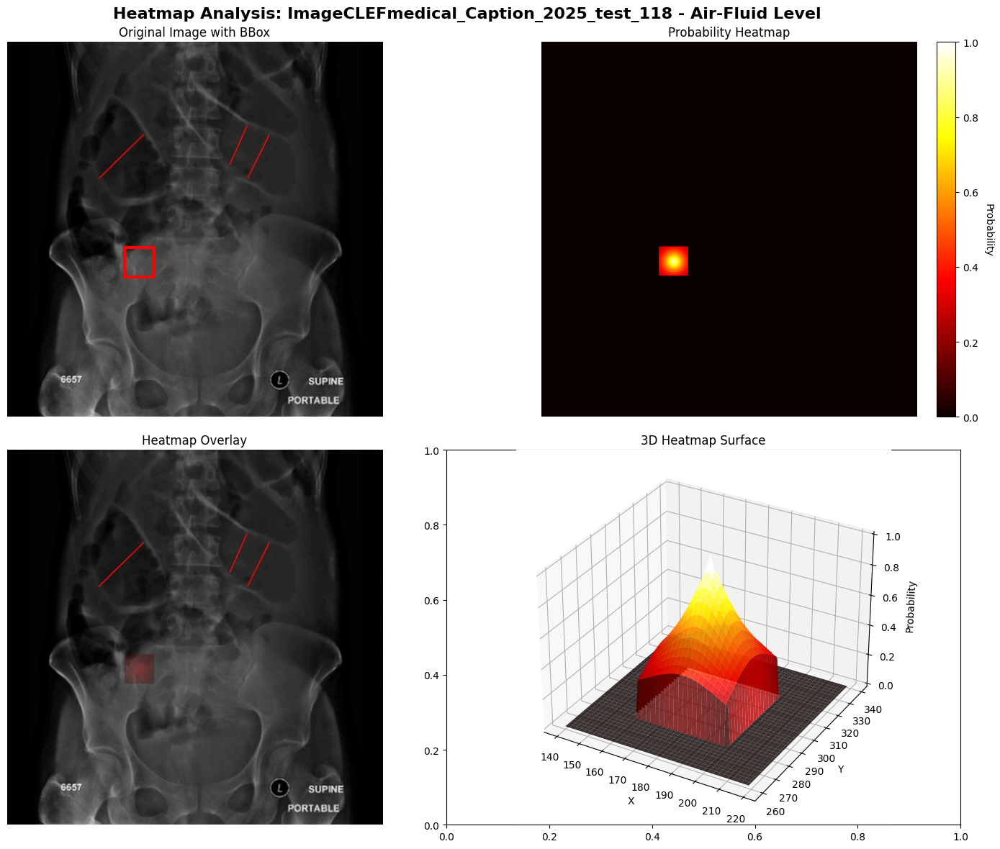

📊 4-panel heatmap displayed and saved: ./result_explain-3/sam/heatmap_4panel_ImageCLEFmedical_Caption_2025_test_118_Air-Fluid_Level.png


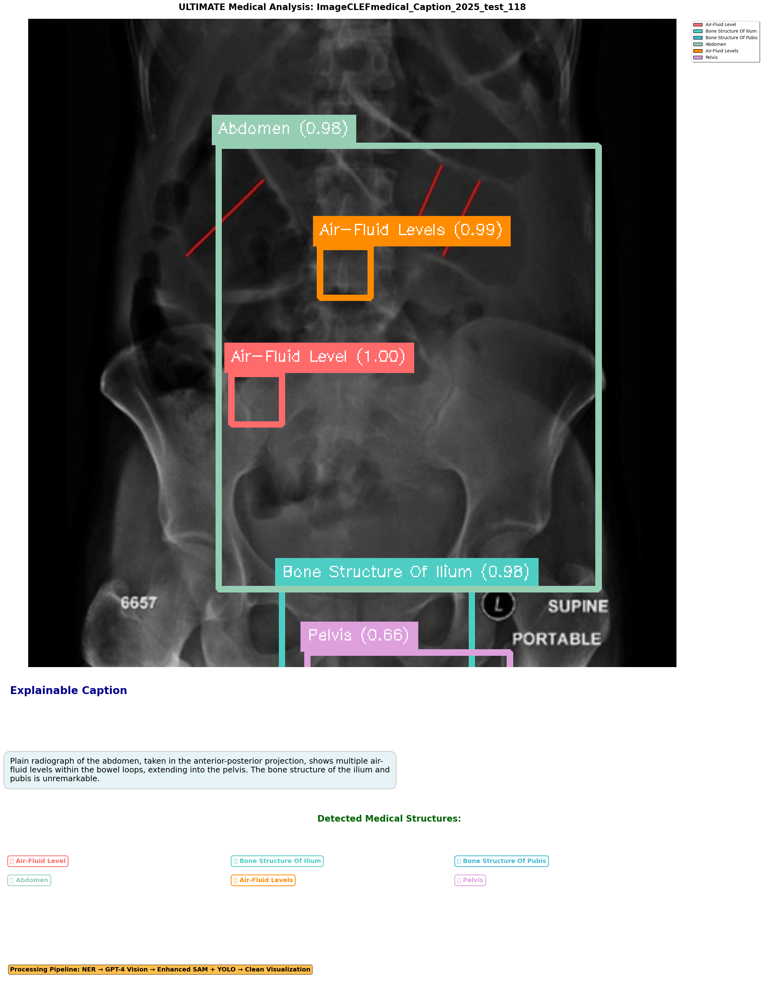


🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍

COMPREHENSIVE DATA TABLE FOR IMAGE: ImageCLEFmedical_Caption_2025_test_118
      Data Source             Content                                                                                              Details
    📋 A) Concepts    Medical Concepts  CUIs: Plain x-ray;Abdomen;Anterior-Posterior;Pelvis;Bone structure of ilium;Bone structure of pubis
    📝 B) Captions       Image Caption                        Plain abdominal radiograph showing the presence of multiple air-fluid levels.
💬 C) Explanations Medical Explanation Plain radiograph of the abdomen, taken in the anterior-posterior projection, shows multiple air-f...

 A) Concepts - FULL DETAILS:
   CUIs: Plain x-ray;Abdomen;Anterior-Posterior;Pelvis;Bone structure of ilium;Bone structure of pubis

 C) Explanations - FULL DETAILS:
   Plain radiograph of the abdomen, taken in the anterior-posterior projection, shows multiple air-
fluid levels within

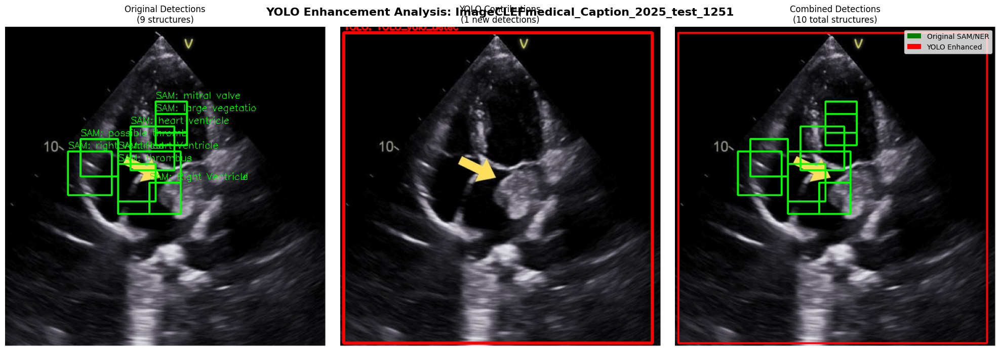

YOLO analysis displayed and saved: ./result_explain-3/sam/yolo_analysis_ImageCLEFmedical_Caption_2025_test_1251.png
Processing structures with advanced algorithms...
Keypoint strategy sift: 0.901 confidence
Keypoint strategy log_blobs: 0.976 confidence
Keypoint strategy fast: 0.863 confidence
Keypoint strategy horizontal_lines: 0.986 confidence
Best strategy for Heart Ventricle: keypoints_horizontal_lines (conf: 0.986)
Heart Ventricle: 0.986 using keypoints_horizontal_lines
Directional correction: 'Right Ventricle' -> 'left ventricle'
Keypoint strategy sift: 0.925 confidence
Keypoint strategy log_blobs: 0.988 confidence
Keypoint strategy fast: 0.934 confidence
Best strategy for Left Ventricle: keypoints_log_blobs (conf: 0.988)
Left Ventricle: 0.988 using keypoints_log_blobs
Directional correction: 'Right Ventricular Structure' -> 'left ventricular structure'
Keypoint strategy sift: 0.925 confidence
Keypoint strategy log_blobs: 0.988 confidence
Keypoint strategy fast: 0.934 confidence
B

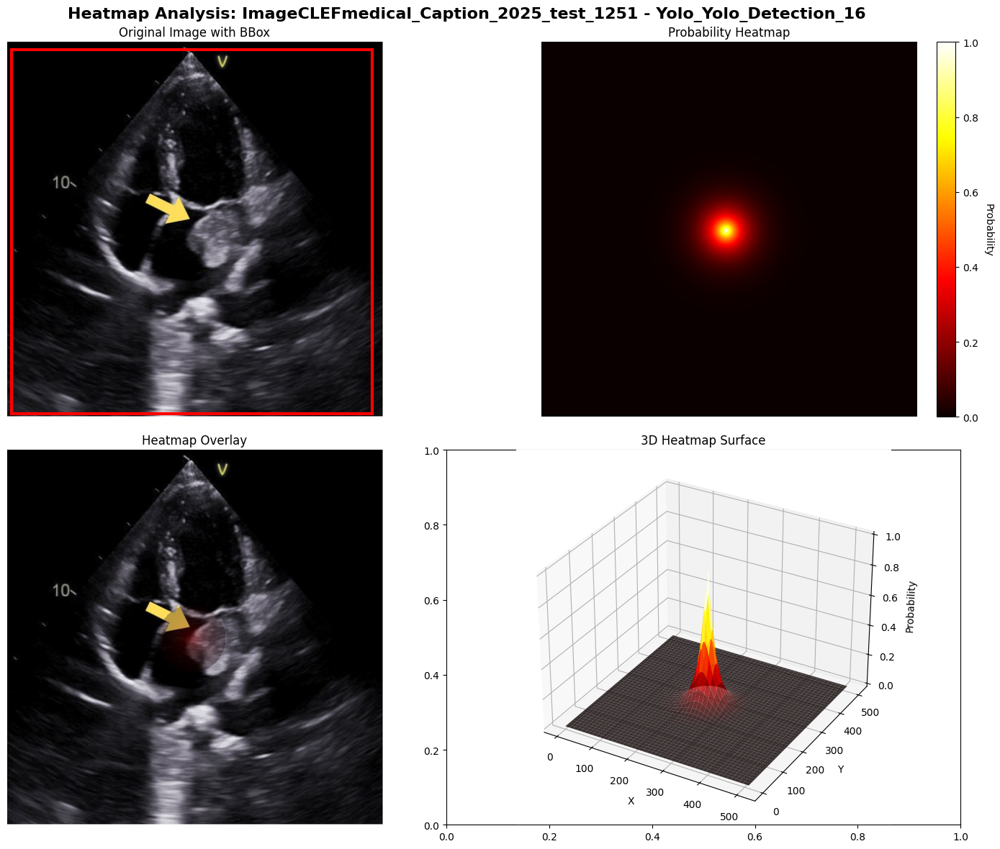

📊 4-panel heatmap displayed and saved: ./result_explain-3/sam/heatmap_4panel_ImageCLEFmedical_Caption_2025_test_1251_Yolo_Yolo_Detection_16.png


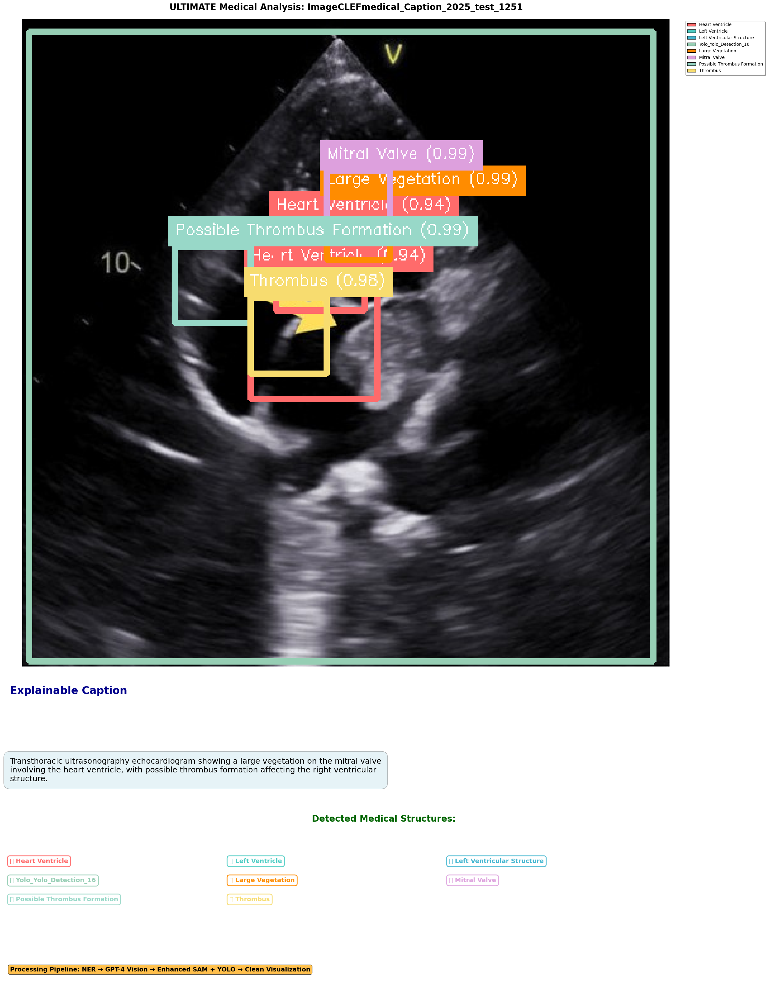


🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍

COMPREHENSIVE DATA TABLE FOR IMAGE: ImageCLEFmedical_Caption_2025_test_1251
      Data Source             Content                                                                                              Details
    📋 A) Concepts    Medical Concepts                           CUIs: Ultrasonography;Heart Ventricle;Thrombus;Right ventricular structure
    📝 B) Captions       Image Caption                         Transthoracic echocardiogram showing a large vegetation on the mitral valve.
💬 C) Explanations Medical Explanation Transthoracic ultrasonography echocardiogram showing a large vegetation on the mitral valve invol...

 C) Explanations - FULL DETAILS:
   Transthoracic ultrasonography echocardiogram showing a large vegetation on the mitral valve
involving the heart ventricle, with possible thrombus formation affecting the right ventricular
structure.


🏥 ULTIMATE ANALYSIS REPORT FOR ImageCLEFmedical

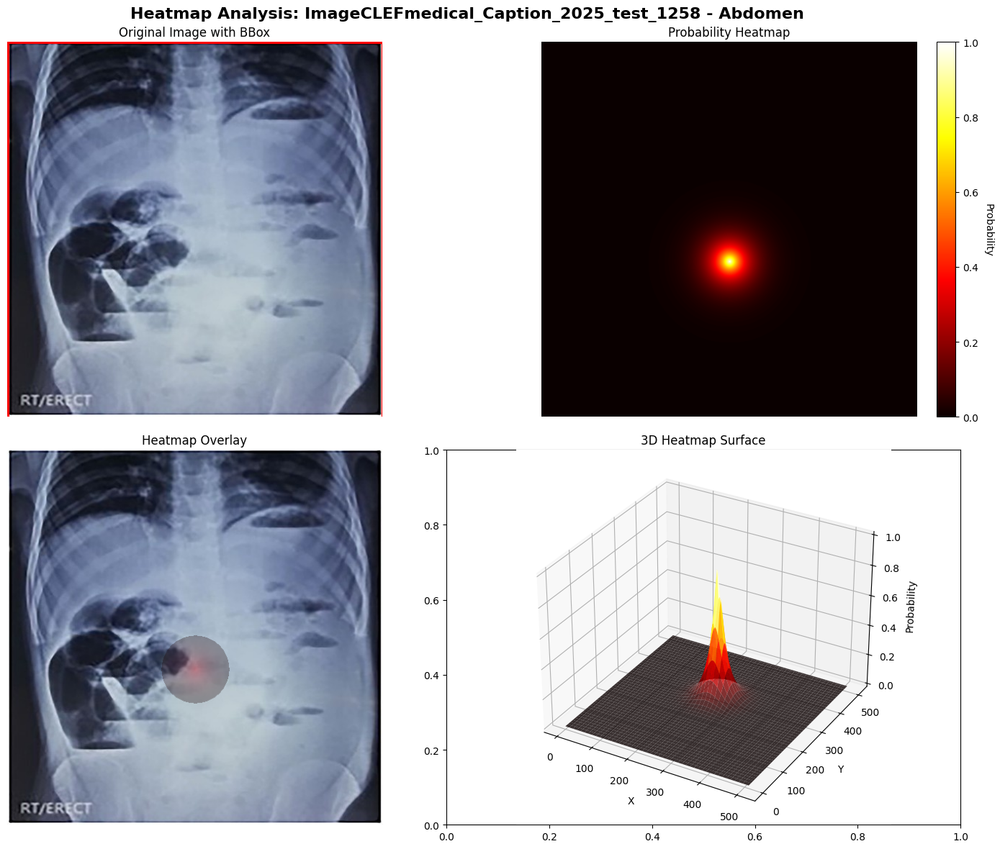

📊 4-panel heatmap displayed and saved: ./result_explain-3/sam/heatmap_4panel_ImageCLEFmedical_Caption_2025_test_1258_Abdomen.png


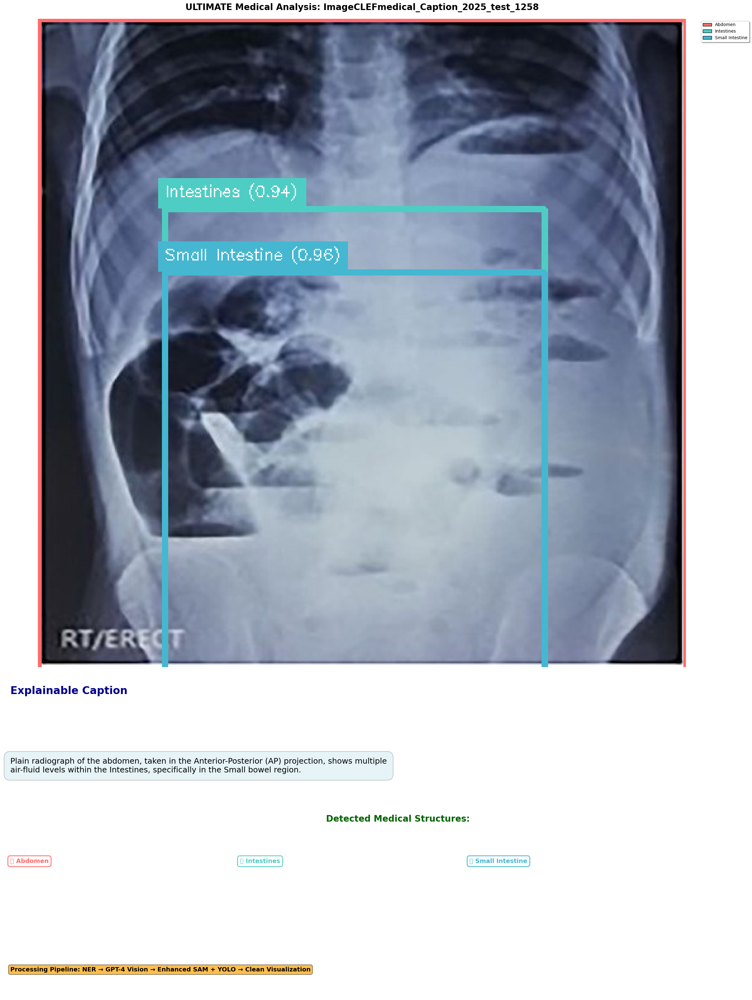


🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍

COMPREHENSIVE DATA TABLE FOR IMAGE: ImageCLEFmedical_Caption_2025_test_1258
      Data Source             Content                                                                                              Details
    📋 A) Concepts    Medical Concepts                                        CUIs: Plain x-ray;Abdomen;Anterior-Posterior;Intestines;Small
    📝 B) Captions       Image Caption                                                   Abdominal X-ray showing multiple air-fluid levels.
💬 C) Explanations Medical Explanation Plain radiograph of the abdomen, taken in the Anterior-Posterior (AP) projection, shows multiple ...

 C) Explanations - FULL DETAILS:
   Plain radiograph of the abdomen, taken in the Anterior-Posterior (AP) projection, shows multiple
air-fluid levels within the Intestines, specifically in the Small bowel region.


🏥 ULTIMATE ANALYSIS REPORT FOR ImageCLEFmedical_Caption_2025_test_125

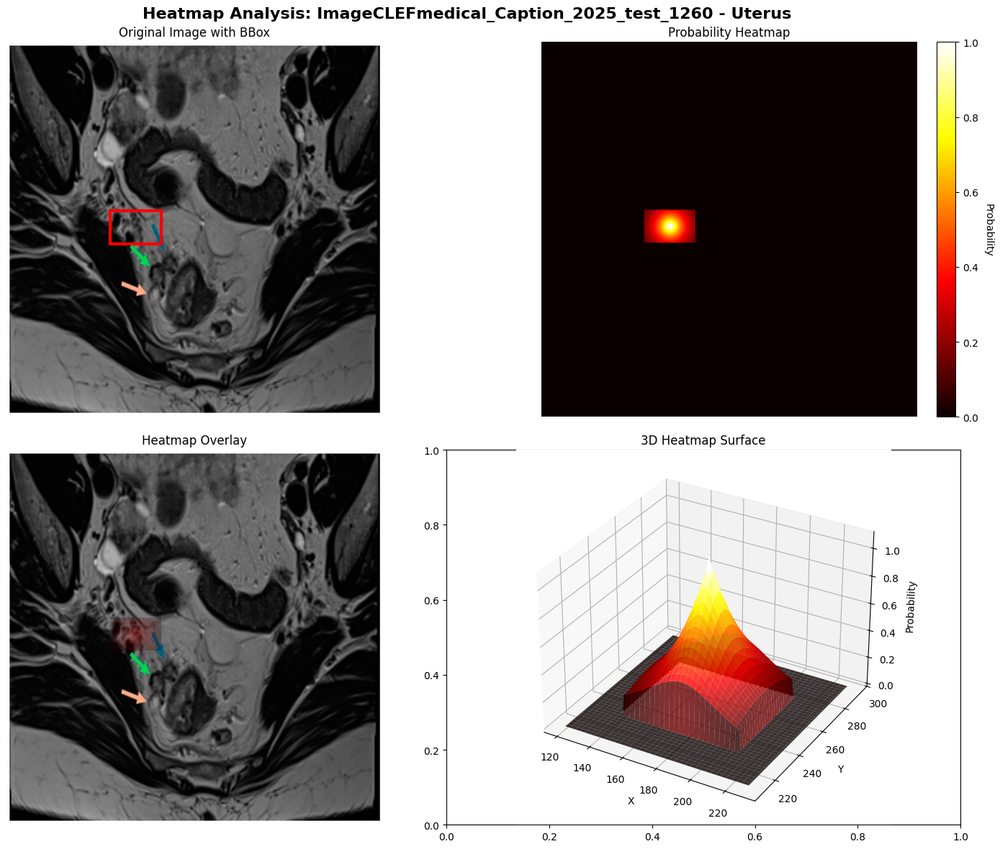

📊 4-panel heatmap displayed and saved: ./result_explain-3/sam/heatmap_4panel_ImageCLEFmedical_Caption_2025_test_1260_Uterus.png


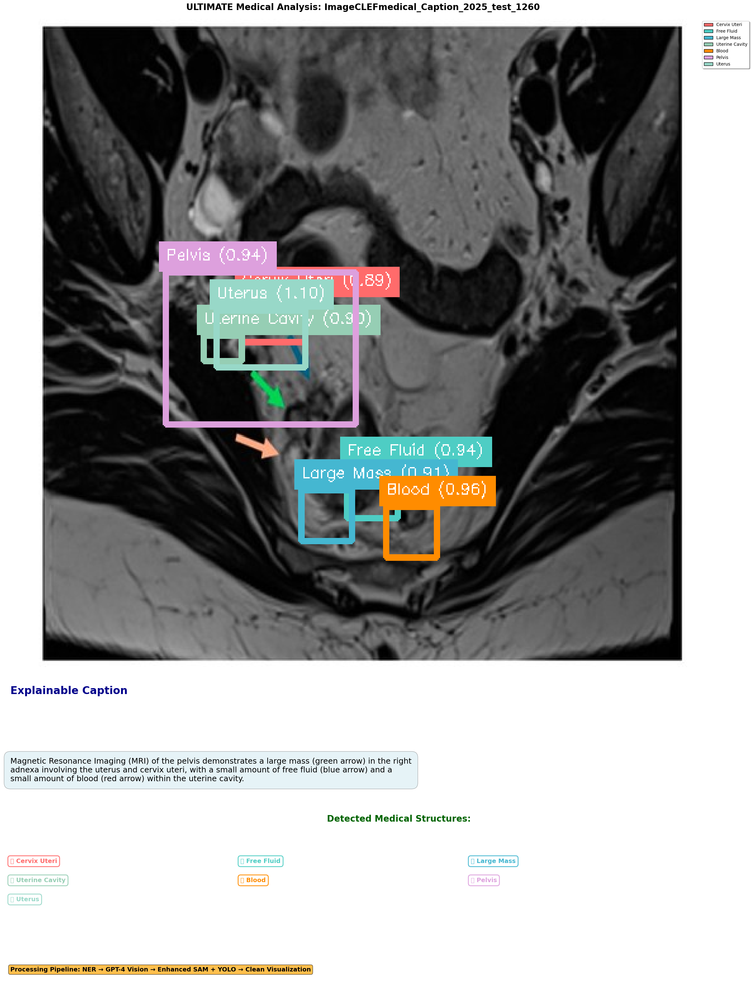


🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍

COMPREHENSIVE DATA TABLE FOR IMAGE: ImageCLEFmedical_Caption_2025_test_1260
      Data Source             Content                                                                                              Details
    📋 A) Concepts    Medical Concepts                           CUIs: Magnetic Resonance Imaging;Pelvis;Uterus;Cervix Uteri;Uterine cavity
    📝 B) Captions       Image Caption MRI of the pelvis showing a large mass (green arrow) in the right adnexa with a small amount of f...
💬 C) Explanations Medical Explanation Magnetic Resonance Imaging (MRI) of the pelvis demonstrates a large mass (green arrow) in the rig...

 B) Captions - FULL DETAILS:
   MRI of the pelvis showing a large mass (green arrow) in the right adnexa with a small amount of free
fluid (blue arrow) and a small amount of blood (red arrow).

 C) Explanations - FULL DETAILS:
   Magnetic Resonance Imaging (MRI) of the pelvis demonst

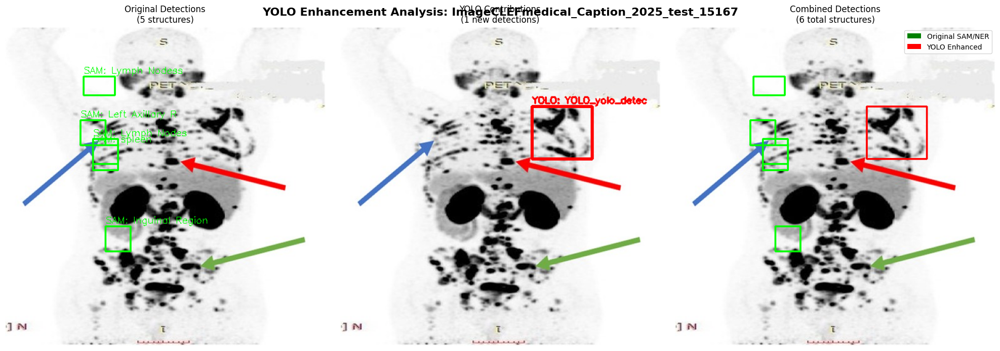

YOLO analysis displayed and saved: ./result_explain-3/sam/yolo_analysis_ImageCLEFmedical_Caption_2025_test_15167.png
Processing structures with advanced algorithms...
Error in SAM points: CUDA error: an illegal memory access was encountered
CUDA kernel errors might be asynchronously reported at some other API call, so the stacktrace below might be incorrect.
For debugging consider passing CUDA_LAUNCH_BLOCKING=1.
Compile with `TORCH_USE_CUDA_DSA` to enable device-side assertions.

Keypoint strategy sift: 0.000 confidence
Error in SAM points: CUDA error: an illegal memory access was encountered
CUDA kernel errors might be asynchronously reported at some other API call, so the stacktrace below might be incorrect.
For debugging consider passing CUDA_LAUNCH_BLOCKING=1.
Compile with `TORCH_USE_CUDA_DSA` to enable device-side assertions.

Keypoint strategy log_blobs: 0.000 confidence
Error in SAM points: CUDA error: an illegal memory access was encountered
CUDA kernel errors might be asynchro

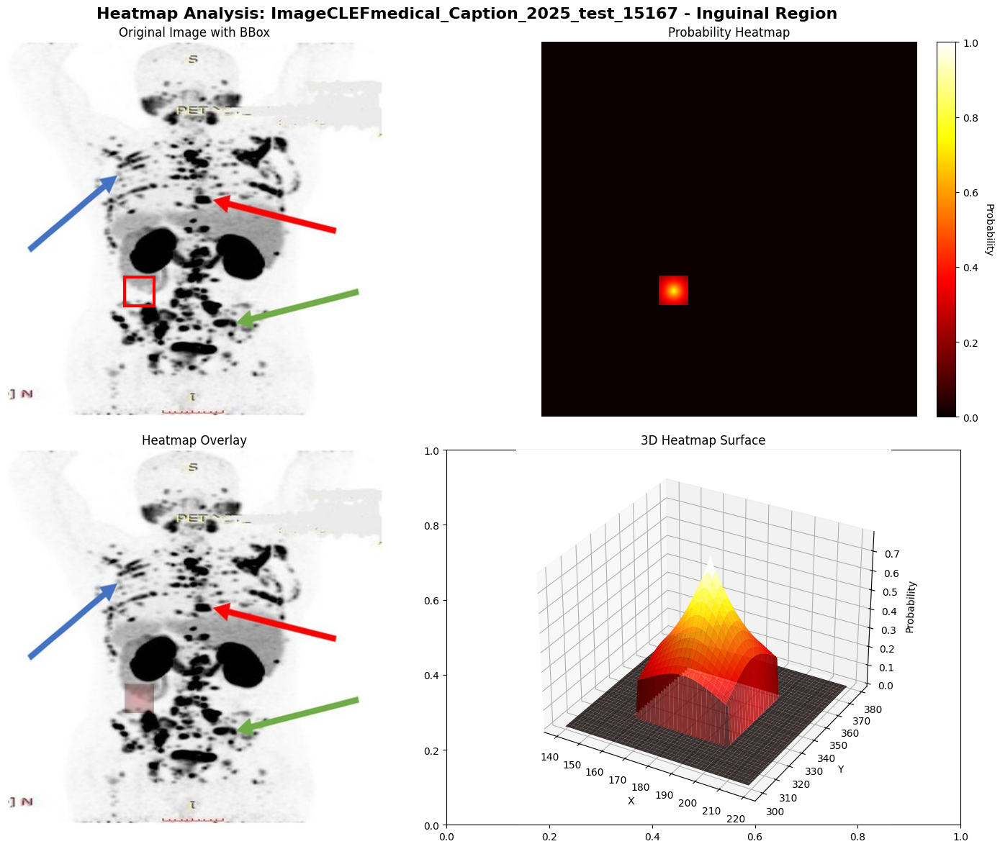

📊 4-panel heatmap displayed and saved: ./result_explain-3/sam/heatmap_4panel_ImageCLEFmedical_Caption_2025_test_15167_Inguinal_Region.png


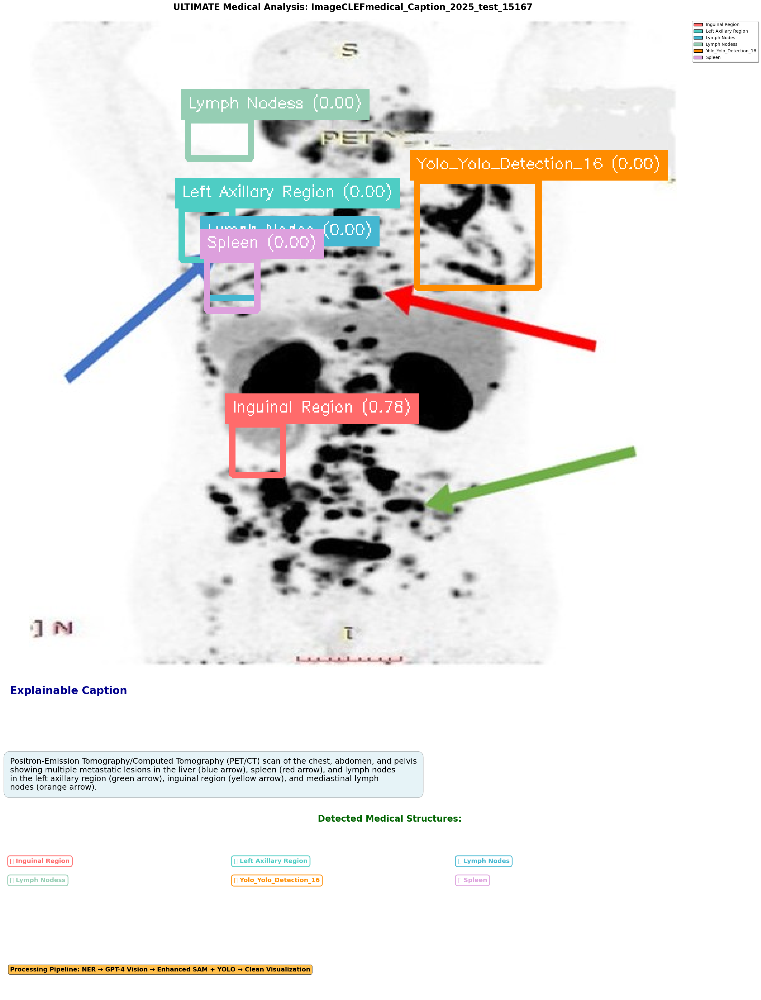


🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍

COMPREHENSIVE DATA TABLE FOR IMAGE: ImageCLEFmedical_Caption_2025_test_15167
      Data Source             Content                                                                                              Details
    📋 A) Concepts    Medical Concepts CUIs: Positron-Emission Tomography;lymph nodes;Structure of left axillary region;lymph;Inguinal r...
    📝 B) Captions       Image Caption PET/CT scan showing multiple metastatic lesions in the liver (blue arrow), spleen (red arrow), an...
💬 C) Explanations Medical Explanation Positron-Emission Tomography/Computed Tomography (PET/CT) scan of the chest, abdomen, and pelvis ...

 A) Concepts - FULL DETAILS:
   CUIs: Positron-Emission Tomography;lymph nodes;Structure of left axillary region;lymph;Inguinal
region;lymph nodes

 B) Captions - FULL DETAILS:
   PET/CT scan showing multiple metastatic lesions in the liver (blue arrow), spleen (red arrow), and
lymp

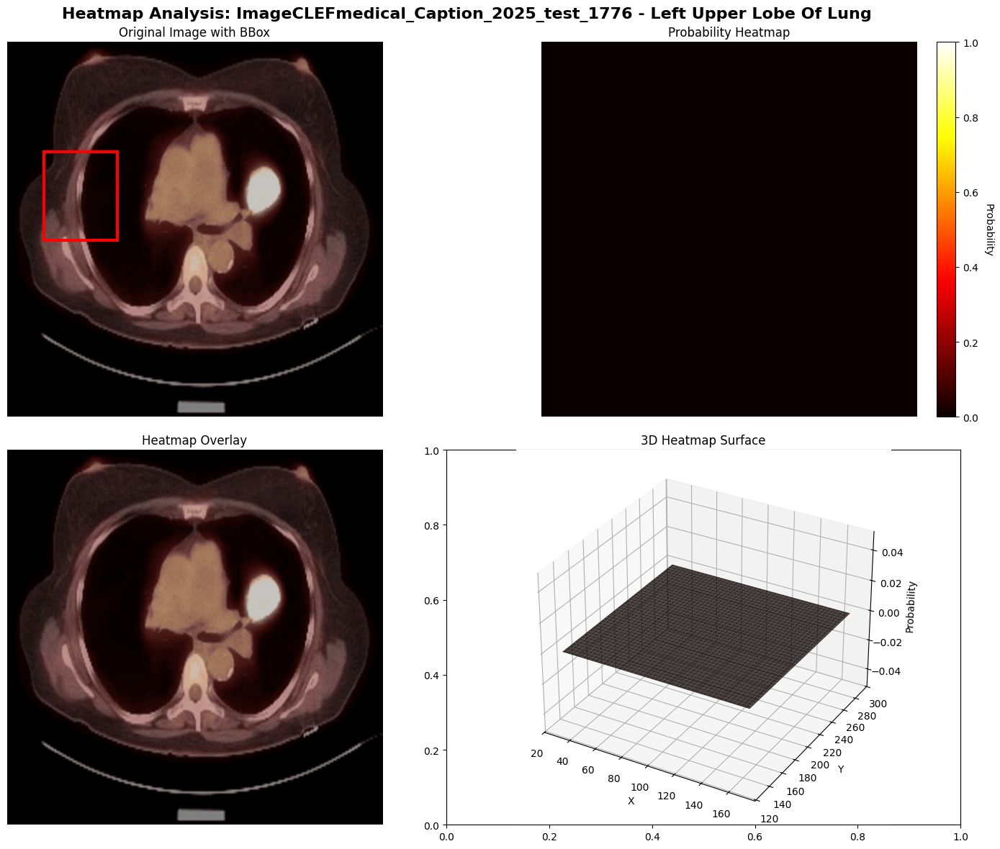

📊 4-panel heatmap displayed and saved: ./result_explain-3/sam/heatmap_4panel_ImageCLEFmedical_Caption_2025_test_1776_Left_Upper_Lobe_Of_Lung.png


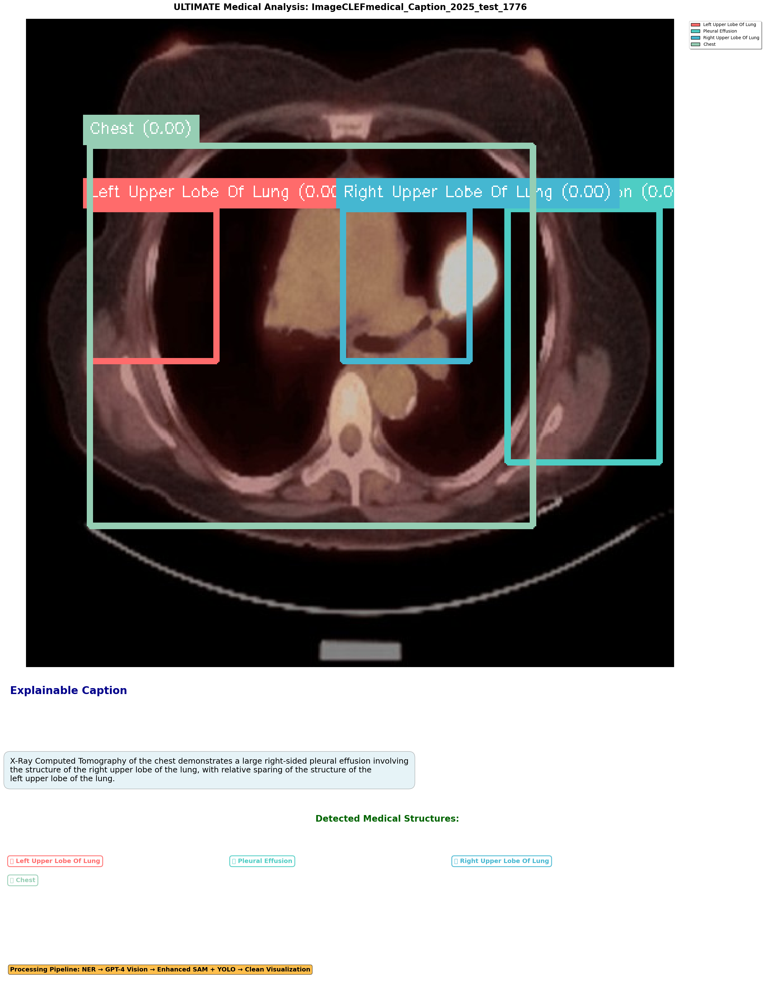


🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍

COMPREHENSIVE DATA TABLE FOR IMAGE: ImageCLEFmedical_Caption_2025_test_1776
      Data Source             Content                                                                                              Details
    📋 A) Concepts    Medical Concepts CUIs: X-Ray Computed Tomography;Chest;Structure of right upper lobe of lung;Structure of left upp...
    📝 B) Captions       Image Caption                                   CT scan of the chest showing a large right-sided pleural effusion.
💬 C) Explanations Medical Explanation X-Ray Computed Tomography of the chest demonstrates a large right-sided pleural effusion involvin...

 A) Concepts - FULL DETAILS:
   CUIs: X-Ray Computed Tomography;Chest;Structure of right upper lobe of lung;Structure of left upper
lobe of lung

 C) Explanations - FULL DETAILS:
   X-Ray Computed Tomography of the chest demonstrates a large right-sided pleural effusion involving
the

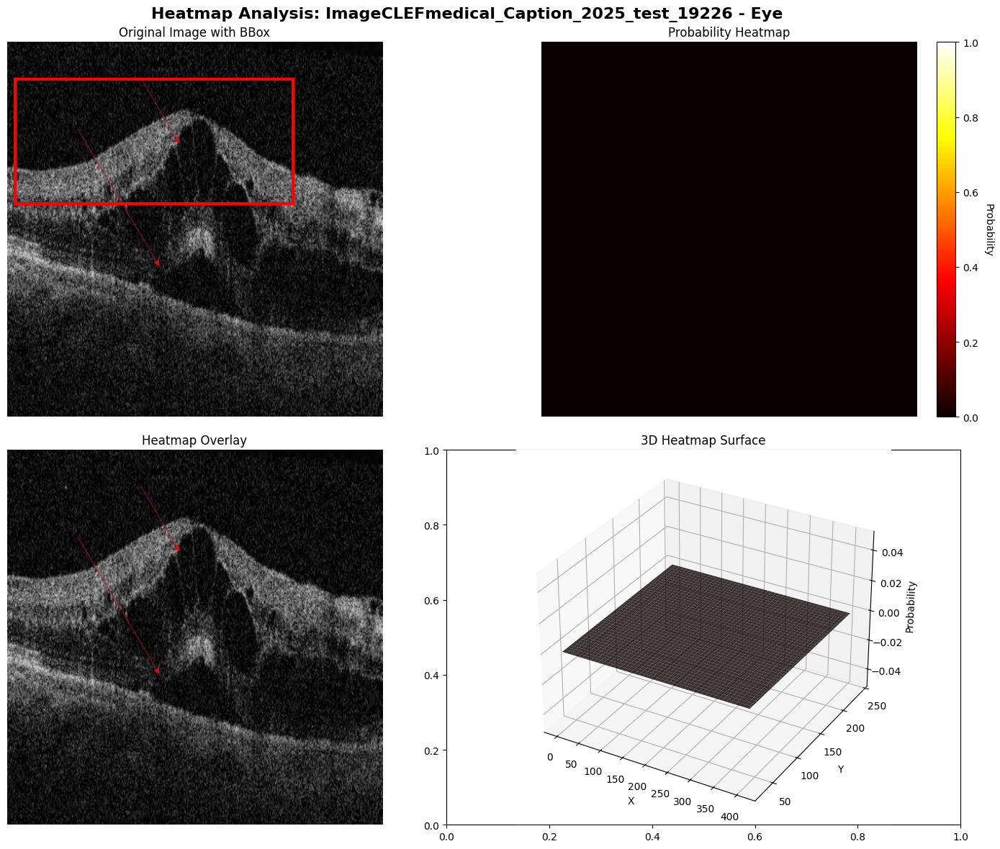

📊 4-panel heatmap displayed and saved: ./result_explain-3/sam/heatmap_4panel_ImageCLEFmedical_Caption_2025_test_19226_Eye.png


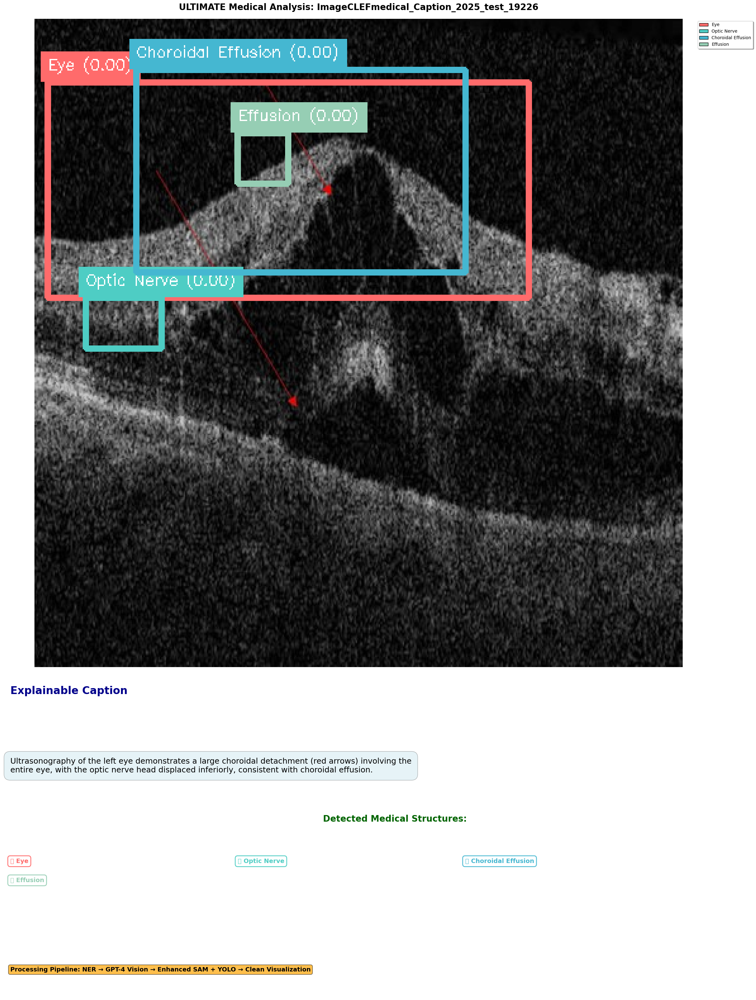


🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍

COMPREHENSIVE DATA TABLE FOR IMAGE: ImageCLEFmedical_Caption_2025_test_19226
      Data Source             Content                                                                                              Details
    📋 A) Concepts    Medical Concepts                                                         CUIs: Ultrasonography;Optic Nerve;Entire eye
    📝 B) Captions       Image Caption                             B-scan of the left eye showing a large choroidal detachment (red arrows)
💬 C) Explanations Medical Explanation Ultrasonography of the left eye demonstrates a large choroidal detachment (red arrows) involving ...

 C) Explanations - FULL DETAILS:
   Ultrasonography of the left eye demonstrates a large choroidal detachment (red arrows) involving the
entire eye, with the optic nerve head displaced inferiorly, consistent with choroidal effusion.


🏥 ULTIMATE ANALYSIS REPORT FOR ImageCLEFmedical_

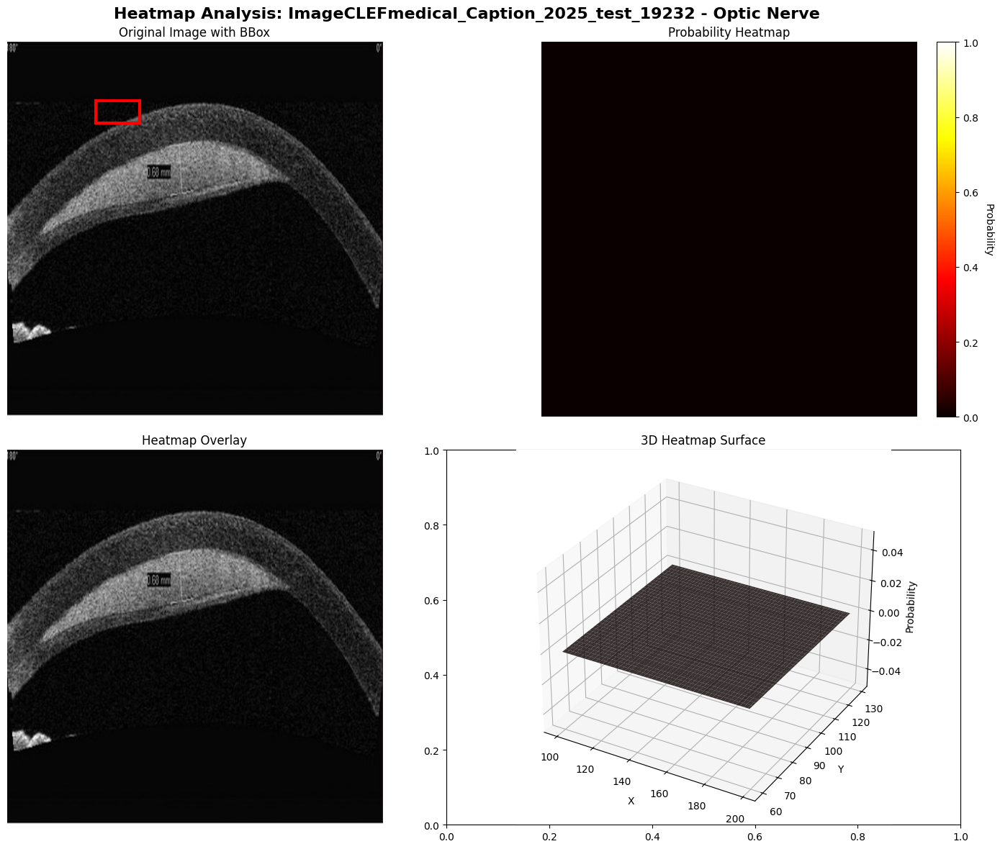

📊 4-panel heatmap displayed and saved: ./result_explain-3/sam/heatmap_4panel_ImageCLEFmedical_Caption_2025_test_19232_Optic_Nerve.png


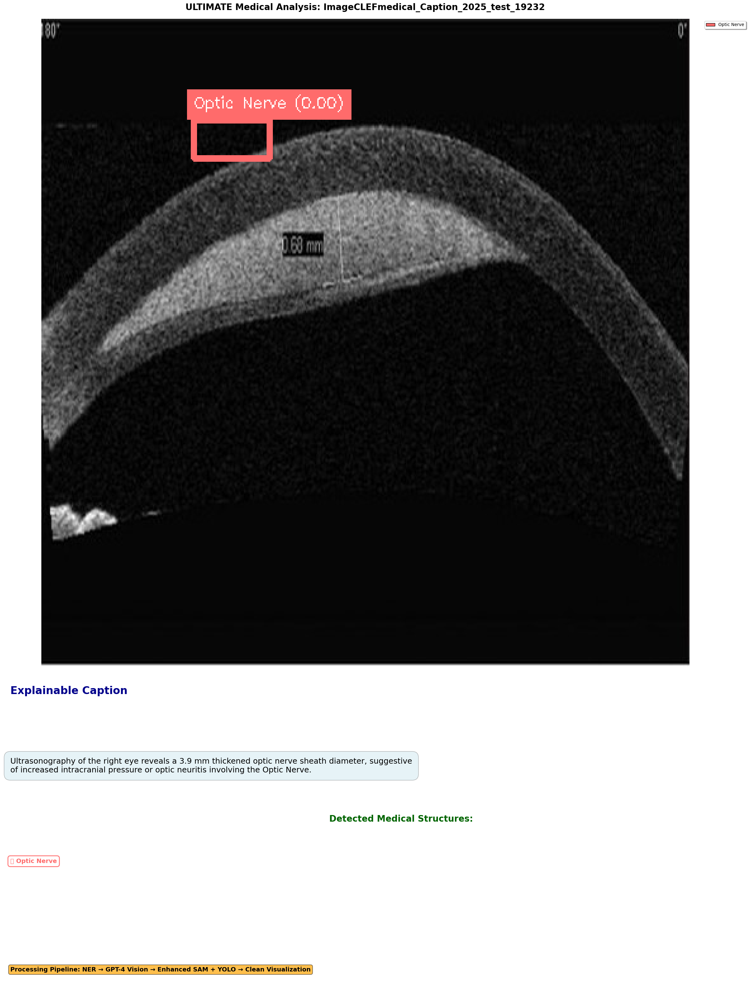


🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍

COMPREHENSIVE DATA TABLE FOR IMAGE: ImageCLEFmedical_Caption_2025_test_19232
      Data Source             Content                                                                                              Details
    📋 A) Concepts    Medical Concepts                                                                    CUIs: Ultrasonography;Optic Nerve
    📝 B) Captions       Image Caption            Ultrasound image of the right eye showing a 3.9 mm thickened optic nerve sheath diameter.
💬 C) Explanations Medical Explanation Ultrasonography of the right eye reveals a 3.9 mm thickened optic nerve sheath diameter, suggesti...

 B) Captions - FULL DETAILS:
   Ultrasound image of the right eye showing a 3.9 mm thickened optic nerve sheath diameter.

 C) Explanations - FULL DETAILS:
   Ultrasonography of the right eye reveals a 3.9 mm thickened optic nerve sheath diameter, suggestive
of increased intracrania

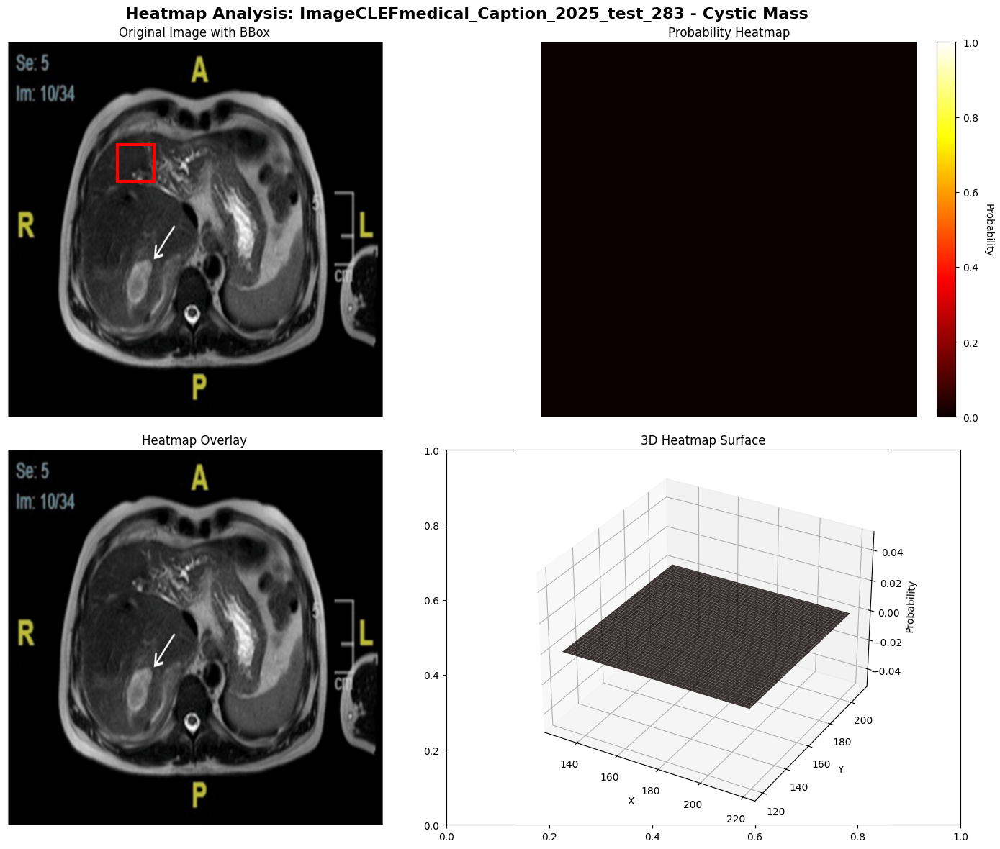

📊 4-panel heatmap displayed and saved: ./result_explain-3/sam/heatmap_4panel_ImageCLEFmedical_Caption_2025_test_283_Cystic_Mass.png


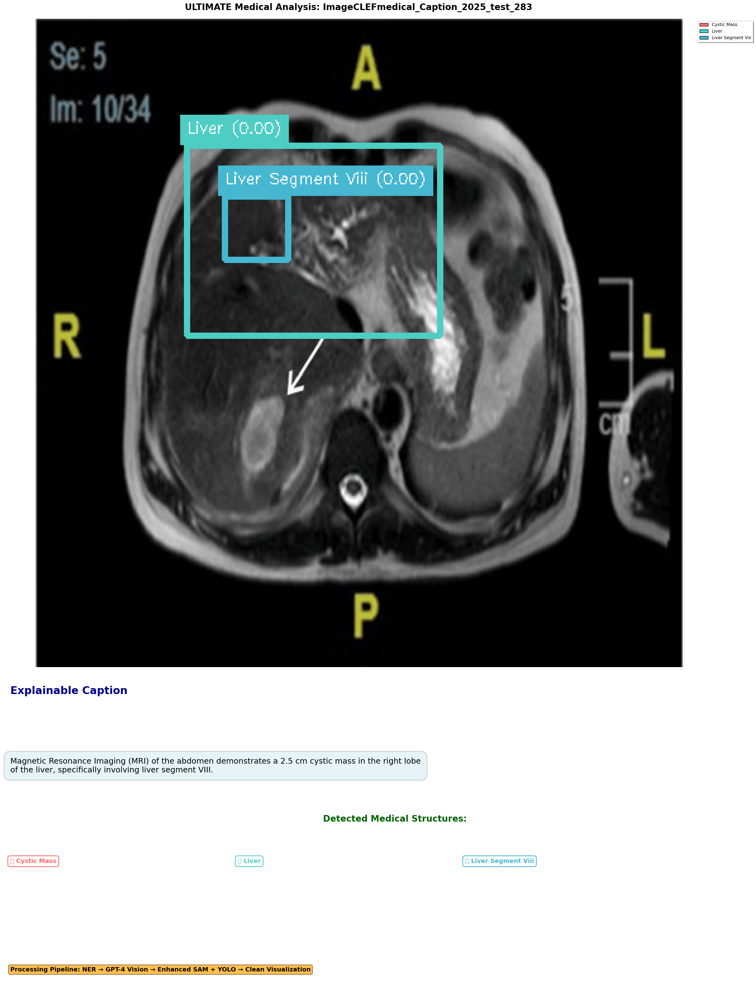


🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍

COMPREHENSIVE DATA TABLE FOR IMAGE: ImageCLEFmedical_Caption_2025_test_283
      Data Source             Content                                                                                              Details
    📋 A) Concepts    Medical Concepts                                          CUIs: Magnetic Resonance Imaging;Liver;Cystic;Liver segment
    📝 B) Captions       Image Caption                     MRI of the abdomen showing a 2.5 cm mass in the right lobe of the liver (arrow).
💬 C) Explanations Medical Explanation Magnetic Resonance Imaging (MRI) of the abdomen demonstrates a 2.5 cm cystic mass in the right lo...

 C) Explanations - FULL DETAILS:
   Magnetic Resonance Imaging (MRI) of the abdomen demonstrates a 2.5 cm cystic mass in the right lobe
of the liver, specifically involving liver segment VIII.


🏥 ULTIMATE ANALYSIS REPORT FOR ImageCLEFmedical_Caption_2025_test_283
📊 Structures detecte

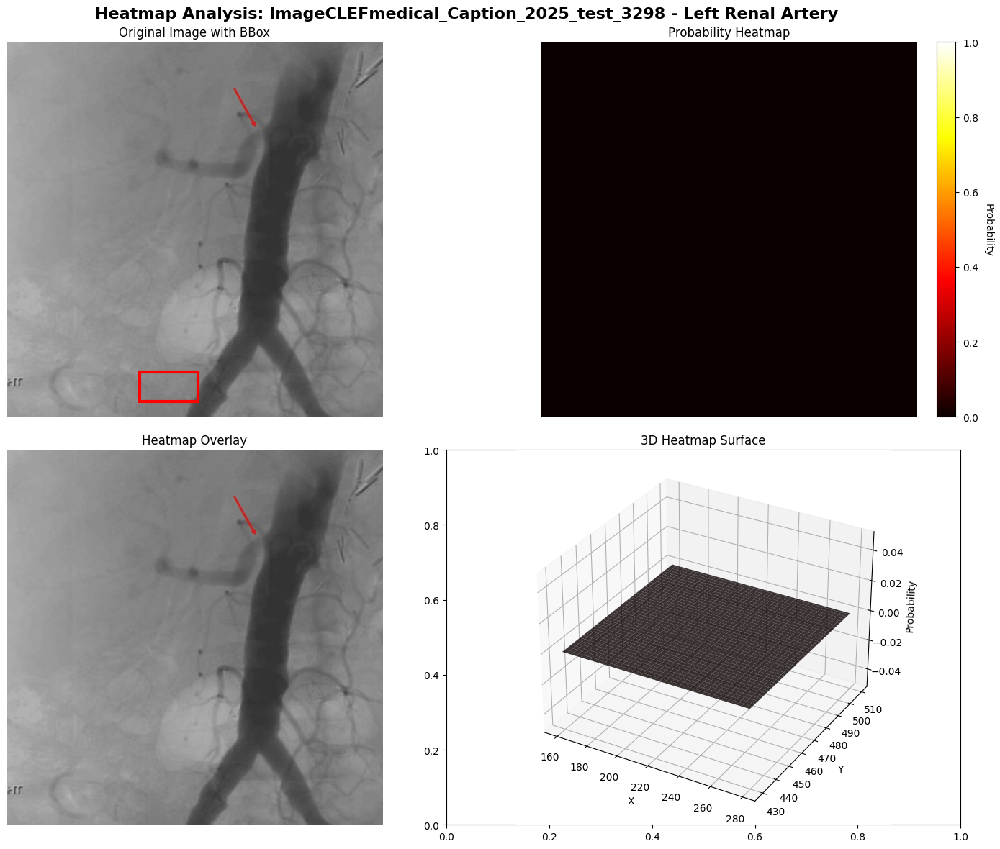

📊 4-panel heatmap displayed and saved: ./result_explain-3/sam/heatmap_4panel_ImageCLEFmedical_Caption_2025_test_3298_Left_Renal_Artery.png


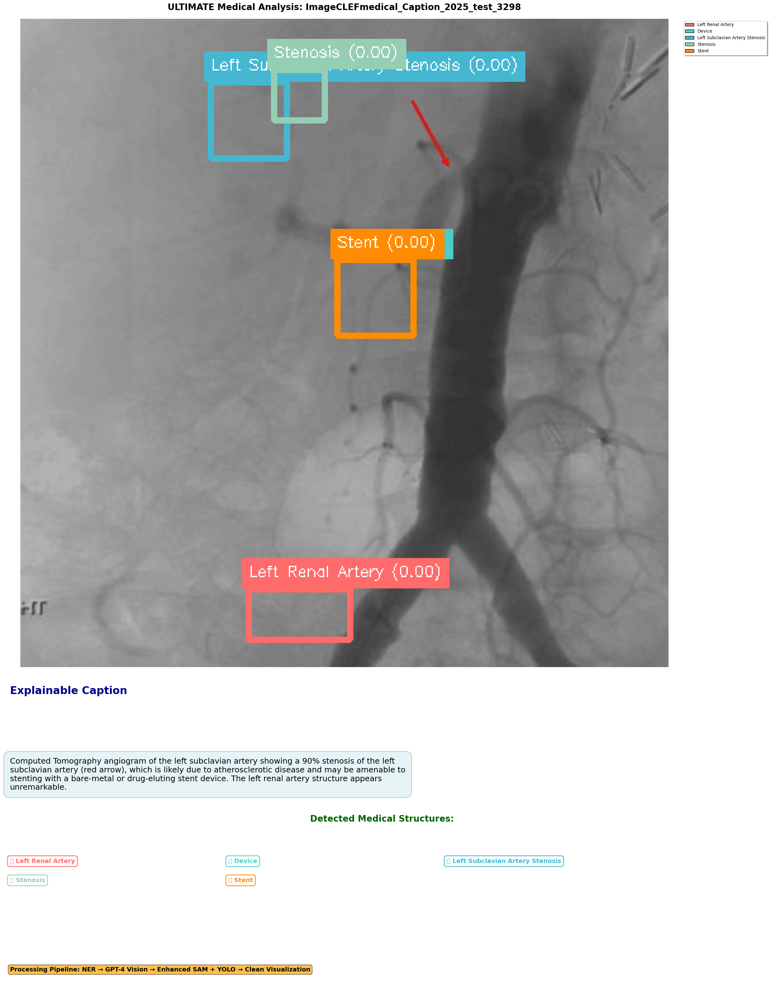


🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍

COMPREHENSIVE DATA TABLE FOR IMAGE: ImageCLEFmedical_Caption_2025_test_3298
      Data Source             Content                                                                                              Details
    📋 A) Concepts    Medical Concepts                                          CUIs: angiogram;Structure of left renal artery;Stent;device
    📝 B) Captions       Image Caption Angiography of the left subclavian artery showing a 90% stenosis of the left subclavian artery (r...
💬 C) Explanations Medical Explanation Computed Tomography angiogram of the left subclavian artery showing a 90% stenosis of the left su...

 B) Captions - FULL DETAILS:
   Angiography of the left subclavian artery showing a 90% stenosis of the left subclavian artery (red
arrow).

 C) Explanations - FULL DETAILS:
   Computed Tomography angiogram of the left subclavian artery showing a 90% stenosis of the left
subclavian a

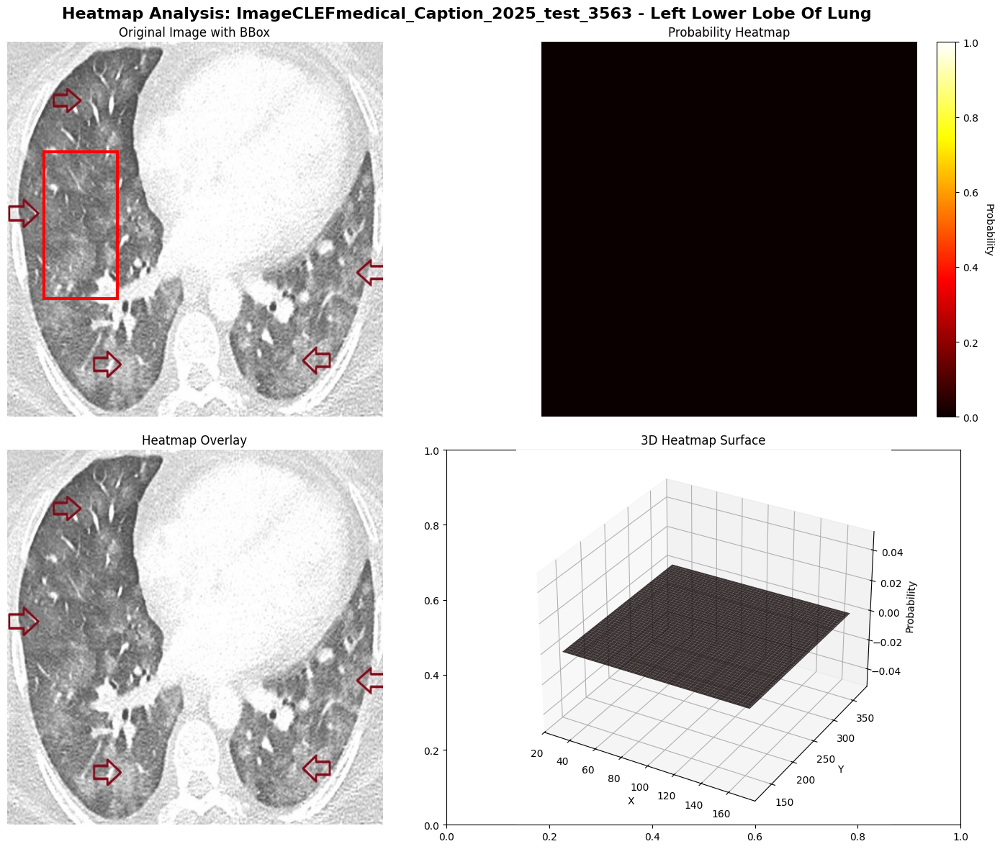

📊 4-panel heatmap displayed and saved: ./result_explain-3/sam/heatmap_4panel_ImageCLEFmedical_Caption_2025_test_3563_Left_Lower_Lobe_Of_Lung.png


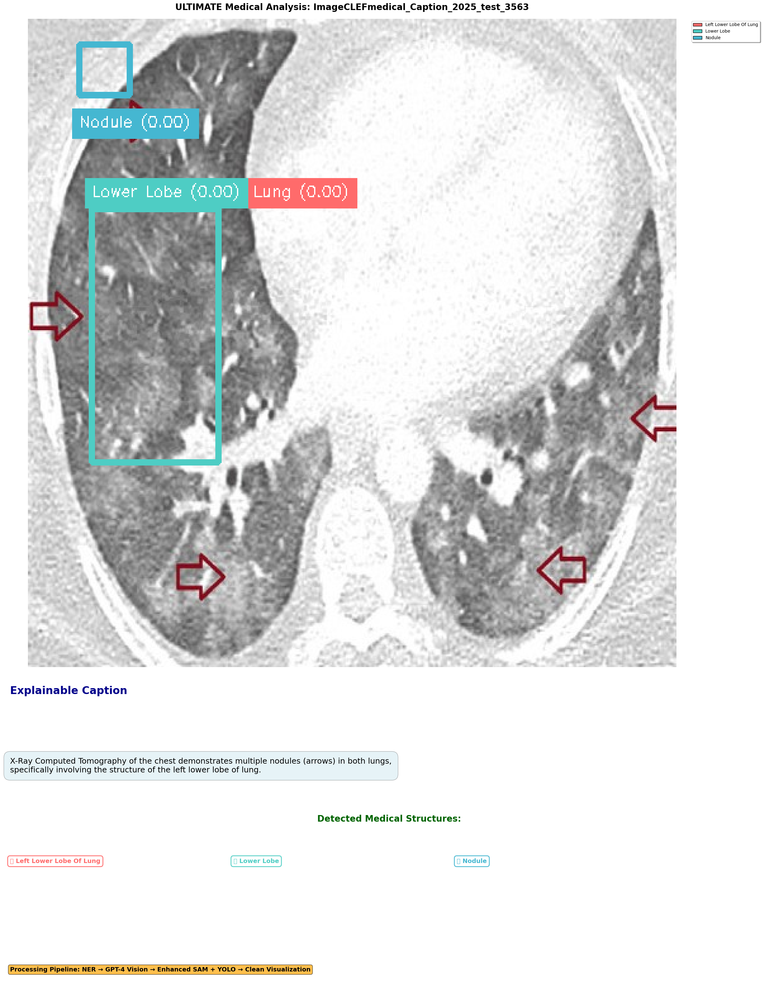


🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍

COMPREHENSIVE DATA TABLE FOR IMAGE: ImageCLEFmedical_Caption_2025_test_3563
      Data Source             Content                                                                                              Details
    📋 A) Concepts    Medical Concepts                    CUIs: X-Ray Computed Tomography;Chest;Nodule;Structure of left lower lobe of lung
    📝 B) Captions       Image Caption                                       Chest CT scan showing multiple nodules (arrows) in both lungs.
💬 C) Explanations Medical Explanation X-Ray Computed Tomography of the chest demonstrates multiple nodules (arrows) in both lungs, spec...

 A) Concepts - FULL DETAILS:
   CUIs: X-Ray Computed Tomography;Chest;Nodule;Structure of left lower lobe of lung

 C) Explanations - FULL DETAILS:
   X-Ray Computed Tomography of the chest demonstrates multiple nodules (arrows) in both lungs,
specifically involving the structure of 

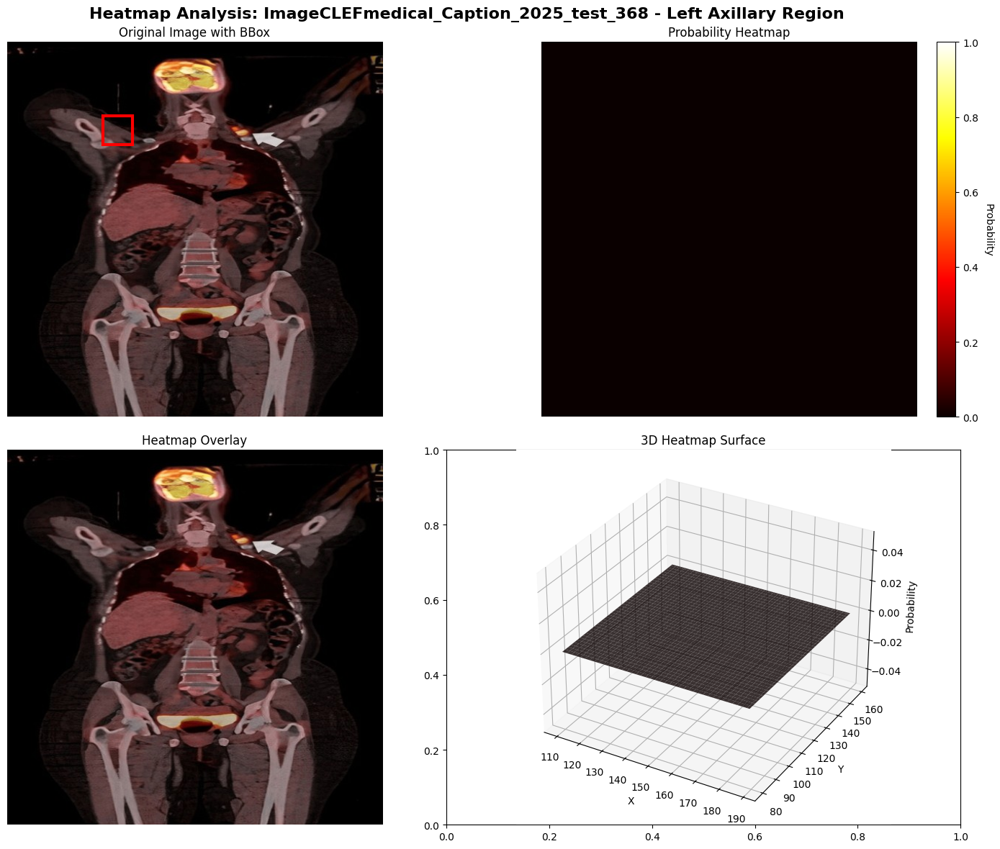

📊 4-panel heatmap displayed and saved: ./result_explain-3/sam/heatmap_4panel_ImageCLEFmedical_Caption_2025_test_368_Left_Axillary_Region.png


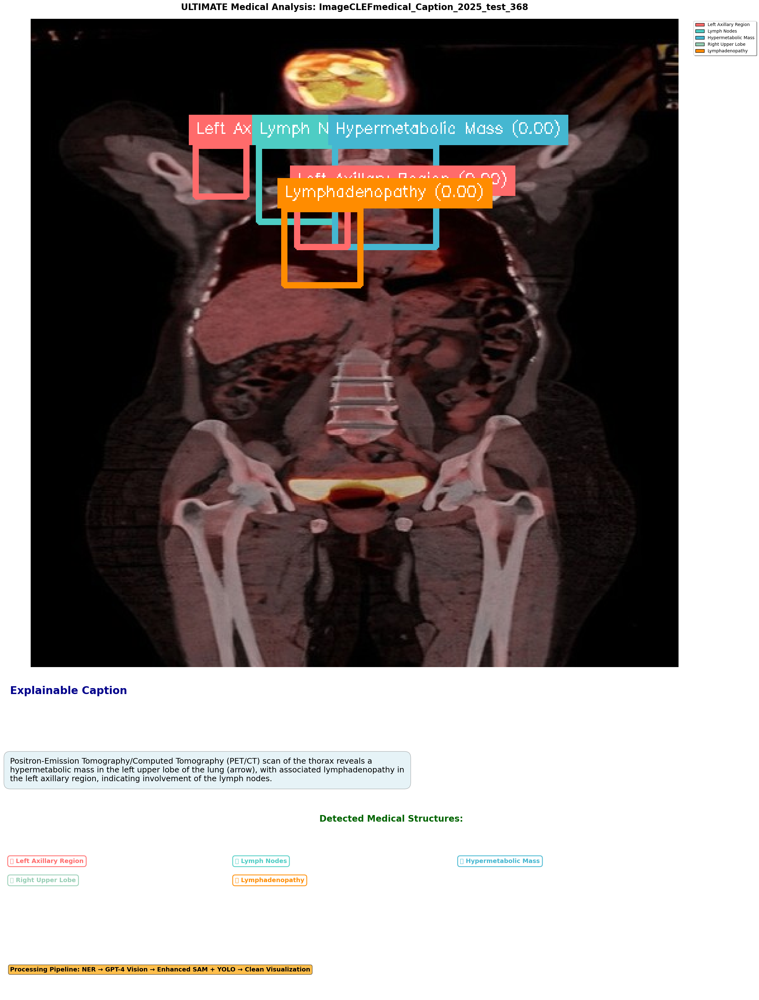


🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍

COMPREHENSIVE DATA TABLE FOR IMAGE: ImageCLEFmedical_Caption_2025_test_368
      Data Source             Content                                                                                              Details
    📋 A) Concepts    Medical Concepts                     CUIs: Positron-Emission Tomography;Structure of left axillary region;lymph nodes
    📝 B) Captions       Image Caption                PET/CT scan showing a hypermetabolic mass in the left upper lobe of the lung (arrow).
💬 C) Explanations Medical Explanation Positron-Emission Tomography/Computed Tomography (PET/CT) scan of the thorax reveals a hypermetab...

 B) Captions - FULL DETAILS:
   PET/CT scan showing a hypermetabolic mass in the left upper lobe of the lung (arrow).

 C) Explanations - FULL DETAILS:
   Positron-Emission Tomography/Computed Tomography (PET/CT) scan of the thorax reveals a
hypermetabolic mass in the left upper lobe 

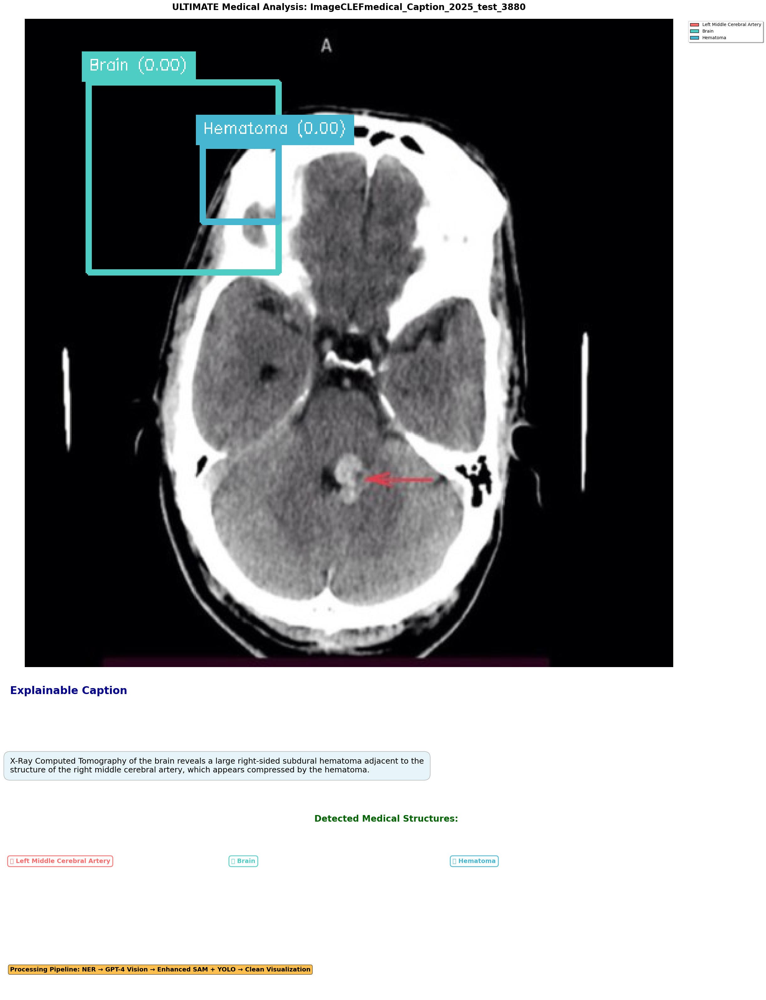


🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍

COMPREHENSIVE DATA TABLE FOR IMAGE: ImageCLEFmedical_Caption_2025_test_3880
      Data Source             Content                                                                                              Details
    📋 A) Concepts    Medical Concepts             CUIs: X-Ray Computed Tomography;Brain;Hematoma;Structure of right middle cerebral artery
    📝 B) Captions       Image Caption                                  CT scan of the brain showing a large right-sided subdural hematoma.
💬 C) Explanations Medical Explanation X-Ray Computed Tomography of the brain reveals a large right-sided subdural hematoma adjacent to ...

 A) Concepts - FULL DETAILS:
   CUIs: X-Ray Computed Tomography;Brain;Hematoma;Structure of right middle cerebral artery

 C) Explanations - FULL DETAILS:
   X-Ray Computed Tomography of the brain reveals a large right-sided subdural hematoma adjacent to the
structure of the right mi

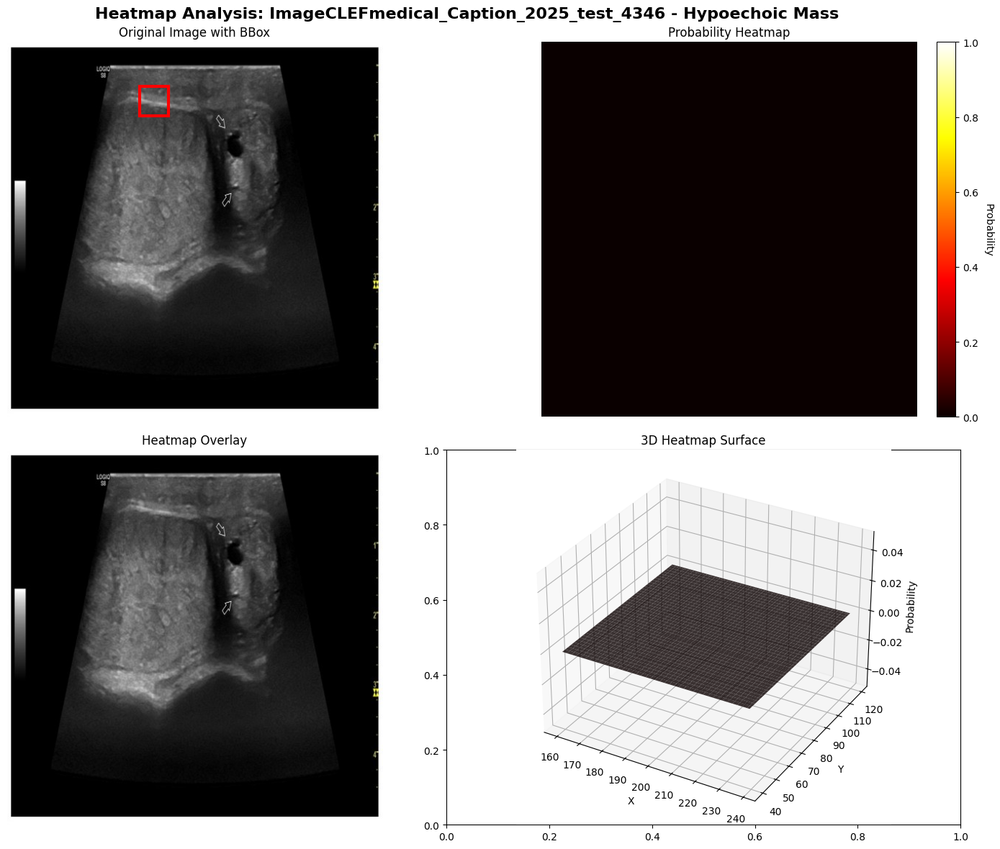

📊 4-panel heatmap displayed and saved: ./result_explain-3/sam/heatmap_4panel_ImageCLEFmedical_Caption_2025_test_4346_Hypoechoic_Mass.png


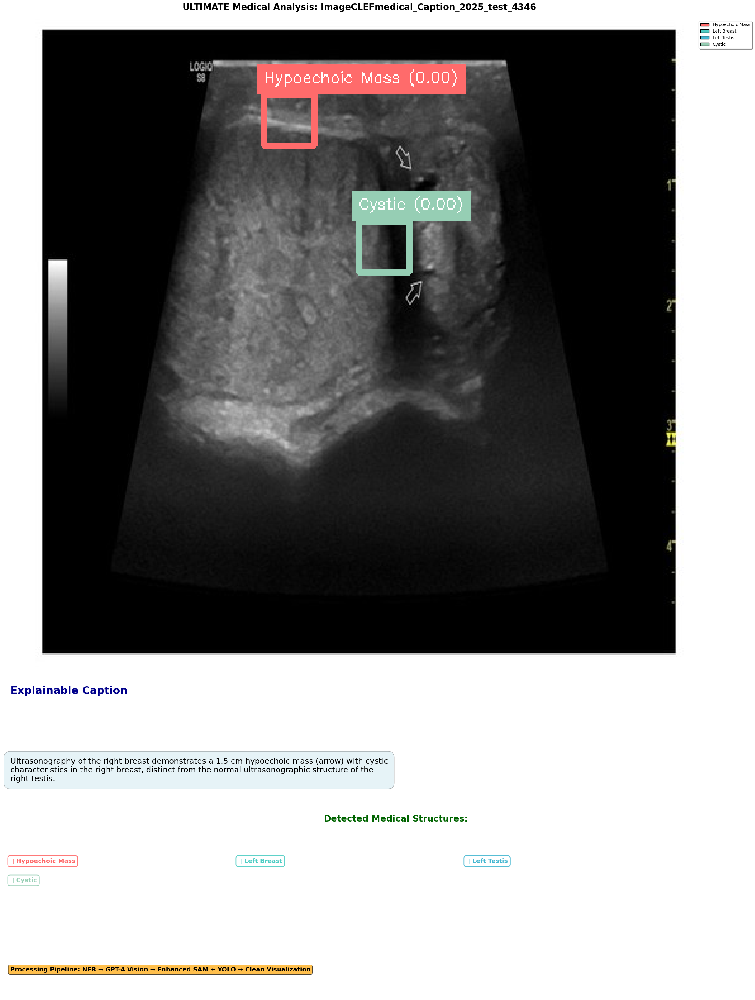


🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍

COMPREHENSIVE DATA TABLE FOR IMAGE: ImageCLEFmedical_Caption_2025_test_4346
      Data Source             Content                                                                                              Details
    📋 A) Concepts    Medical Concepts                                               CUIs: Ultrasonography;Cystic;Structure of right testis
    📝 B) Captions       Image Caption   Ultrasound image of the right breast showing a 1.5 cm hypoechoic mass (arrow) in the right breast.
💬 C) Explanations Medical Explanation Ultrasonography of the right breast demonstrates a 1.5 cm hypoechoic mass (arrow) with cystic cha...

 B) Captions - FULL DETAILS:
   Ultrasound image of the right breast showing a 1.5 cm hypoechoic mass (arrow) in the right breast.

 C) Explanations - FULL DETAILS:
   Ultrasonography of the right breast demonstrates a 1.5 cm hypoechoic mass (arrow) with cystic
characteristics in the

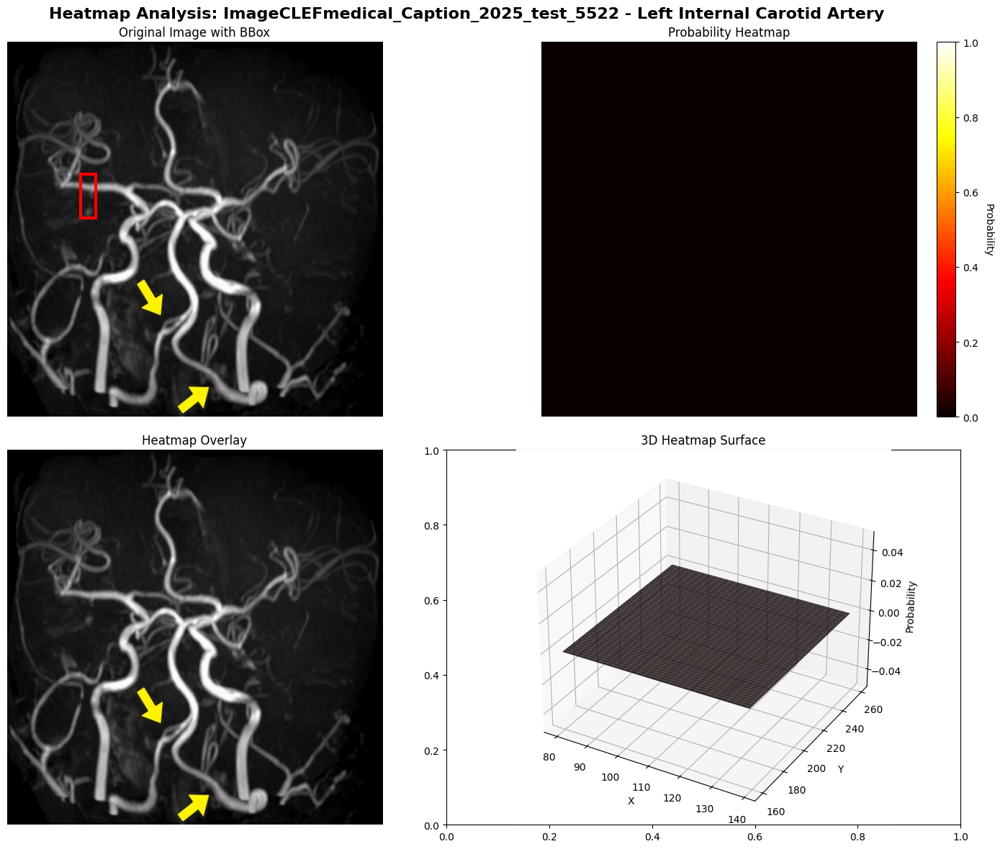

📊 4-panel heatmap displayed and saved: ./result_explain-3/sam/heatmap_4panel_ImageCLEFmedical_Caption_2025_test_5522_Left_Internal_Carotid_Artery.png


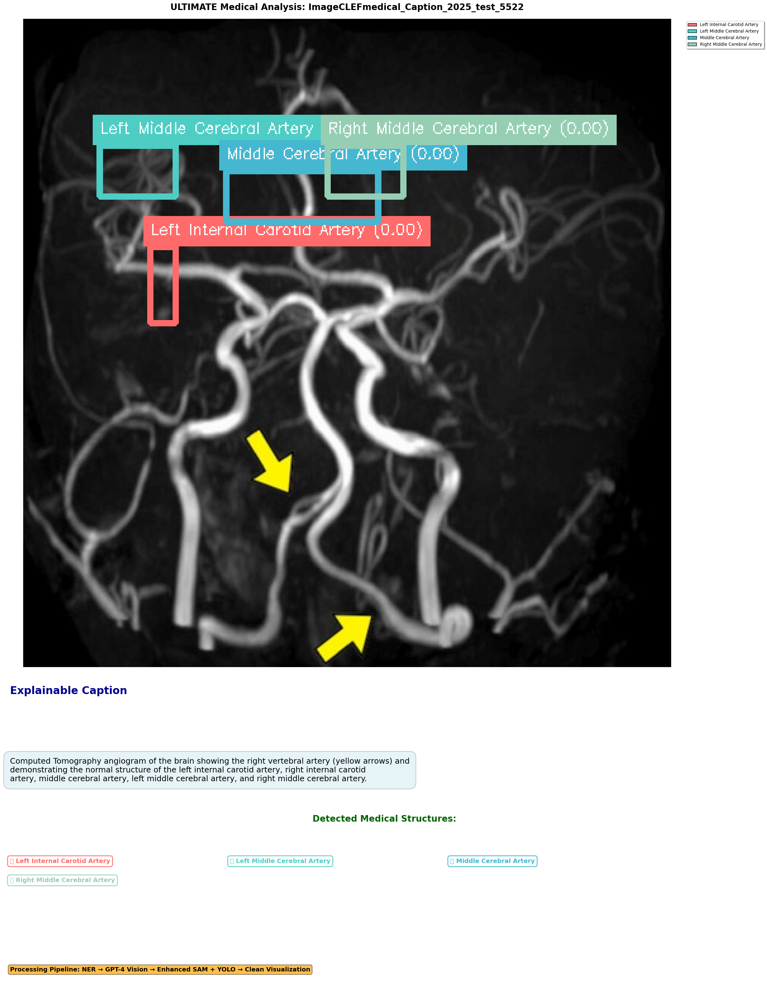


🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍

COMPREHENSIVE DATA TABLE FOR IMAGE: ImageCLEFmedical_Caption_2025_test_5522
      Data Source             Content                                                                                              Details
    📋 A) Concepts    Medical Concepts CUIs: angiogram;Structure of left internal carotid artery;Structure of right internal carotid art...
    📝 B) Captions       Image Caption                                Cerebral angiogram showing the right vertebral artery (yellow arrows)
💬 C) Explanations Medical Explanation Computed Tomography angiogram of the brain showing the right vertebral artery (yellow arrows) and...

 A) Concepts - FULL DETAILS:
   CUIs: angiogram;Structure of left internal carotid artery;Structure of right internal carotid
artery;Structure of middle cerebral artery;Structure of left middle cerebral artery;Structure of
right middle cerebral artery

 C) Explanations - FULL DETAILS

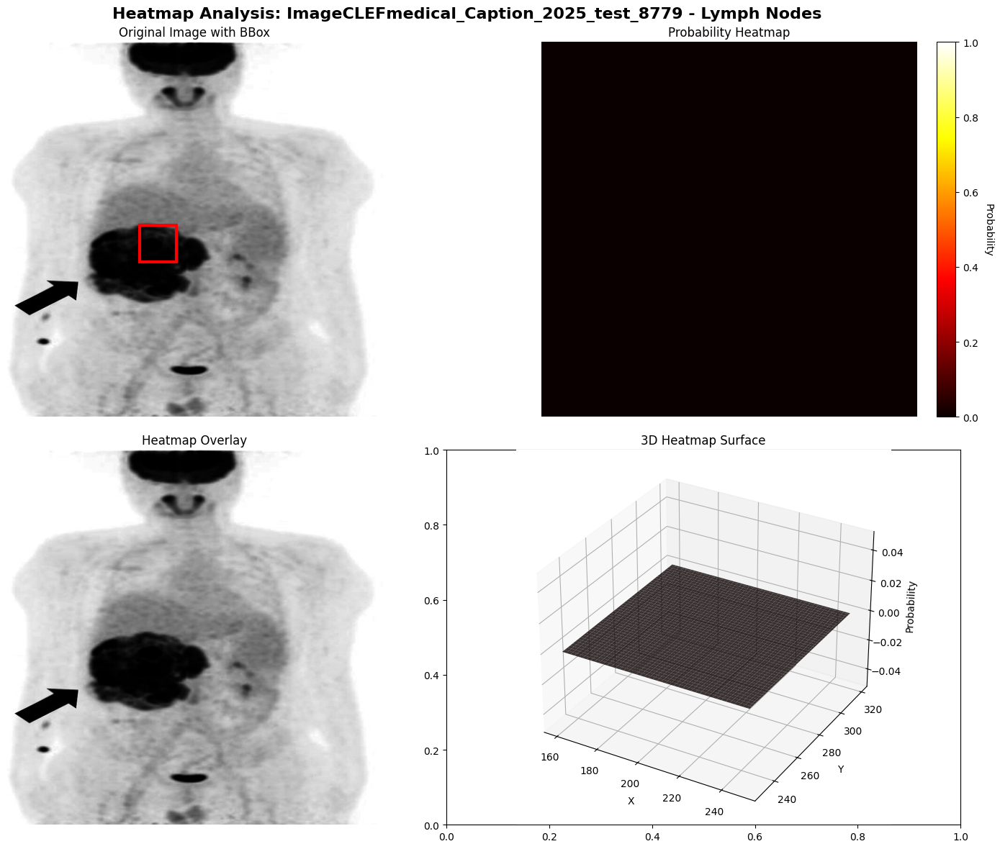

📊 4-panel heatmap displayed and saved: ./result_explain-3/sam/heatmap_4panel_ImageCLEFmedical_Caption_2025_test_8779_Lymph_Nodes.png


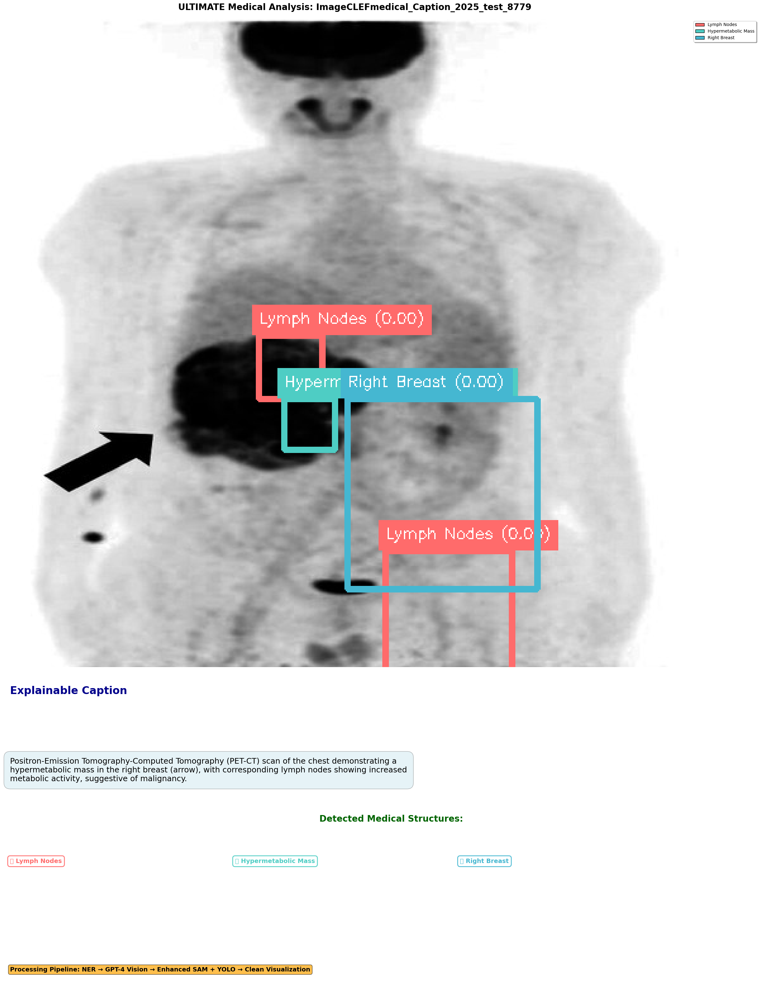


🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍🔍

COMPREHENSIVE DATA TABLE FOR IMAGE: ImageCLEFmedical_Caption_2025_test_8779
      Data Source             Content                                                                                              Details
    📋 A) Concepts    Medical Concepts                                                       CUIs: Positron-Emission Tomography;lymph nodes
    📝 B) Captions       Image Caption Positron emission tomography-computed tomography (PET-CT) scan showing a hypermetabolic mass in t...
💬 C) Explanations Medical Explanation Positron-Emission Tomography-Computed Tomography (PET-CT) scan of the chest demonstrating a hyper...

 B) Captions - FULL DETAILS:
   Positron emission tomography-computed tomography (PET-CT) scan showing a hypermetabolic mass in the
right breast (arrow).

 C) Explanations - FULL DETAILS:
   Positron-Emission Tomography-Computed Tomography (PET-CT) scan of the chest demonstrating a
h

Traceback (most recent call last):
  File "/tmp/ipykernel_250689/2544402899.py", line 9, in <module>
    ultimate_results, ultimate_stats, ultimate_metrics = run_ultimate_analysis()
  File "/tmp/ipykernel_250689/3529613052.py", line 262, in run_ultimate_analysis
    export_data = export_confidence_metrics(all_analysis_stats, OUTPUT_DIR)
  File "/tmp/ipykernel_250689/319413867.py", line 34, in export_confidence_metrics
    'yolo_enhancements': stats['yolo_enhancements'],
KeyError: 'yolo_enhancements'


In [ ]:
# ===== AUTOMATIC EXECUTION OF COMPLETE SYSTEM =====

print("🚀 Running analysis...")
try:
    fixed_results, fixed_stats, fixed_summary = run_ultimate_analysis_fixed()
    print("\n✅ Analysis completed successfully!")
    
    if fixed_stats:
        print(f"📈 Results available in fixed_results, fixed_stats, fixed_summary")
    else:
        print("⚠ No results generated - check for errors above")
        
except Exception as e:
    print(f"❌ Fixed analysis failed: {e}")
    import traceback
    traceback.print_exc()